<a href="https://colab.research.google.com/github/giardinas-dev/advanced-ai-production/blob/main/Data_Augmentation_GenAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
## possibili install ( No needed )
!pip -q install git+https://github.com/huggingface/transformers # need to install from github
!pip install -q datasets loralib sentencepiece
!pip -q install accelerate xformers einops
!pip -q install langchain
!pip install -q diffusers datasets sentencepiece

!pip uninstall torch torchvision -y
!pip install --force-reinstall torch==2.7.1+cu126 torchvision==0.22.1+cu126 --index-url https://download.pytorch.org/whl/cu126


In [ ]:
# Versioni
import torch
import transformers
import diffusers
import huggingface_hub
import peft


print("torch version:", torch.__version__)
print("transformers version:", transformers.__version__)
print("diffusers version:", diffusers.__version__)
print("huggingface_hub version:", huggingface_hub.__version__)
print("peft version:", peft.__version__)
!nvcc --version
!pip show flash-attn


torch version: 2.6.0+cu124
transformers version: 4.41.0
diffusers version: 0.29.2
huggingface_hub version: 0.28.1
peft version: 0.13.0
nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
Name: flash_attn
Version: 2.7.4.post1
Summary: Flash Attention: Fast and Memory-Efficient Exact Attention
Home-page: https://github.com/Dao-AILab/flash-attention
Author: Tri Dao
Author-email: tri@tridao.me
License: 
Location: /usr/local/lib/python3.11/dist-packages
Requires: einops, torch
Required-by: 


In [ ]:
# Needed!!
!pip install torch==2.7.1+cu126 torchvision==0.15.2+cu126 torchaudio==2.0.2+cu126 --extra-index-url https://download.pytorch.org/whl/cu126
!pip install transformers==4.41.0
!pip install diffusers==0.29.2
!pip install huggingface_hub==0.28.1
!pip install peft==0.13.0


Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu126
ERROR: Ignored the following yanked versions: 0.1.6, 0.1.7, 0.1.8, 0.1.9, 0.2.0, 0.2.1, 0.2.2, 0.2.2.post2, 0.2.2.post3, 0.15.0
ERROR: Could not find a version that satisfies the requirement torchvision==0.15.2+cu126 (from versions: 0.1.6, 0.2.0, 0.15.1, 0.15.2, 0.16.0, 0.16.1, 0.16.2, 0.17.0, 0.17.1, 0.17.2, 0.18.0, 0.18.1, 0.19.0, 0.19.1, 0.20.0, 0.20.1, 0.21.0, 0.21.0+cu126, 0.22.0, 0.22.0+cu126, 0.22.1, 0.22.1+cu126, 0.23.0, 0.23.0+cu126)
ERROR: No matching distribution found for torchvision==0.15.2+cu126
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.8/43.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 60.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 108.6 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.21.4
    Uninstalling tokenizers-0.21.4:
      Successfully uninstalled tokenizers-0.

In [ ]:
# Needed!!
# Disinstalla completamente tutte le versioni di flash_attn (se presenti)
!pip uninstall -y flash_attn || true
!pip cache purge || true
!rm -rf ~/.cache/pip
!rm -rf /tmp/pip*

# Reinstalla la versione specifica SENZA usare la cache
!pip install --no-build-isolation --no-cache-dir flash_attn==2.7.4.post1 #2.8.0post2 #2.7.4.post1
 # # #

In [ ]:
# Needed!!
!pip uninstall -y bitsandbytes
!pip install bitsandbytes --prefer-binary --no-cache-dir
!pip install torchmetrics
!pip install rouge-score
!pip install torch-fidelity

#** Riavvio del runtime alla fine delle installazioni

In [ ]:
import os
import json
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image
from sklearn.metrics import confusion_matrix, f1_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.metrics import classification_report
from sklearn.metrics import pairwise_distances


from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from torchvision.models.feature_extraction import create_feature_extractor
from torchvision.models.inception import inception_v3
from rouge_score import rouge_scorer



import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary
from torch.utils.data import Subset, Dataset

import torchvision
import torchvision.transforms as T
from torchvision import models
from torchvision.transforms.functional import to_pil_image

from datasets import load_dataset, Dataset

from transformers import (
    BlipProcessor,
    BlipForConditionalGeneration,
    Blip2Processor,
    Blip2ForConditionalGeneration,
    AutoTokenizer,
    AutoModelForCausalLM,
    AutoModelForSeq2SeqLM,
    AutoProcessor,
    GPT2Tokenizer, GPT2LMHeadModel
)

from diffusers import StableDiffusionPipeline

from timm import create_model

# Random seed for reproducibility
seed = 22
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.set_default_device('cuda')


**OBIETTIVO**

Il progetto mira a sviluppare e testare tecniche avanzate di data augmentation per migliorare il riconoscimento delle immagini in ambiti di sicurezza, come le infrastrutture critiche. Per ragioni accademiche o per un possibile refuso, nelle specifiche è indicato l’uso di un dataset di immagini di animali domestici (OxfordIIITPet). Tuttavia, l’obiettivo finale è creare metodi generali di aumento dati, basati su testo e immagini, applicabili a contesti diversi.*


La strategia adottata prevede un workflow integrato articolato in più fasi: inizialmente, mediante modelli di riconoscimento visivo, vengono generate descrizioni testuali (image captioning) delle immagini originali. Successivamente, un modello di riformulazione del testo viene impiegato per produrre varianti semantiche delle didascalie, incrementando la diversità del dataset. Infine, un modello generativo basato su tecniche di diffusion sintetizza nuove immagini a partire dalle descrizioni modificate, ampliando così il dataset con dati artificiali coerenti e rappresentativi.

I modelli principali impiegati includono Florence per l’estrazione di didascalie dalle immagini, T5-small, T5-Flan e Distilbart per la riformulazione e variazione del testo, e le pipeline di Stable Diffusion (versioni 2-base e v1-5) per la generazione sintetica delle immagini. Questo approccio modulare e multi-stage consente di esplorare in modo efficace come la data augmentation può migliorare le performance di modelli di riconoscimento di immagini in ambienti con dati scarsi o limitati.

**Dal momento che si faceva riferimento al dataset OxfordIIITPet, abbiamo gestito la pipeline relativa a un dataset di immagini ritraenti animali; tuttavia, questo non cambia la validità della struttura creata.*


**CLASSE *TRAINER***

La classe Trainer è pensata per gestire in modo completo e modulare l’addestramento e la validazione di modelli PyTorch. Supporta il training su batch, l’uso di diversi ottimizzatori, early stopping, e il monitoraggio di metriche come loss e accuratezza. Include funzioni per salvare i modelli, visualizzare grafici di performance e analizzare errori tramite matrici di confusione, rendendola uno strumento flessibile per sperimentazioni sul task di classificazione.

**CLASSE *COMPARATOR***

La classe ModelComparer permette di gestire e confrontare facilmente più modelli di machine learning tenendo traccia delle loro configurazioni (nome modello, ottimizzatore, numero di epoche, data augmentation) e dei relativi risultati di training e validazione. Attraverso metodi dedicati, consente di registrare le metriche di performance come loss e accuracy, associandole a ciascun modello, e offre funzioni di visualizzazione per comparare graficamente l'andamento delle loss e dell’accuratezza nel corso delle epoche, evidenziando anche l’epoca con le migliori performance (early stopping).

In [ ]:
# @title Class Comparator

# La classe ExperimentLogger serve a registrare, salvare e consultare le informazioni
# relative agli esperimenti effettuati durante il training dei modelli.
# È utile per confrontare i risultati (es. loss, accuracy, parametri) tra diversi run
# e per tenere traccia delle configurazioni testate.

class ExperimentLogger:
    def __init__(self):
        self.experiments = []

    def log(self, experiment_info):
        self.experiments.append(experiment_info)

    def get_all(self):
        return self.experiments

    def last(self):
        return self.experiments[-1] if self.experiments else None

class ModelComparator:

    def __init__(self, name):
        self.models_logs = {}  # chiave = f"{model}_{optimizer}_{epochs}"
        self.name = name

    def add_model(self, model_name, image_caption_image, optimizer_name, epochs):
        parts = image_caption_image.split('_')
        itc_name = parts[0]              # "Florence"
        cap_name = parts[1]
        cti_name = parts[2]
        key = f"{image_caption_image}_{model_name}_{optimizer_name}_{epochs}ep"
        self.models_logs[key] = {
            "model_name": model_name,
            "optimizer_name": optimizer_name,
            "epochs": epochs,
            "train_losses": None,
            "val_losses": None,
            "val_accuracies": None,
            "best_epoch": None,
            "epochs_run": None,
            "f1_scores": None,
            "itc_name": itc_name,
            "cap_name": cap_name,
            "cti_name": cti_name,
            "key_name":key
        }
        return key

    def results_model(self, key, f1_sc, train_losses, val_losses, val_accuracies, epochs_run, best_epoch):
       old_dict = self.models_logs[key]
       self.models_logs[key] ={
           "model_name": old_dict["model_name"],
           "optimizer_name": old_dict["optimizer_name"],
           "epochs": old_dict["epochs"],
           "train_losses": train_losses,
           "val_losses": val_losses,
           "val_accuracies": val_accuracies,
           "best_epoch": best_epoch,
           "epochs_run": epochs_run,
           "f1_scores": f1_sc,
           "itc_name": old_dict["itc_name"],
           "cap_name": old_dict["cap_name"],
           "cti_name": old_dict["cti_name"],
           "key_name":key
       }



    def parse_model_key(self,key):
        # Es: "Florence_t5-small_stable-diffusion-2-base_detail0.5_temp0.4"
        parts = key.split('_')
        if len(parts) < 3:
            return None, None, None
        itc_name = parts[0]
        cap_name = parts[1]
        cti_name = parts[2]
        return itc_name, cap_name, cti_name


    def plot_metrics(self, metric_name, group_by_fields, top_n=None):
        """
        metric_name: string, esempio 'train_losses', 'val_losses', 'val_accuracies', 'f1_scores'
        group_by_fields: lista di stringhe dei campi su cui raggruppare, es ['optimizer_name', 'epochs'] o ['model_name', 'itc_name']
        top_n: int o None, se specificato mostra solo i migliori top_n curve in ogni gruppo

        """

    def plot_metrics(self, metric_name, group_by_fields, top_n=None):
          groups = {}
          not_augmented_logs = {}  # (model_name, optimizer_name, epochs) -> [logs]

          # Prepara i not_augmented_dataset in una mappa
          for log in self.models_logs.values():
              if log.get("key_name", "").startswith("not_augmented_dataset"):
                  key = (log.get("model_name"), log.get("optimizer_name"), log.get("epochs"))
                  not_augmented_logs.setdefault(key, []).append(log)

          # Raggruppa i log normali
          for log in self.models_logs.values():
              if log.get("key_name", "").startswith("not_augmented_dataset"):
                  continue  # Ignora per ora, li aggiungiamo dopo
              keys = []
              for field in group_by_fields:
                  if field in log:
                      keys.append(str(log[field]))
                  else:
                      keys.append("unknown")
              group_key = "_".join(keys)
              groups.setdefault(group_key, []).append(log)

          # Ora per ogni gruppo, aggiungi i not_augmented_dataset corrispondenti
          for group_key, logs in groups.items():
              # Recupera campi per il gruppo
              group_values = group_key.split("_")
              group_field_values = dict(zip(group_by_fields, group_values))

              # Trova modello, optimizer, epochs del gruppo se presenti
              model_name = group_field_values.get("model_name", None)
              optimizer_name = group_field_values.get("optimizer_name", None)
              epochs = group_field_values.get("epochs", None)

              # Flag per capire se nel gruppo ci sono già not_augmented_dataset
              has_not_aug = any(log.get("key_name", "").startswith("not_augmented_dataset") for log in logs)

              # Se non ci sono e modello/optimizer/epoch sono definiti, aggiungi quelli corrispondenti
              if not has_not_aug:
                  if model_name and optimizer_name and epochs:
                      key = (model_name, optimizer_name, int(epochs) if isinstance(epochs, str) and epochs.isdigit() else epochs)
                      logs.extend(not_augmented_logs.get(key, []))
                  else:
                      # Raggruppamento non include model/optimizer/epoch -> aggiungi tutti i not_augmented_dataset
                      for logs_list in not_augmented_logs.values():
                          logs.extend(logs_list)

              # filtro top_n e plot come prima
              if top_n is not None:
                  filtered_logs = [log for log in logs if log.get(metric_name) and len(log.get(metric_name)) > 0]
                  filtered_logs.sort(key=lambda log: log[metric_name][-1], reverse=True)
                  logs = filtered_logs[:top_n]



              plt.figure(figsize=(12, 6))
              colors = plt.cm.get_cmap('tab10')
                  # Qui gestiamo la visualizzazione del titolo senza "special_log"
              group_values = group_key.split("_")
              # Sostituisci "special_log" con una stringa vuota o un testo più carino
              group_values_display = ["" if v == "special_log" else v for v in group_values]

              title_group = "-".join([f"{v}" for v in  group_values_display if v != ""])
              if not title_group:
                  title_group_grouped = ""
              else :
                  title_group_grouped = f"- Grouped by {title_group}"



              plt.title(f"{metric_name.replace('_', ' ').title()} {title_group_grouped} ")
              plt.xlabel("Epoch")
              ylabel = metric_name.replace("_", " ").title()
              plt.ylabel(ylabel)

              for i, log in enumerate(logs):
                  data = log.get(metric_name)
                  if data is None:
                      continue
                  color = colors(i % 10)
                  label = f"{log['key_name']})"
                  plt.plot(range(1, len(data) + 1), data, label=label, color=color)

              plt.legend()
              plt.grid(True)
              plt.tight_layout()
              plt.show()





class EarlyStopping:
    def __init__(self, patience=5, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.min_val_loss = None
        self.counter = 0
        self.early_stop = False
        self.best_epoch = None
        self.trainer = None



    def reset(self):
        self.min_val_loss = None
        self.counter = 0
        self.early_stop = False
        self.best_epoch = None
        self.early_stop = False


    def __call__(self, validation_loss, model, epoch = None):
        if self.min_val_loss is None:
            self.min_val_loss = validation_loss
            self.save_checkpoint()
            self.best_epoch = epoch

        elif (self.min_val_loss - validation_loss) > self.min_delta:
            self.min_val_loss = validation_loss
            self.save_checkpoint()
            self.counter = 0
            self.best_epoch = epoch


        else:  # Nessun miglioramento
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
                print(f"Modello salvato in {self.trainer.get_path()}")


    def save_checkpoint(self):
      self.trainer.save_model_and_log()

## Il codice delle funzioni relative all'implementazione dei GRAFICI è stato realizzato in parte con l'aiuto di chat-GPT.

In [ ]:
# @title Class Trainer


import torch
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
from tqdm import tqdm


class Trainer:
    def __init__(self, model, name, criterion, device, train_loader, val_loader, classes=None, early_stopping=None, logger = None):
        self.model = model.to(device)
        self.name = name
        self.criterion = criterion
        self.device = device
        self.classes = classes
        self.train_loader = train_loader
        self.test_loader = val_loader

        self.optimizer = None
        self.optimizer_name = None


        self.logger = logger
        self.last_training_info = None



    def set_early_stopping(self, early_stopping):
        self.early_stopping = early_stopping
        self.early_stopping.trainer = self

    def set_optimizer(self, optimizer, name):
        self.optimizer = optimizer
        self.optimizer_name = name
    def train_epoch(self,optimizer = None):
        print("train")
        if optimizer is None:
          optimizer = self.optimizer
        self.model.train()
        running_loss = 0.0
        processed_data = 0
        for data in tqdm(self.train_loader,desc='Train_epoch in progress'):
            inputs, labels = data[0].to(self.device), data[1].to(self.device)
            optimizer.zero_grad()
            outputs = self.model(inputs)
            loss = self.criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()*inputs.size(0)
            processed_data += len(inputs)

        return running_loss / processed_data

    def test_epoch(self, test_loader=None):
        print("test")
        if test_loader is None:
            test_loader = self.test_loader
        self.model.eval()
        running_loss = 0.0
        correct = 0
        total = 0
        all_preds = []
        all_labels = []

        with torch.no_grad():
            for data in tqdm(test_loader,desc='Test_epoch in progress'):
                inputs, labels = data[0].to(self.device), data[1].to(self.device)
                outputs = self.model(inputs)
                loss = self.criterion(outputs, labels)

                running_loss += loss.item()*inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                labels_int = labels.int()


                all_preds.extend(predicted.cpu().numpy())
                all_labels.extend(labels_int.cpu().numpy())

                correct += (predicted == labels).sum().item()
                total += labels.size(0)

        f1 = f1_score(all_labels, all_preds, average='macro')

        return running_loss / total, correct / total, f1, all_preds, all_labels

    def final_validation(self,test_loader=None):
        _, accuracy, f1, all_preds, all_labels = self.test_epoch(test_loader)
        self.last_training_info['final_accuracy'] = accuracy
        self.last_training_info['final_f1'] = f1

        print(classification_report(all_labels, all_preds, digits=4))
        return accuracy, f1

    def train(self, test_loader=None, epochs=100, experiment_name=None, optimizer=None):

        if self.early_stopping is not None:
            self.early_stopping.reset()
        if optimizer is None:
            optimizer = self.optimizer
        if self.optimizer is None and optimizer is None:
            raise ValueError("Optimizer not set. Use set_optimizer() before training.")

        if test_loader is None:
            test_loader = self.test_loader
        print("traintain")
        train_losses = []
        val_losses = []
        val_accuracies = []
        val_f1 = []
        best_epoch = None

        for epoch in tqdm(range(epochs), desc="Training Progress"):

            train_loss = self.train_epoch(optimizer)
            val_loss, val_accuracy, f1, _, _ = self.test_epoch(test_loader)
            train_losses.append(train_loss)
            val_losses.append(val_loss)
            val_accuracies.append(val_accuracy)
            val_f1.append(f1)

            tqdm.write(f'Epoch {epoch+1}/{epochs}, F1 score:{f1:.4f}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.4f}')

            if self.early_stopping is not None:
                self.early_stopping(val_loss, self.model, epoch)
                if self.early_stopping.early_stop:
                    best_epoch =  self.early_stopping.best_epoch
                    print("Early stopping")
                    break

        epochs_run = epoch + 1
        if experiment_name is None:
            experiment_name = f"experiment_{len(self.logger.get_all())+ 1}"



        exp_record = {
            "experiment_name": experiment_name,
            "optimizer": self.optimizer_name,
            "criterion": type(self.criterion).__name__,
            "train_losses": train_losses,
            "val_losses": val_losses,
            "val_accuracies": val_accuracies,
            "val_f1": val_f1,
            "epochs_run": epochs_run,
            "best_epoch_early_stopping": best_epoch
        }
        self.logger.log(exp_record)

        self.last_training_info = exp_record
        if not self.early_stopping.early_stop:
            self.save_model_and_log()
            print(f"Model salvato in {self.name}/model.pt")
        self.early_stopping.reset()
        self.save_model_and_log(log_filename = f"log_{experiment_name}.json", log_data = exp_record)

        return  val_f1,train_losses, val_losses, val_accuracies, epochs_run, best_epoch


    def plot_accuracies(self):
        plt.figure(figsize=(10, 6))
        colors = plt.cm.get_cmap('tab10')
        for i,exp in enumerate(self.logger.get_all()):
            color = colors(i % 10)
            epochs = range(1, exp["epochs_run"] + 1)
            plt.plot(epochs, exp["val_accuracies"], label=f'Val Accuracy ({exp["optimizer"]}-Epoche:{exp["epochs_run"]})',color=color)

            # Linea verticale miglior val accuracy (best_epoch)
            if exp.get("best_epoch_early_stopping") is not None:
                plt.axvline(exp["best_epoch_early_stopping"] + 1, color=color, linestyle='--', alpha=0.7,
                            label=f'Best Val Accuracy Epoch - ({exp["optimizer"]}-Epoche:{exp["best_epoch_early_stopping"]})')



        plt.xlabel("Epochs")
        plt.ylabel("Validation Accuracy")
        plt.title(f"{self.name} - Validation Accuracy")
        plt.legend()
        plt.show()

    def plot_losses(self):
        plt.figure(figsize=(10, 6))
        colors = plt.cm.get_cmap('tab10')

        for i, exp in enumerate(self.logger.get_all()):
            color = colors(i % 10)
            epochs = range(1, exp["epochs_run"] + 1)
            plt.plot(epochs, exp["train_losses"], linestyle="--", label=f'Train Loss ({exp["optimizer"]})', color=color)
            plt.plot(epochs, exp["val_losses"], label=f'Val Loss ({exp["optimizer"]})', color=color)

            if exp.get("best_epoch_early_stopping") is not None:
                plt.axvline(exp["best_epoch_early_stopping"] + 1, color=color, linestyle=':', alpha=0.7,
                            label=f'Best Val Loss Epoch ({exp["optimizer"]})')

        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.title(f"{self.name} - Train & Validation Loss")
        plt.legend()
        plt.grid(True, linestyle="--", alpha=0.4)
        plt.tight_layout()
        plt.show()


    def plot_f1_scores(self):
        plt.figure(figsize=(10, 6))
        colors = plt.cm.get_cmap('tab10')
        for i, exp in enumerate(self.logger.get_all()):
            if "val_f1" not in exp:
                continue
            f1_scores = exp["val_f1"]
            epochs = range(1, len(f1_scores) + 1)
            color = colors(i % 10)
            plt.plot(epochs, f1_scores, label=f'Val F1-score ({exp["optimizer"]}-Epochs:{exp["epochs_run"]})', color=color)

            # Linea verticale miglior epoca (early stopping)
            if exp.get("best_epoch_early_stopping") is not None:
                plt.axvline(exp["best_epoch_early_stopping"] + 1, color=color, linestyle='--', alpha=0.7,
                            label=f'Best Val F1 Epoch ({exp["optimizer"]}-Epochs:{exp["best_epoch_early_stopping"]})')

        plt.xlabel("Epochs")
        plt.ylabel("Validation F1-score")
        plt.title(f"{self.name} - Validation F1-score")
        plt.legend()
        plt.grid(True)
        plt.show()



    def get_last_training_info(self):
          print("="*50)
          print(f"Experiment Summary: {self.last_training_info.get('experiment_name', 'N/A')}")
          print("-"*50)
          print(f"Optimizer:           {self.last_training_info.get('optimizer', 'N/A')}")
          print(f"Criterion:           {self.last_training_info.get('criterion', 'N/A')}")
          print(f"Epochs Run:          {self.last_training_info.get('epochs_run', 'N/A')}")
          print(f"best_epoch_early_stopping: {self.last_training_info.get('best_epoch_early_stopping', 'N/A')}")
          print("-"*50)
          print(f"Final Training Loss: {self.last_training_info['train_losses'][-1]:.4f}")
          print(f"Final Validation Loss: {self.last_training_info['val_losses'][-1]:.4f}")
          print(f"Final F1 score: {self.last_training_info['final_f1']:.4f}")
          print(f"Final Validation Accuracy: {self.last_training_info['final_accuracy']:.4f}")
          print("="*50)
          return self.last_training_info




    def plot_confusion_matrix(self, test_loader=None, model_name='', opt_name='', epochs=0):
        if test_loader is None:
            test_loader = self.test_loader
        self.model.eval()
        y_true = []
        y_pred = []

        with torch.no_grad():
            for i, data in enumerate(test_loader, 0):
                inputs, labels = data[0].to(self.device), data[1].to(self.device)
                outputs = self.model(inputs)
                _, predicted = torch.max(outputs, 1)
                y_true.extend(labels.cpu().numpy())
                y_pred.extend(predicted.cpu().numpy())

        cm = confusion_matrix(y_true, y_pred)
        num_classes = len(self.classes)

        plt.figure(figsize=(10,7))
        # Usa numeri come etichette
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                    xticklabels=np.arange(num_classes),
                    yticklabels=np.arange(num_classes))
        plt.xlabel('Predicted')
        plt.ylabel('True')
        title = f"{model_name} with {opt_name} optimizer for {epochs} epochs"
        plt.title(f"Confusion Matrix:\n{title}", color='blue')
        plt.show()

        # Stampa la legenda separata per riferimento
        print("\nClass index to label mapping:")
        for idx, label in enumerate(self.classes):
            print(f"{idx}: {label}")


    def save_model_and_log(self, model_filename="model.pt", log_filename=None, log_data=None):
            folder = os.path.join("models", self.name)
            os.makedirs(folder, exist_ok=True)

            model_path = os.path.join(folder, model_filename)




            if log_filename is not None and log_data is not None:
                log_path = os.path.join(folder, log_filename)
                with open(log_path, 'w') as f:
                    json.dump(log_data, f, indent=4)
                print(f"Log salvato in: {log_path}")
            else:
              torch.save(self.model.state_dict(), model_path)



    def load_model(self, model_filename="model.pt"):
            model_path = os.path.join("models", self.name, model_filename)
            if os.path.isfile(model_path):
                self.model.load_state_dict(torch.load(model_path, map_location=self.device))
                self.model.to(self.device)
                print(f"Modello caricato da: {model_path}")
            else:
                print(f"File non trovato: {model_path}")

    def get_path(self):
            return "models/"+self.name

    def show_errors(self, test_loader=None, max_errors=10):
            if test_loader is None:
                test_loader = self.test_loader
            self.model.eval()

            all_wrong_images = []
            all_true_labels = []
            all_pred_labels = []

            with torch.no_grad():
                for inputs, labels in test_loader:
                    inputs = inputs.to(self.device)
                    labels = labels.to(self.device)
                    outputs = self.model(inputs)
                    _, preds = torch.max(outputs, 1)

                    wrong_idxs = (preds != labels).nonzero(as_tuple=False).squeeze()
                    if wrong_idxs.dim() == 0 and wrong_idxs.numel() > 0:
                        wrong_idxs = wrong_idxs.unsqueeze(0)

                    for idx in wrong_idxs:
                        all_wrong_images.append(inputs[idx].cpu())
                        all_true_labels.append(labels[idx].item())
                        all_pred_labels.append(preds[idx].item())

            if len(all_wrong_images) > max_errors:
                selected_idxs = random.sample(range(len(all_wrong_images)), max_errors)
            else:
                selected_idxs = range(len(all_wrong_images))

            plt.figure(figsize=(15, 8))
            for i, idx in enumerate(selected_idxs):
                plt.subplot(2, 5, i + 1)
                plt.imshow(tensor_to_image(all_wrong_images[idx]))
                true_label = self.classes[all_true_labels[idx]] if self.classes else all_true_labels[idx]
                pred_label = self.classes[all_pred_labels[idx]] if self.classes else all_pred_labels[idx]
                plt.title(f"True: {true_label}\nPred: {pred_label}")
                plt.axis('off')

            plt.show()

## Il codice delle funzioni relative all'implementazione dei grafici/ errori è stato realizzato in parte con l'aiuto di chat-GPT.

In [ ]:
# @title Utilities
from sklearn.model_selection import train_test_split

def split_dataset(dataset, val_size=0.15, test_size=0.15, random_seed=42):
    n_samples = len(dataset)
    indices = list(range(n_samples))

    # estrai le label manualmente
    labels = [dataset[i][1] for i in indices]

    train_idx, temp_idx = train_test_split(
        indices,
        test_size=val_size + test_size,
        random_state=random_seed,
        stratify=labels
    )

    temp_labels = [labels[i] for i in temp_idx]
    test_relative_size = test_size / (val_size + test_size)

    val_idx, test_idx = train_test_split(
        temp_idx,
        test_size=test_relative_size,
        random_state=random_seed,
        stratify=temp_labels
    )

    train_data = [dataset[i] for i in train_idx]
    val_data = [dataset[i] for i in val_idx]
    test_data = [dataset[i] for i in test_idx]

    return train_data, val_data, test_data


def collate_with_transform(transform, device = None):
    def collate_fn(batch):
        images, labels = zip(*batch)
        images = [transform(img) for img in images]
        return torch.stack(images), torch.tensor(labels)
    return collate_fn

def convert_labels(data, class_names, to='name'):
    """
    Converte le label tra indice numerico e nome classe.
    """
    if to == 'name':
        return [(img, class_names[label]) for img, label in data]
    elif to == 'index':
        name_to_index = {name: i for i, name in enumerate(class_names)}
        return [(img, name_to_index[label]) for img, label in data]
    else:
        raise ValueError("Argomento 'to' deve essere 'name' o 'index'")

# @title
def stratified_subset(dataset, ratio, seed=37):

    targets = dataset._labels
    sss = StratifiedShuffleSplit(n_splits=1, test_size=ratio, random_state=seed)
    indices = list(range(len(dataset)))
    for reduced_idx, _ in sss.split(indices, targets):
        break
    return Subset(dataset, reduced_idx)

def stratified_subset_simple(dataset, ratio, seed=37):
    targets = dataset._labels
    indices = list(range(len(dataset)))

    sss = StratifiedShuffleSplit(n_splits=1, test_size=ratio, random_state=seed)
    reduced_idx, remaining_idx = next(sss.split(indices, targets))

    # Costruisci lista di tuple (PIL.Image, label) per il subset ridotto
    reduced_data = []
    for i in reduced_idx:
        img = Image.open(dataset._images[i]).convert("RGB")
        label = targets[i]
        reduced_data.append((img, label))

    # Costruisci lista di tuple (PIL.Image, label) per il dataset rimanente
    remaining_data = []
    for i in remaining_idx:
        img = Image.open(dataset._images[i]).convert("RGB")
        label = targets[i]
        remaining_data.append((img, label))

    return reduced_data, remaining_data


# stratified for hugging face dataset

def stratified_subset_hf(dataset, ratio, seed=37):
    targets = dataset["label"]
    indices = list(range(len(dataset)))

    sss = StratifiedShuffleSplit(n_splits=1, test_size=ratio, random_state=seed)

    for train_idx, subset_idx in sss.split(indices, targets):
        break
    subset = dataset.select(subset_idx)

    return subset

from tqdm import tqdm

## Il codice delle funzioni relative all'implementazione della stratificazione è stato realizzato in parte con l'aiuto di chat-GPT.

**DATASET**

Il dataset originale OxfordIIITPet contiene circa 3600 immagini, un numero significativo per l’addestramento di modelli di riconoscimento. Tuttavia, poiché l’obiettivo principale del progetto è valutare l’impatto della generazione di nuove immagini artificiali tramite tecniche di data augmentation avanzata, si è deciso di limitare la dimensione del dataset di partenza. L’intento è infatti produrre almeno un incremento del 30% in termini di immagini sintetiche, ma generare oltre 1200 nuove immagini risulterebbe troppo oneroso dal punto di vista computazionale, considerando le risorse disponibili. Per questo motivo, si è scelto di ridurre il dataset originale a circa 600 immagini, pari al 18% del totale, mantenendo comunque una distribuzione rappresentativa delle classi. Successivamente, questo sottoinsieme è stato suddiviso in training, validazione e test set, con l’obiettivo di produrre circa 150 immagini sintetiche aggiuntive da utilizzare come data augmentation. Questa strategia consente di studiare in modo efficiente come l’ampliamento del dataset con immagini generate influisca sulle prestazioni del modello, senza superare i limiti computazionali imposti.

In [ ]:



transform_train = T.Compose([
    T.RandomResizedCrop(224),           # ritaglia e ridimensiona a 224x224 in modo casuale
    T.RandomHorizontalFlip(),           # flip orizzontale casuale
    T.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # variazioni colore
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])
transform_val = T.Compose([
    T.Resize(256),
    T.CenterCrop(224),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
SUBSET_SIZE = 0.180978261

data_dir = "./oxfordpets"
oxford_dataset = torchvision.datasets.OxfordIIITPet(root=data_dir, download=True, split='trainval',
                                    target_types='category')



classes = oxford_dataset.classes
name_classes = ['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier',
 'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair',
 'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter',
 'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin',
 'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland',
 'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian Blue', 'Saint Bernard', 'Samoyed', 'Scottish Terrier',
 'Shiba Inu', 'Siamese', 'Sphynx', 'Staffordshire Bull Terrier', 'Wheaten Terrier', 'Yorkshire Terrier'
]

# riduzione del dataset stratificata
oxford_dataset_reduced, remaining_data = stratified_subset_simple(oxford_dataset, 1 - SUBSET_SIZE)

# split database strificato
train_dataset_reduced ,test_dataset_reduced,val_dataset_reduced = split_dataset(oxford_dataset_reduced, val_size = 0.222, test_size = 0.222)

print(" Numero di classi:",len(name_classes))

print(f"Lunghezza totale del dataset Oxford: {len(oxford_dataset)}")
print(f"Lunghezza del dataset Oxford ridotto al {SUBSET_SIZE:.2f}%: {len(oxford_dataset_reduced)} -> 18 immagini a classe ")
print(f"Lunghezza del dataset di training ridotto: {len(train_dataset_reduced)} -> 10 immagini a classe")
print(f"Lunghezza del dataset di test ridotto: {len(test_dataset_reduced)} -> 4 immagini a classe ")
print(f"Lunghezza del dataset di val ridotto: {len(val_dataset_reduced)} -> 4 immagini a classe ")
# passaggio da (PIL,int) -> (PIL,label)
if isinstance(train_dataset_reduced[0][1],int):
  oxford_dataset_reduced_train = convert_labels(train_dataset_reduced, name_classes, to='name')


100%|██████████| 792M/792M [00:37<00:00, 21.4MB/s]
100%|██████████| 19.2M/19.2M [00:02<00:00, 8.46MB/s]


 Numero di classi: 37
Lunghezza totale del dataset Oxford: 3680
Lunghezza del dataset Oxford ridotto al 0.18%: 666 -> 18 immagini a classe 
Lunghezza del dataset di training ridotto: 370 -> 10 immagini a classe
Lunghezza del dataset di test ridotto: 148 -> 4 immagini a classe 
Lunghezza del dataset di val ridotto: 148 -> 4 immagini a classe 
(<PIL.Image.Image image mode=RGB size=300x220 at 0x7D7E4044A590>, 10)
(<PIL.Image.Image image mode=RGB size=500x375 at 0x7D7E0C43BD10>, 35)
(<PIL.Image.Image image mode=RGB size=500x334 at 0x7D7E0C475610>, 4)
['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier', 'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair', 'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter', 'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin', 'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland', 'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian Blue', 'Saint Bernard', '

**MODELLO VALIDATORE**

In questo passaggio, si utilizza un modello di riconoscimento immagini pre-addestrato (ResNet50) come validatore per le immagini generate artificialmente tramite la pipeline di data augmentation. Lo scopo principale è verificare che le nuove immagini create siano coerenti con le etichette originali del dataset, evitando così di introdurre dati errati o fuorvianti nel processo di addestramento.

Per farlo, il modello viene addestrato sul dataset originale completo per apprendere a classificare correttamente le immagini esistenti. Successivamente, questo validatore sarà impiegato per controllare la qualità delle immagini sintetiche prodotte, assicurandosi che rappresentino fedelmente le classi di riferimento. In questo modo, si garantisce che l’ampliamento del dataset tramite immagini generate migliori effettivamente le prestazioni del modello finale, senza compromettere la sua accuratezza.

Questo approccio è fondamentale per mantenere l’integrità del processo di data augmentation, permettendo di sfruttare in modo efficace i dati sintetici nel miglioramento del riconoscimento delle immagini

In [ ]:



def getValidator(ox_dataset):
    BATCH_SIZE = 32
    NUM_EPOCHS = 20
    LR = 1e-5
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # Training modello resnet50 per validatore delle immagini create sul dataset COMPLETO
    train_dataset_completed ,val_dataset_completed,test_dataset_completed = split_dataset(ox_dataset, val_size = 0.15, test_size = 0.15)


    gen = torch.Generator('cuda')
    train_loader = torch.utils.data.DataLoader(train_dataset_completed, batch_size=BATCH_SIZE, shuffle=True, generator=gen ,  collate_fn=collate_with_transform(transform_train, DEVICE ))
    val_loader = torch.utils.data.DataLoader(val_dataset_completed, batch_size=BATCH_SIZE, generator=gen,  collate_fn=collate_with_transform(transform_val, DEVICE))
    test_loader = torch.utils.data.DataLoader(test_dataset_completed, batch_size=BATCH_SIZE, generator=gen,  collate_fn=collate_with_transform(transform_val, DEVICE) )

    print(f"Train loader size: {len(train_loader)}")
    print(f"Val loader size: {len(val_loader)}")


    # Modello

    model = models.resnet50(pretrained=True)
    model.fc = nn.Linear(model.fc.in_features, len(name_classes))  # 37 classi
    for name, param in model.named_parameters():
        if "layer4" in name or "fc" in name:
            param.requires_grad = True
        else:
            param.requires_grad = False


    model = model.to(DEVICE)

    # Criterion e optimizer
    criterion = nn.CrossEntropyLoss()
    params_to_update = [p for p in model.parameters() if p.requires_grad]
    optimizer = optim.Adam(params_to_update, lr=LR)


    early_stopping = EarlyStopping(patience=7, min_delta=0)
    logger = ExperimentLogger()

    # classe Trainer tra i codici nascosti su ↑↑↑
    trainer = Trainer(model=model,
                      name="oxford_pets_resnet50",
                      criterion=criterion,
                      device=DEVICE,
                      train_loader=train_loader,
                      val_loader=val_loader,
                      classes=classes,
                      logger=logger)

    trainer.set_early_stopping(early_stopping)
    trainer.set_optimizer(optimizer, name="Adam")

    # Start training
    val_f1, train_losses, val_losses, val_accuracies, epochs_run, best_epoch = trainer.train(epochs=NUM_EPOCHS)
    trainer.final_validation(test_loader)

    # Print info finale
    trainer.get_last_training_info()
    validator = trainer.model
    return validator




**MODELLI**

Modelli coinvolti:

- *Image-to-caption*: modelli che generano descrizioni testuali (didascalie) a partire dalle immagini originali.

- *Caption reformulation* : modelli che riformulano o varianti le didascalie, aumentando la diversità semantica dei testi.

- *Caption-to-image*: modelli generativi (basati su tecniche di diffusion) che sintetizzano nuove immagini partendo dalle didascalie riformulate.

*Gestione delle combinazioni*

Il cuore del sistema è la classe *ModelManager*, che gestisce il caricamento, la memorizzazione in cache e l’organizzazione delle combinazioni possibili tra i modelli dei tre step. Questo permette di esplorare diverse configurazioni (diversi modelli e parametri come dettaglio e temperatura) senza dover caricare ripetutamente lo stesso modello, ottimizzando così l’uso delle risorse computazionali.

*Parametri di configurazione*

Vengono definiti parametri come “detail” e “temperature” per i modelli di riformulazione e generazione, che influenzano la qualità, la varietà e la creatività dei testi e delle immagini generate. Variando questi parametri e le combinazioni di modelli, è possibile esplorare un ampio spettro di soluzioni per capire quali funzionano meglio nel migliorare la data augmentation.


In [ ]:
# modelli

# ******Nota: alcuni modelli sono stati disabilitati/commentati perché risultano troppo
# pesanti dal punto di vista computazionale, generano troppe combinazioni o richiedono
# una quantità significativa di spazio su disco, rendendo l'esecuzione meno pratica
# in ambienti con risorse limitate.

model_image_to_caption = {
   "Florence": lambda: (
        AutoModelForCausalLM.from_pretrained('microsoft/Florence-2-large', trust_remote_code=True),
        AutoProcessor.from_pretrained('microsoft/Florence-2-large', torch_dtype="auto", trust_remote_code=True)
    )

   # "BLIP-base": lambda: (
   #    BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base"),
   #     BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
   # )
}


model_caption_reform = {
    "t5-small": lambda: (
        AutoModelForSeq2SeqLM.from_pretrained("t5-small"),
        AutoTokenizer.from_pretrained("t5-small")
    ),
    "t5-flan-small": lambda: (
        AutoModelForSeq2SeqLM.from_pretrained("google/flan-t5-small"),
        AutoTokenizer.from_pretrained("google/flan-t5-small")
    ),
    "distilbart": lambda: (
        AutoModelForSeq2SeqLM.from_pretrained("sshleifer/distilbart-cnn-12-6"),
        AutoTokenizer.from_pretrained("sshleifer/distilbart-cnn-12-6")
    ),

 #   "zephyr": lambda: (
 #       AutoModelForCausalLM.from_pretrained("HuggingFaceH4/zephyr-7b-beta", load_in_4bit=True, torch_dtype="auto"),
 #       AutoTokenizer.from_pretrained("HuggingFaceH4/zephyr-7b-beta", load_in_4bit=True, torch_dtype="auto")
 #  )
}



model_caption_to_image = {
    "stable-diffusion-2-base": lambda: StableDiffusionPipeline.from_pretrained(
        "stabilityai/stable-diffusion-2-base", torch_dtype=torch.float16
    ).to("cuda"),
    "stable-diffusion-v1-5": lambda: StableDiffusionPipeline.from_pretrained(
        "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16
    ).to("cuda")
}

class ModelManager:
    def __init__(self, image_to_caption, caption_reform, caption_to_image, device=None):
        self.device = device or torch.device("cuda" if torch.cuda.is_available() else "cpu")

        self.image_to_caption_sources = image_to_caption
        self.caption_reform_sources = caption_reform
        self.caption_to_image_sources = caption_to_image

        # Cache effettiva dei modelli già caricati
        self.loaded_image_to_caption = {}    # nome -> (modello, processor)
        self.loaded_caption_reform = {}      # nome -> (modello, tokenizer)
        self.loaded_caption_to_image = {}    # nome -> pipeline

        self.model_combinations = {}

    def load_combinations(self, desired_combinations):
        print("Caricamento delle combinazioni richieste...")

        for cap_name, diffusion_version, detail, temperature in desired_combinations:
            itc_name = list(self.image_to_caption_sources.keys())[0] # Una sola alternativa
            cti_name = next(k for k in self.caption_to_image_sources if diffusion_version in k)
            key_base = f"{itc_name}_{cap_name}_{cti_name}"
            key = f"{key_base}_detail{detail}_temp{temperature}"

            if key in self.model_combinations:
                continue

            # Carica o recupera modello image-to-caption
            if itc_name not in self.loaded_image_to_caption:
                print(f"Caricamento modello image_to_caption: {itc_name}")
                model, processor = self.image_to_caption_sources[itc_name]()
                try:
                    model_eval = model.to(self.device).eval()
                except Exception as e:
                    print(f"Non posso fare .to() su {itc_name}: {e}")
                    model_eval = model.eval()
                self.loaded_image_to_caption[itc_name] = (
                    model_eval, processor
                )

            itc_model, itc_processor = self.loaded_image_to_caption[itc_name]

            # Carica o recupera modello caption-reform
            if cap_name not in self.loaded_caption_reform:
                print(f"  Caricamento modello caption_reform: {cap_name}")
                model, tokenizer = self.caption_reform_sources[cap_name]()
                self.loaded_caption_reform[cap_name] = (
                    model.to(self.device).eval(), tokenizer
                )
                try:
                    model_caption = model.to(self.device).eval()
                except Exception as e:
                    print(f"Non posso fare .to() su {itc_name}: {e}")
                    model_caption = model.eval()
                self.loaded_caption_reform[cap_name] = (
                    model_caption, tokenizer
                )

            crm_model, crm_tokenizer = self.loaded_caption_reform[cap_name]

            # Carica o recupera modello caption-to-image
            if cti_name not in self.loaded_caption_to_image:
                print(f"    Caricamento modello caption_to_image: {cti_name}")
                pipeline = self.caption_to_image_sources[cti_name]()
                self.loaded_caption_to_image[cti_name] = pipeline
            cti_model = self.loaded_caption_to_image[cti_name]

            self.model_combinations[key] = {
                "itc_model": itc_model,
                "itc_processor": itc_processor,
                "crm_model": crm_model,
                "crm_tokenizer": crm_tokenizer,
                "cti_model": cti_model,
                "detail": detail,
                "temperature": temperature
            }
            print(f"    Combinazione creata: {key}")

        print(f"Totale combinazioni attive: {len(self.model_combinations)}")
        return self.model_combinations

manager = ModelManager( image_to_caption=model_image_to_caption,
    caption_reform=model_caption_reform,
    caption_to_image=model_caption_to_image)


Le combinazioni selezionate bilanciano modelli di riformulazione delle didascalie ("t5-small" "t5-flan-small", "distilbart") con modelli di generazione immagini ("2-base" e "v1-5"), variando due parametri chiave: temperatura e dettaglio. La temperatura regola la creatività e la casualità nella generazione del testo e delle immagini, con valori più bassi che favoriscono output più conservativi e valori più alti che promuovono una maggiore varietà e originalità. Il parametro dettaglio si riferisce alla quantità di token prodotti nella fase di riformulazione delle didascalie, influenzando la ricchezza e la complessità delle descrizioni generate. Questa combinazione di variabili permette di esplorare un ampio spettro di qualità e diversità nelle immagini sintetiche, ottimizzando il numero di configurazioni per una valutazione efficace e mirata.

In [ ]:


# Queste combinazioni sono state selezionate per esplorare un buon equilibrio tra
# diversi modelli di riformulazione delle didascalie ("t5-small" e "distilbart") e
# modelli di generazione immagine ("2-base" e "v1-5"), variando i parametri di
# temperatura e dettaglio per testare l'impatto sulla qualità e varietà delle immagini
# generate. In questo modo si coprono configurazioni con temperature più basse
# (più conservative) e più alte (più creative), oltre a dettagli più o meno accentuati,
# garantendo una copertura rappresentativa senza generare un numero eccessivo di combinazioni.

 #(Caption reformulation, Caption-to-image, detail, temperature)
desired_combinations = [
    # t5-small più veloce, token medio-bassi e temperature medio-basse
    ("distilbart", "2-base", 0.5, 0.5),
    ("t5-small", "2-base", 0.3, 0.4),
    ("t5-flan-small", "2-base", 0.4, 0.5),
    ("t5-flan-small", "v1-5", 0.6, 0.4),
    # Evito combinazioni troppo alte in token e temperature
]

load_combinations = manager.load_combinations(desired_combinations)


Caricamento delle combinazioni richieste...
Caricamento modello image_to_caption: Florence


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

configuration_florence2.py: 0.00B [00:00, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- configuration_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_florence2.py: 0.00B [00:00, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- modeling_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


model.safetensors:   0%|          | 0.00/1.55G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

processing_florence2.py: 0.00B [00:00, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Florence-2-large:
- processing_florence2.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


tokenizer_config.json:   0%|          | 0.00/34.0 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

  Caricamento modello caption_reform: distilbart


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

    Caricamento modello caption_to_image: stable-diffusion-2-base


model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/738 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/929 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/716 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

    Combinazione creata: Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5
  Caricamento modello caption_reform: t5-small


config.json:   0%|          | 0.00/1.21k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/242M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/2.32k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

    Combinazione creata: Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4
  Caricamento modello caption_reform: t5-flan-small


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/308M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

(…)a5b18a05535c9e14c7a355904270e15b0945ea86:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json: 0.00B [00:00, ?B/s]

    Combinazione creata: Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5
    Caricamento modello caption_to_image: stable-diffusion-v1-5


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

    Combinazione creata: Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4
Totale combinazioni attive: 4


**FORMULAZIONE CAPTION**

La funzione *extract_caption* trasforma una risposta generata da un modello linguistico in una didascalia pulita e coerente, focalizzata esclusivamente sulle caratteristiche fisiche di un animale.

Inizialmente, rimuove istruzioni, esempi e parti ripetute del prompt, che spesso vengono rigenerate dal modello, adattandosi al tipo di architettura usata (come T5 o DistilBART). Se il prompt è presente nella risposta, viene eliminato direttamente; altrimenti, la funzione applica una serie di filtri testuali per cancellare righe comuni o sottostringhe non rilevanti.

Dopo la pulizia, il testo viene rifinito: si sistemano spazi, punteggiatura e capitalizzazione iniziale. Viene poi utilizzata una regex per identificare frasi ben formate e selezionarne un numero proporzionato alla lunghezza della descrizione originale, controllato da un parametro chiamato detail_caption.

Il risultato è una didascalia leggibile, informativa e centrata sull’aspetto dell’animale, pronta per essere validata o utilizzata direttamente come annotazione.

**VALIDAZIONE CAPTION**

Il modulo relativo si occupa di verificare la qualità e la coerenza delle caption generate, garantendo che siano pertinenti, descrittive e adeguate al contesto (es. razze di animali).

Criteri di validazione:
- Deve contenere almeno 12 parole.

- Deve iniziare con una frase corretta (es. "The image", "This cat", ecc.).

- Deve includere almeno una keyword rilevante (es. nomi di razze come "Persian", "Golden Retriever").

- Non deve terminare con frasi generiche o incomplete (es. "based on", "as if", "shows a", ecc.).

- Verifica la varietà delle frasi, assicurandosi che almeno il 70% delle frasi nella caption siano uniche.

Tentativi e fallback:
- Tiene traccia del numero di tentativi per generare una caption valida.

Dopo un massimo di max_attempts, seleziona la migliore caption tra quelle generate sulla base di un punteggio (priorità a quelle che contengono nomi di razze).

In [ ]:
# @title Caption utility


import re
import string
import random
from collections import defaultdict, deque


def remove_substrings_from_response(response, full_text):
    # Rimuove i due punti finali
    full_text = full_text.rstrip(":")

    # Tokenizza in parole
    tokens = full_text.split()

    # Genera tutte le sottostringhe da più di una parola, ordinate dalla più lunga alla più corta
    substrings = []
    for length in range(len(tokens), 1, -1):  # da lunghezze più grandi a 2
        for i in range(len(tokens) - length + 1):
            chunk = " ".join(tokens[i:i + length])
            substrings.append(chunk)

    # Rimuove ogni sottostringa se presente nella risposta
    for sub in substrings:
        if sub in response:
            response = response.replace(sub, '')

    # Pulizia finale
    response = re.sub(r'\s+', ' ', response).strip()
    return response



def extract_caption(response: str, prompt: str, input_caption: str, model_name, detail = 0.4):

    # Rimuovi il prompt se presente (utile soprattutto per microsoft con tag <|user|>, <|assistant|>)
    print(f"MODEL TEXT -> TEXT: {model_name}\n")
    if prompt and prompt in response:
        response = response.split(prompt, 1)[-1].strip()
    else:
        # Se il prompt non è nella response, rimuovo manualmente linee comuni per modello microsoft e t5
        base_lines = [
            "You are an expert in describing physical characteristics of animals for breed identification.",
            "Base description ->",
            "Please rewrite the description by focusing only on the animal's physical traits, such as..",
            "- Fur color and pattern",
            "- Size and body build",
            "- Fur texture and length",
            "- Eye color and shape",
            "- Shape of ears, muzzle, and tail",
            "- Any unique or distinguishing features",
            "Avoid describing background, actions, or objects.",
            "- Please rewrite using NO MORE THAN 5 SENTENCES. Focus on key physical features.",
            "**Only output the rewritten description. Do NOT include any additional instructions or examples.**",
            input_caption
        ]
        t5_lines = [
            #"Rephrase the following description ( do **not** change or remove the breed name ) with detailed physical traits like color, coat, size, muzzle, ears, tail, etc:",
            #"-Rephrase the description using detailed physical traits (color, coat, size, muzzle, ears, tail, etc.). Keep the breed name unchanged and explicitly mention it:",
            #input_caption
                   "Rephrase the following description by adding detailed physical traits, including color, coat type and length, size, muzzle shape, ear shape and position, and tail type and carriage.",
                    "Keep the breed name exactly as in the input and mention it explicitly. Use natural, descriptive language. Do NOT change the breed name. Include at least 4 physical traits from the list.",
                    "Example:",
                    "Input: A small dog with short brown fur and floppy ears.",
                    "Output: The [breed name] is a small-sized dog with a short, smooth brown coat, floppy ears hanging beside its head, and a compact muzzle.",
                    "Now, rephrase this:",
                    input_caption,
                    "Rephrased description:"

        ]
        distilbart =[
            "rephrase this:",
            input_caption
        ]

        lines_to_remove = base_lines + (t5_lines if "t5" in model_name.lower() else [])
        for line in lines_to_remove:
            response = response.replace(line, "")
        keywords = ["##"]
        for keyword in keywords:
            if keyword in response:
                response = response.split(keyword)[0].strip()
        response = response.strip()



        if "t5" in model_name.lower():
          for i in range(0, len(t5_lines)-1):
               if input_caption not in t5_lines[i]:
                  response = remove_substrings_from_response(response, t5_lines[i])
          response = response.strip()
        if "distilbart" in model_name.lower():
                response = remove_substrings_from_response(response, distilbart[0])

        # Rimuove segni di punteggiatura nei primi 10 caratteri
        print("----------")
        print(f"NEW CAPTION:{response}")
        print("----------")


        if len(response) > 10 and "t5" in model_name.lower():
          first_10 = response[:10]
          clean_first_10 = re.sub(rf"[{re.escape(string.punctuation)}]", "", first_10)
          response = clean_first_10 + response[10:]

          # Trova il primo carattere alfanumerico e lo rende maiuscolo
          for i, c in enumerate(response):
              if c.isalnum():
                  response = response[:i] + c.upper() + response[i + 1:]
                  break



    detail_caption = 1.5
    max_sentences = int(len(re.findall(r"[A-Z][^.!?]*[.!?]", input_caption))*detail_caption)
    # Ora estraiamo la prima frase lunga abbastanza che abbia senso
    # Con regex cerchiamo frasi che terminano con ., ! o ?
    matches = re.findall(r"([A-Z][^\.!?]*[\.!?])", response)
    if matches:
        #print(matches)
        # Unisci le prime N frasi ( lunghezza target )
        cleaned_caption = " ".join(matches[:max_sentences]).strip()
    else:
        # Se non ci sono frasi, pulisci un po' la risposta
        cleaned_caption = re.sub(r"[:\n]+", " ", response).strip()

    # Rimuovi spazi multipli
    cleaned_caption = re.sub(r"\s+", " ", cleaned_caption)

# ricerca per frasi "sostanziose"
    """
    if matches:
        # Prendi la prima frase "sostanziosa" (ad es. > 20 caratteri)
        for match in matches:
            if len(match) > 300:
                cleaned_caption = match.strip()
                break
        else:
            cleaned_caption = matches[0].strip()
    """

    return cleaned_caption


"""
    Filtro per validare le caption generate relative a cani e gatti di razza.
    Serve a scartare descrizioni troppo brevi, incomplete o non pertinenti,
    assicurando che la caption contenga parole chiave generiche (es. 'dog', 'cat')
    o i nomi delle razze presenti nel dataset.
"""
def filter_new_caption(caption , old_captions, attempt, max_attempts) :

    caption = caption.strip()
    caption_lower = caption.lower()

    valid = True


    print(f"[DEBUG] Starting validation for attempt {attempt+1}/{max_attempts}")
    print(f"[DEBUG] Caption: {caption}")

    # --- VALIDAZIONE ---
    if len(caption.split()) < 12:
        valid = False
        print("[DEBUG] Invalid: caption too short (<12 words)")
    elif not re.match(r"^(the|this)\s+(image|photo|picture|cat|dog)", caption_lower):
        valid = False
        print("[DEBUG] Invalid: caption does not start with required phrase (the/this + image/photo/picture/cat/dog)")

    missing_breed = [
        # Cani
        'Labrador Retriever', 'German Shepherd', 'English Bulldog', 'Poodle',
        'Doberman', 'Great Dane', 'Border Collie', 'Jack Russell Terrier',
        'Akita Inu', 'Chihuahua', 'Dachshund', 'Siberian Husky',
        'Boxer', 'Golden Retriever', 'Shih Tzu', 'Rottweiler', 'Cocker Spaniel', 'Maltese',
        'Norfolk Terrier',
        # Gatti
        'Norwegian Forest', 'Cornish Rex', 'Burmese', 'American Shorthair', 'Savannah',
        'Siamese', 'Persian', 'Maine Coon', 'Ragdoll', 'Scottish Fold', 'Sphynx',
        'British Shorthair', 'Abyssinian', 'Turkish Van',
    ]

    classes_animals = ['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier',
          'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair',
          'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter',
          'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin',
          'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland',
          'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian', 'Saint Bernard', 'Samoyed', 'Scottish Terrier',
          'Shiba Inu', 'Siamese', 'Sphynx', 'Staffordshire Bull Terrier', 'Wheaten Terrier', 'Yorkshire Terrier'
          ]

    def split_and_lower(breed_list):
        words = []
        for breed in breed_list:
            words.extend(breed.lower().split())
        return words

    breed_keywords_lower = split_and_lower(classes_animals)
    missing_breed_lower = split_and_lower(missing_breed)
    all_keywords = set(breed_keywords_lower)  # +missing_breed_lower )

    if valid:  # Solo se non è già invalidato prima
        if not any(kw in caption_lower for kw in all_keywords):
            valid = False
            print("[DEBUG] Invalid: caption does not contain any breed keyword")
        elif any(caption_lower.endswith(end) for end in [
            "based on", "as if", "in the", "lying in a", "the image is",
            "looking like", "of the", "shows a", "is shown"]):
            valid = False
            print("[DEBUG] Invalid: caption ends with forbidden phrase")

        else:
            sentences = [s.strip() for s in caption.split('.') if s.strip()]
            ratio = len(set(sentences)) / len(sentences) if len(sentences) > 0 else 1
            if len(sentences) != 0 and ratio < 0.7:
                valid = False
                print(f"[DEBUG] Invalid: less than 70% unique sentences ({ratio:.2f})")

    old_captions.append(caption)

    print(f"[DEBUG] Validation result: {'VALID' if valid else 'INVALID'}")

    if valid:
        return True, caption, old_captions  # caption valida trovata

    # Se non valida e max tentativi non raggiunti
    if attempt < max_attempts - 1:
        print("[DEBUG] Not valid but will retry")
        return False, "", old_captions

    def quality_score(c):
        c_lower = c.lower()
        # verifica se contiene almeno una parola chiave missing_breed (intera, non solo token)
        contains_missing = any(mb.lower() in c_lower for mb in missing_breed_lower)
        if contains_missing:
            return len(c.split()) + 1000  # punteggio molto alto per preferirla
        else:
            return len(c.split())

    # max tentativi raggiunti
    if len(old_captions) > 0:
        best_caption = max(old_captions, key=quality_score)
        print("[DEBUG] Max attempts reached, returning best caption found")
        return True, best_caption, old_captions

    # nessuna valida trovata
    print("[DEBUG] Max attempts reached, no valid caption found")
    return False, "", old_captions




def generate_sampling_variants(temperature):
    """
    Genera 5 tuple (temperature, top_k, top_p) coerenti con la temperatura base.
    """
    if temperature < 0.5:
        base_k, base_p = 25, 0.80
    elif temperature < 0.9:
        base_k, base_p = 45, 0.90
    else:
        base_k, base_p = 55, 0.95

    sampling_variants = []
    for _ in range(5):
        temp = float(np.clip(np.random.normal(temperature, 0.05), 0.1, 1.5))  # leggero jitter sulla temperatura
        top_k = int(np.clip(np.random.normal(base_k, 3), 10, 100))
        top_p = float(np.clip(np.random.normal(base_p, 0.02), 0.7, 0.99))
        sampling_variants.append((round(temp, 2), top_k, round(top_p, 2)))

    return sampling_variants

class StratifiedImageSelector:
    def __init__(self, dataset, total_target_images):
        self.dataset = dataset
        self.total_target_images = total_target_images

        self.class_to_indices = defaultdict(list)
        for idx, (_, label) in enumerate(dataset):
            self.class_to_indices[label].append(idx)

        self.labels = list(self.class_to_indices.keys())
        self.num_classes = len(self.labels)

        self.target_per_class = max(1, total_target_images // self.num_classes)
        print(f"[INFO] Target per classe: {self.target_per_class}")

        self.class_state = {}
        for label, indices in self.class_to_indices.items():
            self.class_state[label] = {
                "pending": deque(indices),
                "validated": [],
                "validated_set": set(),
                "pending_attempts": defaultdict(int),
                "validated_attempts": defaultdict(int),
                "count_validated": 0,
                "skipped": False
            }

        self.current_label_idx = 0

    def _get_next_for_class(self, label):
        state = self.class_state[label]

        if state["count_validated"] >= self.target_per_class:
            state["skipped"] = True
            print(f"[DEBUG] Classe '{label}' saltata perché ha raggiunto il target ({state['count_validated']}/{self.target_per_class}).")
            return None

        # Prova gli indici non ancora validati (pending)
        while state["pending"]:
            idx = state["pending"][0]
            if state["pending_attempts"][idx] < 5:
                state["pending_attempts"][idx] += 1
                print(f"[DEBUG] Provo indice {idx} della classe '{label}' (pending). Tentativo {state['pending_attempts'][idx]}.")
                return idx
            else:
                state["pending"].rotate(-1)
                # Se tutti i pending hanno avuto 5 tentativi, esco dal ciclo
                if all(state["pending_attempts"][i] >= 5 for i in state["pending"]):
                    print(f"[DEBUG] Tutti gli indici pending della classe '{label}' hanno raggiunto 5 tentativi.")
                    break

        # Se non si è raggiunto il target, riprova gli indici validati fino a 50 tentativi ciascuno
        for idx in state["validated"]:
            if state["validated_attempts"][idx] < 50:
                state["validated_attempts"][idx] += 1
                print(f"[DEBUG] Provo indice {idx} della classe '{label}' (validato). Tentativo {state['validated_attempts'][idx]}.")
                return idx

        # Se non c'è nulla da provare, segna come saltata temporaneamente
        state["skipped"] = True
        print(f"[DEBUG] Classe '{label}' saltata temporaneamente, nessun indice disponibile o tentativi massimi raggiunti.")
        return None

    def get_next(self):
        n_labels = len(self.labels)
        start_idx = self.current_label_idx

        while True:
            label = self.labels[self.current_label_idx]
            state = self.class_state[label]

            if not state["skipped"]:
                idx = self._get_next_for_class(label)
                if idx is not None:
                    self.current_label_idx = (self.current_label_idx + 1) % n_labels
                    return idx, label
                else:
                    print(f"[DEBUG] Classe '{label}' marcata come saltata durante get_next().")

            self.current_label_idx = (self.current_label_idx + 1) % n_labels

            if self.current_label_idx == start_idx:
                all_done = all(st["skipped"] or st["count_validated"] >= self.target_per_class
                               for st in self.class_state.values())
                if all_done:
                    print("[DEBUG] Tutte le classi hanno raggiunto il target o sono temporaneamente saltate.")
                    raise StopIteration("Tutte le classi hanno raggiunto il target o sono temporaneamente saltate.")

                for st in self.class_state.values():
                    st["skipped"] = False
                print("[DEBUG] Resetto i flag di salto per riprovare tutte le classi.")

    def mark_validated(self, idx, label):
        state = self.class_state[label]
        if idx in state["pending"]:
            state["pending"].remove(idx)
            del state["pending_attempts"][idx]

        if idx not in state["validated_set"]:
            state["validated"].append(idx)
            state["validated_set"].add(idx)

        state["count_validated"] += 1
        state["validated_attempts"][idx] = 0
        print(f"[INFO] Indice {idx} marcato come validato per la classe '{label}'. Totale validati: {state['count_validated']}/{self.target_per_class}")



MAX_RETRIES = 10





**CLASSE DATA AUGMENTOR**

Il metodo augment rappresenta il cuore del processo di data augmentation all'interno della classe DatasetAugmentor. Il suo scopo principale è generare nuove immagini e caption riformulate a partire da un dataset ridotto di immagini originali. Per ogni combinazione di modelli configurata, il metodo seleziona un sottoinsieme di immagini da elaborare, genera una descrizione dettagliata (caption) usando un modello di captioning, quindi riformula questa caption con un modello di linguaggio, applicando parametri come temperatura e dettaglio per variare il contenuto testuale. Successivamente, la caption riformulata viene utilizzata per generare una nuova immagine tramite un modello di generazione. Per garantire la coerenza e la qualità delle immagini create, si applica una validazione tramite un modello filtro che verifica se l'immagine generata è plausibile rispetto all’etichetta originale. Solo le immagini che superano questa validazione vengono aggiunte al dataset aumentato. Il metodo gestisce inoltre eventuali errori di generazione e mantiene traccia dei tentativi falliti, ripetendo il processo fino a raggiungere il numero desiderato di immagini generate per ogni combinazione di modelli. In sintesi, augment coordina un ciclo iterativo di generazione, riformulazione, validazione e salvataggio, potenziando il dataset originale con nuovi esempi diversificati e semanticamente coerenti.



In [ ]:
# @title CLASSE DATASET AUGMENTOR
from collections import defaultdict


class DatasetAugmentor:
    def __init__(self, model_manager,
                 image_percent=0.1, device=None, output_dir="./augmented_dataset",filter_model=None):
        self.device = device or torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model_manager = model_manager

        self.image_percent = image_percent
        self.output_dir = output_dir

        self.augmented_datasets = {}
        self.model_combinations = None
        self.filter_model = filter_model

        os.makedirs(self.output_dir, exist_ok=True)

    def load_dataset(self,dataset, dataset_name = 'Oxford-pets'):
        print(f"Loading dataset {dataset_name}")
        self.dataset_reduced = dataset
        reduced_len = len(self.dataset_reduced)

        self.num_images = int(reduced_len * self.image_percent)
        print(f"Dataset ridotto a {reduced_len} immagini. Si genereranno {self.num_images} nuove immagini per ogni combinazione di dataset e temperatura.")


    def is_image_plausible(self, pil_image, label):
        filter_transform = T.Compose([
            T.Resize(256),
            T.CenterCrop(224),
            T.ToTensor(),
            T.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
        ])

        if not self.filter_model:
            return True

        with torch.no_grad():
            x = filter_transform(pil_image).unsqueeze(0).to(self.device)
            preds = self.filter_model(x)
            probs = torch.nn.functional.softmax(preds, dim=1)
            max_prob, pred_class = torch.max(probs, dim=1)
            pred_class_id = pred_class.item()

            if isinstance(label, str):
              label = name_classes.index(label)
            return pred_class_id == label and max_prob.item() > 0.2


    def augment(self, missed_key):
        print("Inizio augmentation...")

        def get_prompt(cap_name, caption):
            if "t5" in cap_name:
                prompt = (
                     "Rephrase the following description by adding detailed physical traits, including color, coat type and length, size, muzzle shape, ear shape and position, and tail type and carriage.\n"
                    "Keep the breed name exactly as in the input and mention it explicitly. Use natural, descriptive language. Do NOT change the breed name. Include at least 4 physical traits from the list.\n"

                    "Example:\n"
                    "Input: A small dog with short brown fur and floppy ears.\n"
                    "Output: The [breed name] is a small-sized dog with a short, smooth brown coat, floppy ears hanging beside its head, and a compact muzzle.\n"

                    "Now, rephrase this:\n"
                    f"{caption}"

                    "Rephrased description:"

                )
            elif "distilbart" in cap_name:
                prompt = ("rephrase this:\n"
                           f"{caption}")
            else:
                raise ValueError(f"Unsupported captioning model: {cap_name}")
            return prompt

        def generate_caption(models, original_image):
            inputs = models["itc_processor"](text="<MORE_DETAILED_CAPTION>", images=original_image, return_tensors="pt")
            inputs = {k: v.to(self.device) for k, v in inputs.items()}
            output_ids = models["itc_model"].generate(
                input_ids=inputs["input_ids"],
                pixel_values=inputs["pixel_values"],
                max_new_tokens=1024,
                early_stopping=False,
                do_sample=False,
                num_beams=3
            )
            generated_text = models["itc_processor"].batch_decode(output_ids, skip_special_tokens=True)[0]
            parsed_answer = models["itc_processor"].post_process_generation(
                generated_text,
                task="<MORE_DETAILED_CAPTION>",
                image_size=(original_image.width, original_image.height)
            )
            return parsed_answer["<MORE_DETAILED_CAPTION>"]

        def reformulate_caption(models, cap_name, prompt, original_caption, temperature, detail, top_k, top_p):
            inputs_crm = models["crm_tokenizer"](prompt, return_tensors="pt")
            inputs_crm = {k: v.to(self.device) for k, v in inputs_crm.items()}
            tokens_num = int(1024 * detail)
            output_ids_crm = models["crm_model"].generate(
                **inputs_crm,
                max_new_tokens=tokens_num,
                do_sample=True,
                temperature=temperature,
                top_k=top_k,
                top_p=top_p,
                no_repeat_ngram_size=3,
                eos_token_id=models["crm_tokenizer"].eos_token_id
            )
            response = models["crm_tokenizer"].decode(output_ids_crm[0], skip_special_tokens=True)
            new_caption = extract_caption(response, prompt, original_caption, model_name=cap_name, detail=detail)
            return new_caption

        def generate_new_image(models, new_caption):
            return models["cti_model"](new_caption).images[0]

        if self.model_combinations:
            model_combinations = self.model_combinations
        else:
            model_combinations = self.model_manager.model_combinations
            self.model_combinations = model_combinations

        if self.filter_model:
            self.filter_model.eval()


        model_combinations = {k: v for k, v in model_combinations.items() if k in missed_key}

        for key, models in tqdm(model_combinations.items(),'MODELLI COMPLETATI'):

              self.augmented_datasets[key] = []
              selector = StratifiedImageSelector(self.dataset_reduced,self.num_images)
              pbar = tqdm(total=self.num_images, desc=f"generazione per {key}", leave=False)


              temperature = models.get("temperature", 0.7)  #  fallback
              detail = models.get("detail", 0.5)  # fallback
              validation_failed = 0
              count = 0

              while len(self.augmented_datasets[key]) < self.num_images :
                  try:
                    idx, _ = selector.get_next()
                  except Exception as e:
                      print(f"**STOP NEXT**: {e}")
                      break

                  original_image, original_label = self.dataset_reduced[idx]

                  with torch.no_grad():
                      caption = generate_caption(models, original_image)
                      print(f"\n\n\nCaption recuperata dall'immagine originale per immagine numero {idx} per label {original_label} :\n{caption}")

                      cap_name = key.split('_')[1]  # estrai modello caption_reform
                      prompt = get_prompt(cap_name, caption)
                      list_captions = []
                      variants = generate_sampling_variants(temperature)
                      for attempt in range(MAX_RETRIES):
                        temp, top_k, top_p = variants[attempt % len(variants)]
                        new_caption = reformulate_caption(models, cap_name, prompt, caption, temp, detail, top_k, top_p)
                        valid,new_caption, list_captions = filter_new_caption(new_caption, list_captions, attempt, MAX_RETRIES)
                        if valid:
                           break


                      print(f"Nuova caption formulata ({attempt+1}) per immagine numero {idx}:\n {new_caption}\n")

                      try:
                          new_image = generate_new_image(models, new_caption)

                          if self.is_image_plausible(new_image, original_label):
                              print(f"\n**✅VALIDAZIONE OK** con caption [{new_caption}] per {original_label}\n\n\n")
                              self.augmented_datasets[key].append({
                                  "label": original_label,
                                  "caption_original": caption,
                                  "caption_reformulated": new_caption,
                                  "temperature": temperature,
                                  "detail": detail,
                                  "num_validation_failed": validation_failed,
                                  "models": {
                                      "image_to_caption": key.split('_')[0],
                                      "caption_reform": cap_name,
                                      "caption_to_image": key.split('_')[2]
                                  }
                              })
                              count += 1
                              validation_failed = 0
                              selector.mark_validated(idx, original_label)
                              self.save_sample(
                                                combo_key=key,
                                                index=count,
                                                image=new_image,
                                                image_original=original_image,
                                                label=original_label,
                                                caption_original=caption,
                                                caption_reformulated=new_caption,
                                                models_dict={
                                                    "image_to_caption": key.split('_')[0],
                                                    "caption_reform": cap_name,
                                                    "caption_to_image": key.split('_')[2]
                                                }
                                            )
                              pbar.update(1)
                          else:
                              print(f"\n**VALIDAZIONE FALLITA** con caption [{new_caption}] per {original_label}\n\n\n")
                              validation_failed +=1


                      except Exception as e:
                          print(f"**ERRORE** Generazione fallita per {key}: {e}")

              print(f"\n\nValidazione completate per {key}: {len(self.augmented_datasets[key])}")
              print(f"Validazione fallite per {key}: {sum(sample['num_validation_failed'] for sample in self.augmented_datasets[key])}")


        total = sum(len(v) for v in self.augmented_datasets.values())
        print(f"\nGenerazione immagini completata con {total} immagini.")
        for key,v in self.augmented_datasets.items():
          print(f"Validazione completate per {key}: {len(v)}")
          print(f"Validazione fallite per {key}: {sum(sample.get('num_validation_failed', 0) for sample in v)}")









    def save_sample(self, combo_key, index, image, image_original, label, caption_original, caption_reformulated, models_dict):
        folder = os.path.join(self.output_dir, combo_key)
        sample_dir = os.path.join(folder, f"sample_{index}")
        os.makedirs(sample_dir, exist_ok=True)

        # Salva immagini
        or_image_path = os.path.join(sample_dir, "original_image.png")
        image_original.save(or_image_path)

        image_path = os.path.join(sample_dir, "image.png")
        image.save(image_path)

        # Salva label
        label_path = os.path.join(sample_dir, "label.txt")
        with open(label_path, "w") as f:
            f.write(str(label))

        # Salva le caption
        captions_path = os.path.join(sample_dir, "captions.txt")
        with open(captions_path, "w") as f:
            f.write(f"Original: {caption_original}\nReformulated: {caption_reformulated}\n")

        # Salva metadati JSON incrementale
        metadata_path = os.path.join(folder, "metadata.json")
        metadata_entry = {
            "index": index,
            "image": os.path.relpath(image_path, self.output_dir),
            "label": label,
            "caption_original": caption_original,
            "caption_reformulated": caption_reformulated,
            "models": models_dict
        }

        # Append se già esiste, altrimenti crea
        if os.path.exists(metadata_path):
            with open(metadata_path, "r") as f:
                metadata = json.load(f)
        else:
            metadata = []

        metadata.append(metadata_entry)
        with open(metadata_path, "w") as f:
            json.dump(metadata, f, indent=2)



    def load_augmented_datasets(self):
        self.augmented_datasets = {}

        if not os.path.exists(self.output_dir):
            return self.augmented_datasets

        for combo_key in os.listdir(self.output_dir):
            combo_path = os.path.join(self.output_dir, combo_key)
            metadata_path = os.path.join(combo_path, "metadata.json")
            if not os.path.isfile(metadata_path):
                continue

            try:
                with open(metadata_path, "r") as f:
                    metadata = json.load(f)
            except Exception as e:
                print(f"**ERRORE** Impossibile leggere {metadata_path}: {e}")
                continue

            self.augmented_datasets[combo_key] = []

            for item in metadata:
                try:
                    image_path = os.path.join(self.output_dir, item["image"])
                    sample_dir = os.path.dirname(image_path)
                    image = Image.open(image_path).convert("RGB")
                    image_original = Image.open(os.path.join(sample_dir, "original_image.png")).convert("RGB")

                    self.augmented_datasets[combo_key].append({
                        "image": image,
                        "image_original": image_original,
                        "label": item["label"],
                        "caption_original": item["caption_original"],
                        "caption_reformulated": item["caption_reformulated"],
                        "models": item["models"],
                    })

                except Exception as e:
                    print(f"[ERRORE] Immagine corrotta {item['image']}: {e}")
        if sum(len(v) for v in self.augmented_datasets.values()) > 0:
          print(f"Caricati {sum(len(v) for v in self.augmented_datasets.values())} datasets incrementati totali.")
        return self.augmented_datasets


In [ ]:
# Validator RESNET50
validator = getValidator(oxford_dataset)

Questo blocco di codice serve a montare Google Drive in Colab e a copiare un'intera cartella di dataset dal Drive locale all’ambiente di lavoro di Colab. Si procede usanto shutil.copytree per copiare il contenuto della cartella augmented_dataset dal percorso MyDrive a una nuova directory locale, così da poter lavorare direttamente sui file senza modificare quelli originali.

In [ ]:
# Elimina la cartella 'augmented_dataset' e tutto il suo contenuto in modo ricorsivo.
# ATTENZIONE: questa operazione è distruttiva e cancella definitivamente tutti i file e le sottocartelle presenti.
# Utilizzata per reiterare la generazione delle immagini ( in quanto la classe carica le immagini se già presenti )

import shutil
#cartella = "augmented_dataset"
#shutil.rmtree(cartella)

from google.colab import drive
drive.mount('/content/drive')
shutil.copytree('drive/MyDrive/augmented_dataset/','augmented_dataset/' )

Mounted at /content/drive


'augmented_dataset/'

**SELEZIONE IMMAGINI**

Il modulo è progettato per selezionare immagini da un dataset in modo bilanciato per classe, garantendo una copertura uniforme delle categorie (es. razze di cani/gatti).

- Inizializzazione:
Divide l’intero dataset in un dizionario class_to_indices, che associa a ciascuna etichetta (classe) una lista di indici corrispondenti.
Calcola quante immagini devono essere selezionate per ciascuna classe in base a *total_target_images*.

- Strategia di selezione (get_next):
Per ogni classe, seleziona prima immagini non ancora validate. Se un'immagine ha ricevuto più di 5 tentativi, viene saltata temporaneamente.
In assenza di nuove immagini, seleziona quelle già validate ma solo se non hanno superato 50 tentativi di riutilizzo.

Ritorna ciclicamente sulle classi, resettando i flag skipped quando necessario.

- Validazione (mark_validated): Una volta validata una caption per un’immagine, aggiorna gli stati interni della classe.


**AUGMENTED DATASET**

Tutti i risultati prodotti sono organizzati e salvati nella cartella *augmented_dataset*. In questa cartella è possibile controllare per ogni pipeline di modelli le immagini create, le rispettive captions riformulate e le immagini originali corrispondenti, facilitando così l’analisi e la verifica della qualità del processo di data augmentation.

In [ ]:



IMAGES_PERCENT_AUGMENTATION = 0.4

augmentor = DatasetAugmentor(
    model_manager = manager,
    device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    image_percent=IMAGES_PERCENT_AUGMENTATION,        # percentuale (es. 0.1 = 10%)
    output_dir="./augmented_dataset",
    filter_model = validator
)


datasets = augmentor.load_augmented_datasets()
model_key = list(manager.model_combinations.keys())

missed_key = [k for k in model_key if k not in datasets.keys()]
print(missed_key)

if len(missed_key)> 0:
    augmentor.load_dataset(oxford_dataset_reduced_train)
    augmentor.augment(missed_key)
    datasets = augmentor.load_augmented_datasets()


Allo stesso modo, in fase di generazione di nuove combinazioni relative alla produzione di immagini sintetiche, si procede al salvataggio su drive dei samples in quanto un ciclo di produzione stratificata di 150 immagini coerenti con la label desiderata può consumare oltre 90 minuti di L4 GPU.

In [ ]:
## Verifica della distribuzione della classi

from collections import Counter, defaultdict

from collections import Counter

label_counts = Counter([sample[1] for sample in oxford_dataset_reduced_train])
total = sum(label_counts.values())

print(f"\n Distribuzione delle classi:")
for label, count in sorted(label_counts.items()):
    percent = count / total * 100
    print(f"  Classe {label}: {count} immagini ({percent:.1f}%)")

if len(set(label_counts.values())) == 1:
    print("✅ Dataset stratificato (ogni classe ha lo stesso numero di immagini)")
else:
    print("⚠️  Dataset NON stratificato (distribuzione non uniforme)")

def print_label_distribution(dataset):
    label_counts = Counter([sample['label'] for sample in dataset])
    total = sum(label_counts.values())

    print(f"\n📊 Distribuzione delle classi:")
    for label, count in sorted(label_counts.items()):
        percent = count / total * 100
        print(f"  Classe {label}: {count} immagini ({percent:.1f}%)")

    if len(set(label_counts.values())) == 1:
        print("✅ Dataset stratificato (ogni classe ha lo stesso numero di immagini)")
    else:
        print("⚠️  Dataset NON stratificato (distribuzione non uniforme)")



print(datasets["Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4"][0])
# Conta tutte le label per ogni combinazione di modelli
for key, samples in datasets.items():
    print(f"\n{key}")
    print_label_distribution(samples)
    #print(samples[0])



 Distribuzione delle classi:
  Classe Abyssinian: 10 immagini (2.7%)
  Classe American Bulldog: 10 immagini (2.7%)
  Classe American Pit Bull Terrier: 10 immagini (2.7%)
  Classe Basset Hound: 10 immagini (2.7%)
  Classe Beagle: 10 immagini (2.7%)
  Classe Bengal: 10 immagini (2.7%)
  Classe Birman: 10 immagini (2.7%)
  Classe Bombay: 10 immagini (2.7%)
  Classe Boxer: 10 immagini (2.7%)
  Classe British Shorthair: 10 immagini (2.7%)
  Classe Chihuahua: 11 immagini (3.0%)
  Classe Egyptian Mau: 9 immagini (2.4%)
  Classe English Cocker Spaniel: 10 immagini (2.7%)
  Classe English Setter: 10 immagini (2.7%)
  Classe German Shorthaired: 10 immagini (2.7%)
  Classe Great Pyrenees: 10 immagini (2.7%)
  Classe Havanese: 10 immagini (2.7%)
  Classe Japanese Chin: 10 immagini (2.7%)
  Classe Keeshond: 10 immagini (2.7%)
  Classe Leonberger: 10 immagini (2.7%)
  Classe Maine Coon: 10 immagini (2.7%)
  Classe Miniature Pinscher: 10 immagini (2.7%)
  Classe Newfoundland: 10 immagini (2.7%)
  Cl

**METRICHE GENERATIVE AUGMENTATION**

I risultati delle metriche mostrano differenze interessanti tra i vari dataset e modelli utilizzati. Il modello Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 ottiene i valori più alti sia per BLEU (0.547) che per ROUGE-L (0.766), suggerendo una migliore qualità e coerenza delle caption generate rispetto al riferimento. Tuttavia, presenta anche la perplexity più alta (1.713), indicando che il modello può essere meno sicuro o più “incerto” nella generazione testuale rispetto agli altri modelli con perplexity più bassa. In termini di qualità visiva, valutata tramite FID (Fréchet Inception Distance), i modelli basati su stable-diffusion-2-base mostrano valori simili e più bassi (circa 143), quindi con immagini più realistiche, mentre il modello con stable-diffusion-v1-5 ha un FID più alto (148.02), indicando una qualità leggermente inferiore delle immagini generate. Nel complesso, il bilanciamento tra metriche testuali (BLEU, ROUGE-L, perplexity) e visive (FID) suggerisce che la combinazione con distilbart fornisce caption più accurate e dettagliate, pur mantenendo una qualità visiva competitiva.

Caricati 568 datasets incrementati totali.
Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4


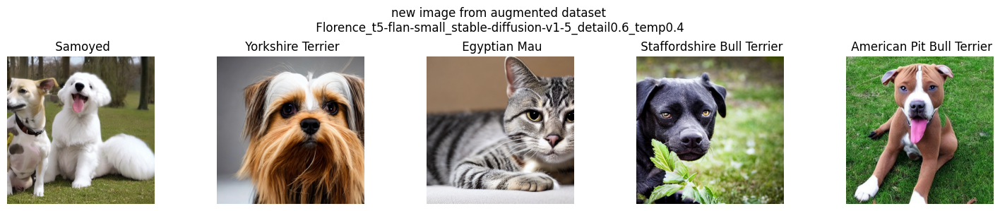

Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5


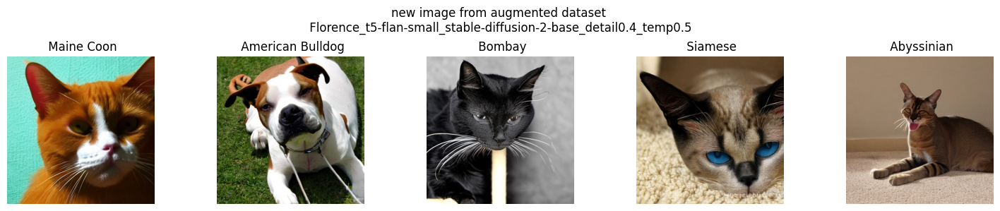

Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4


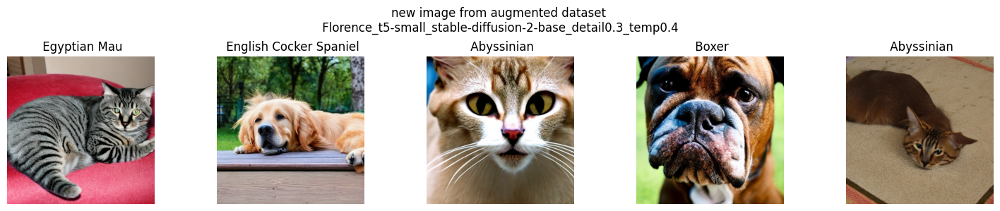

Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5


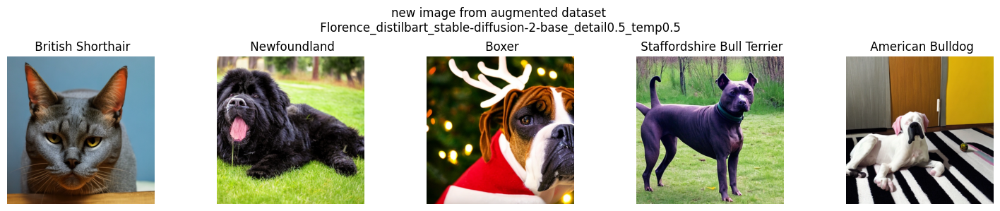



                                                                                                                                   Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 114MB/s] 


Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4


/usr/local/lib/python3.11/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.11/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5
Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4
Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5

Risultati delle metriche per ogni dataset:

Dataset                                                                |    BLEU |  ROUGE-L | Perplexity |      FID
-------------------------------------------------------------------------------------------------------------------
Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 | 0.456 | 0.653 | 1.222 | 148.02
Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 | 0.494 | 0.697 | 1.200 | 143.06
Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 | 0.228 | 0.513 | 1.374 | 143.47
Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 | 0.547 | 0.766 | 1.713 | 143.38



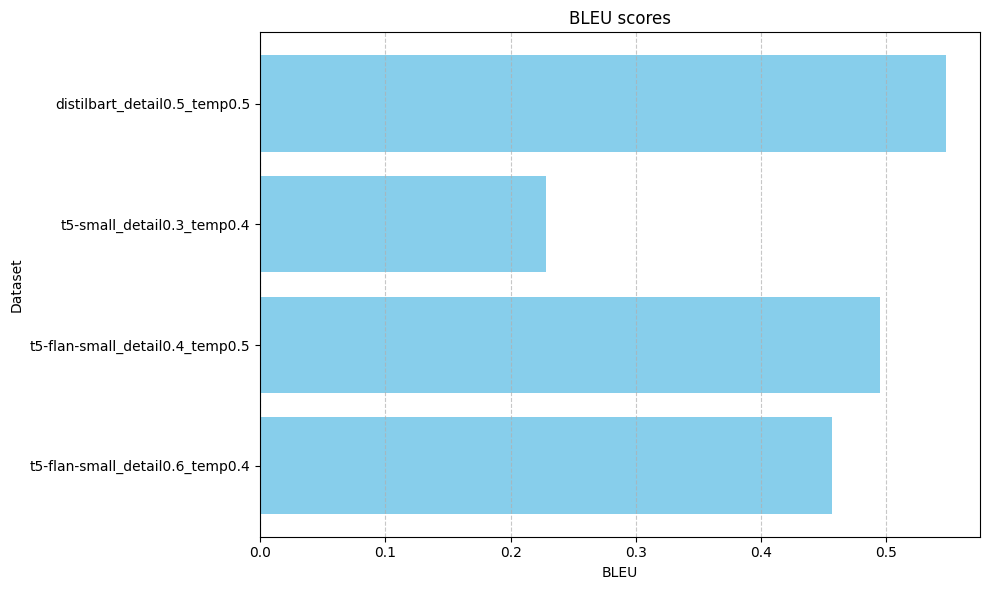

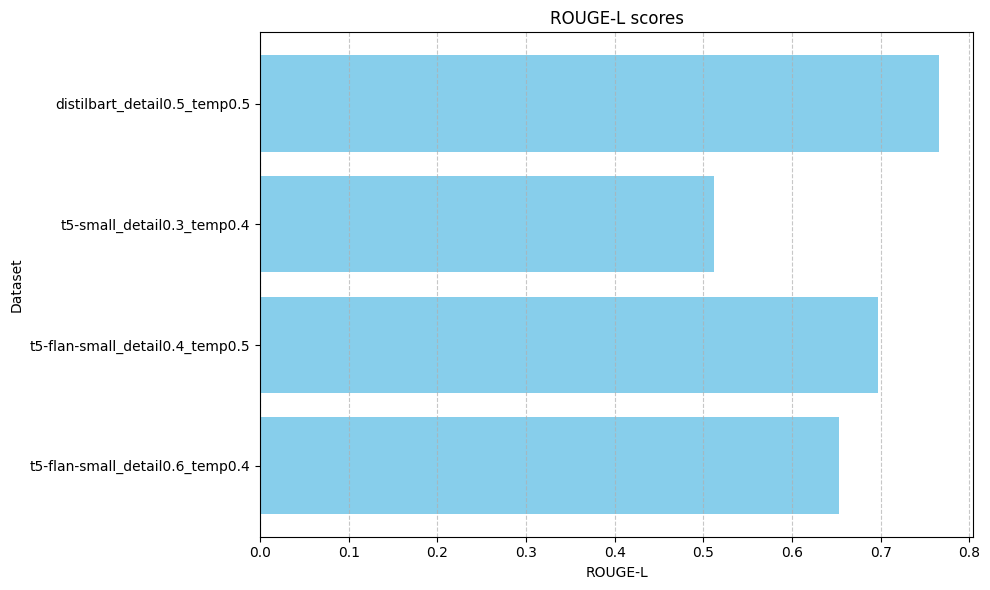

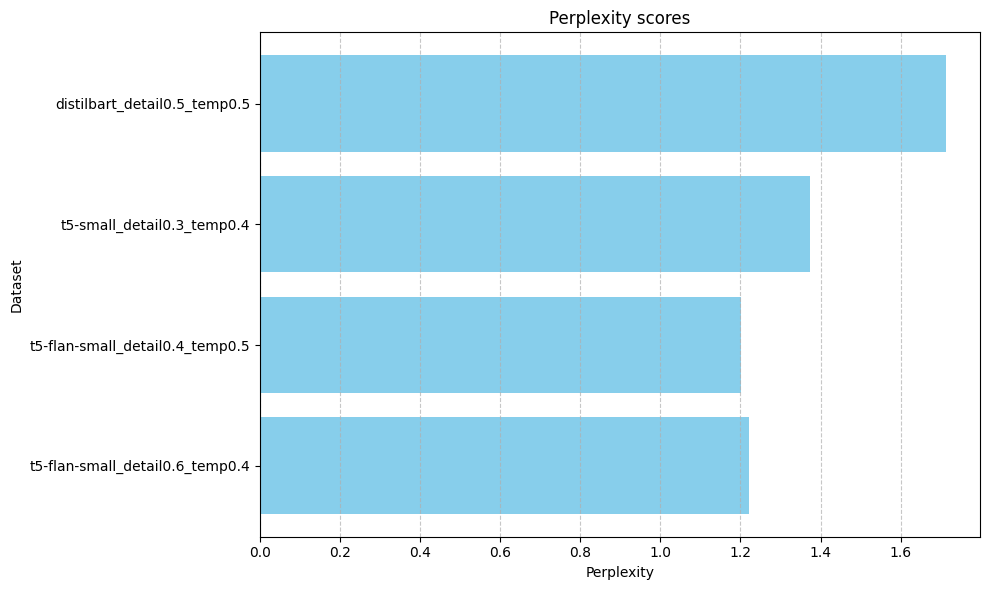

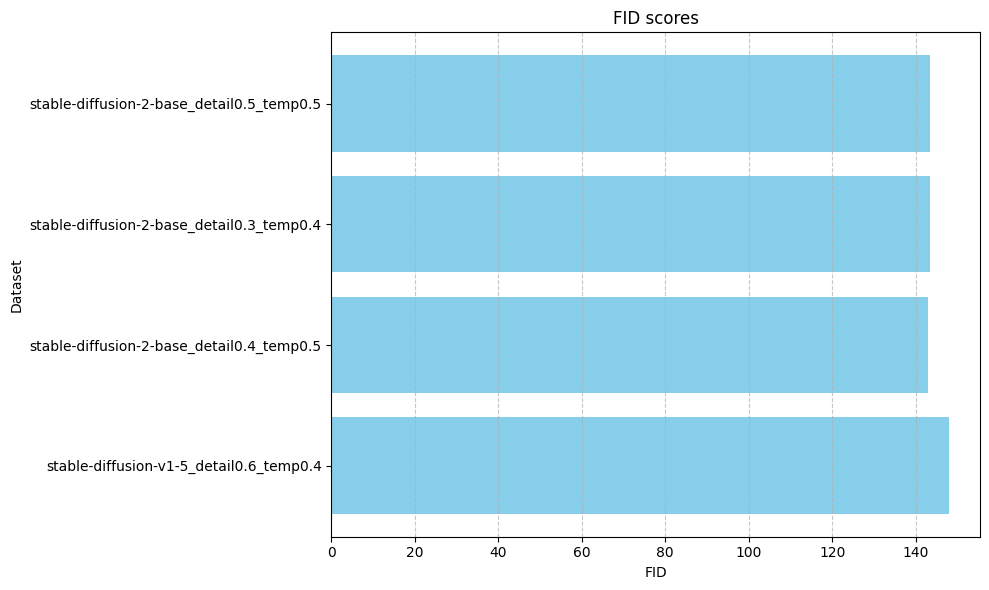

In [ ]:
from torchmetrics.image.fid import FrechetInceptionDistance
datasets = augmentor.load_augmented_datasets()

def print_results(results):
    print("\nRisultati delle metriche per ogni dataset:\n")
    # Header
    header = f"{'Dataset':<40} | {'BLEU':>7} | {'ROUGE-L':>8} | {'Perplexity':>10} | {'FID':>8}"
    print(header)
    print("-" * len(header))

    for key, metrics in results.items():
        print(f"{key:<40} | "
              f"{metrics['BLEU']:.3f} | "
              f"{metrics['ROUGE-L']:.3f} | "
              f"{metrics['Perplexity']:.3f} | "
              f"{metrics['FID']:.2f}")

    print()


def evaluate_augmented_datasets(datasets, manager):
    scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
    fid = FrechetInceptionDistance(normalize=True).to(DEVICE)


    results = {}
    transform = T.Compose([
        T.Resize((299, 299)),
        T.ToTensor()
    ])

    def prepare_for_fid(tensor_img):
      # Se ha batch size 1, rimuovilo
      if tensor_img.dim() == 4 and tensor_img.shape[0] == 1:
          tensor_img = tensor_img.squeeze(0)

      # Assicurati che l'immagine abbia shape [C,H,W]
      if tensor_img.dim() == 3:
          tensor_img = tensor_img.unsqueeze(0)  # [1, C, H, W]

      # Tensor float [0,1] -> uint8 [0,255]
      tensor_img = (tensor_img * 255).to(torch.uint8).to(DEVICE)

      return tensor_img


    for key, dataset in datasets.items():
        print(key)
        bleu_scores = []
        rouge_scores = []
        ppl_scores = []

        image_generated = []
        image_original = []

        models = manager.model_combinations[key]
        tokenizer = models["crm_tokenizer"]
        model = models["crm_model"].eval()
        images_gen_batch = []
        images_real_batch = []

        for sample in dataset:

            orig = sample["caption_original"]
            reform = sample["caption_reformulated"]

            # BLEU
            bleu = sentence_bleu([orig.split()], reform.split())
            bleu_scores.append(bleu)

            # ROUGE
            rouge = scorer.score(orig, reform)["rougeL"].fmeasure
            rouge_scores.append(rouge)

            # Perplexity
            inputs = tokenizer(reform, return_tensors="pt", truncation=True).to(DEVICE)
            with torch.no_grad():
                outputs = model(**inputs, labels=inputs["input_ids"])
                loss = outputs.loss
                perplexity = torch.exp(loss).item()
            ppl_scores.append(perplexity)

            # Per FID/IS


            if not isinstance(sample["image"], Image.Image):
                img_gen = T.ToPILImage()(sample["image"])
            else:
                img_gen = sample["image"]

            if not isinstance(sample["image_original"], Image.Image):
                img_orig = T.ToPILImage()(sample["image_original"])
            else:
                img_orig = sample["image_original"]


            image_gen = transform(img_gen).unsqueeze(0).to(DEVICE)
            image_orig = transform(img_orig).unsqueeze(0).to(DEVICE)


            image_gen_fid = prepare_for_fid(image_gen)
            image_orig_fid = prepare_for_fid(image_orig)
            images_gen_batch.append(image_gen_fid)
            images_real_batch.append(image_orig_fid)

        images_gen_batch = torch.cat(images_gen_batch, dim=0)
        images_real_batch = torch.cat(images_real_batch, dim=0)
        fid.update(images_gen_batch, real=False)
        fid.update(images_real_batch, real=True)





        results[key] = {
            "BLEU": np.mean(bleu_scores),
            "ROUGE-L": np.mean(rouge_scores),
            "Perplexity": np.mean(ppl_scores),
            "FID": fid.compute().item(),

        }



        fid.reset()

    return results


def plot_metrics(results):
    keys = list(results.keys())
    metrics = ["BLEU", "ROUGE-L", "Perplexity", "FID"]

    def extract_label(key, metric):
        parts = key.split('_')
        if len(parts) < 5:
            # se la chiave ha meno di 4 parti, fallback semplice
            return key

        if metric in ["BLEU", "ROUGE-L", "Perplexity"]:
            # seconda parte + ultima parte
            return parts[1] + '_' + parts[3] + '_' + parts[-1]
        else:
            # terza parte + ultima parte
            return parts[2] + '_' + parts[3] + '_' + parts[-1]

    for metric in metrics:
        labels = [extract_label(k, metric) for k in keys]
        metric_values = [results[k][metric] for k in keys]

        plt.figure(figsize=(10, 6))
        plt.barh(labels, metric_values, color='skyblue')
        plt.title(f"{metric} scores")
        plt.ylabel("Dataset")
        plt.xlabel(metric)
        plt.grid(axis='x', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()



# mostro 5 immagini "generate"
samples_per_dataset = 5
num_intero = random.randint(1, 10)
first_key = list(datasets.keys())[0]  # prendi la prima chiave
length = len(datasets[first_key])
r = random.randint(0, length-samples_per_dataset-10)
for key, dataset in datasets.items():
      plt.figure(figsize=(15, 3))
      plt.suptitle(f'new image from augmented dataset \n {key} ')
      print(key)
      for i in range(min(samples_per_dataset,len(dataset))):
          sample = dataset[r+i]
          image = sample["image"]
          label_name = sample["label"]

          plt.subplot(1, samples_per_dataset, i + 1)
          plt.imshow(image)
          plt.title(f" {label_name}")
          plt.axis("off")

      plt.tight_layout()
      plt.show()

def print_results(results):
    print("\nRisultati delle metriche per ogni dataset:\n")
    # Header
    header = f"{'Dataset':<70} | {'BLEU':>7} | {'ROUGE-L':>8} | {'Perplexity':>10} | {'FID':>8}"
    print(header)
    print("-" * len(header))

    for key, metrics in results.items():
        print(f"{key:<40} | "
              f"{metrics['BLEU']:.3f} | "
              f"{metrics['ROUGE-L']:.3f} | "
              f"{metrics['Perplexity']:.3f} | "
              f"{metrics['FID']:.2f}")

    print()




results_eval = evaluate_augmented_datasets(datasets, manager)
print_results(results_eval)
plot_metrics(results_eval)

In [ ]:
from collections import Counter



def classi_sbilanciate(dataset, class_names, soglia_percentuale=20):
    """
    Restituisce la lista delle classi che sono sotto la soglia di sbilanciamento rispetto alla media.
    """
    # Conta quanti elementi ci sono per ogni classe
    labels = [record['label'] for record in dataset]
    counts = Counter(labels)

    for c in class_names:
        if c not in counts:
            counts[c] = 0

    valori = list(counts.values())
    media = sum(valori) / len(valori)

    soglia = media * (1 - soglia_percentuale / 100)

    sbilanciate = [classe for classe in class_names if counts[classe] < soglia]

    return sbilanciate


def check_labels_range(dataset_old, num_classes):
    labels = [label for _, label in dataset_old]
    invalid = [l for l in labels if l < 0 or l >= num_classes]
    if invalid:
        print(f"Warning: found invalid labels: {set(invalid)}")
    else:
        print("All labels are in range.")



from collections import Counter

def normalize_labels(dataset, to_be_deleted):
    # Rimuove le etichette da escludere
    dataset_filtered = [(img, label) for img, label in dataset if label not in to_be_deleted]

    # Costruisce la nuova mappa etichette
    old_labels = sorted(set(label for _, label in dataset_filtered))
    label_map = {old: new for new, old in enumerate(old_labels)}
    #print(label_map)
    #print(old_labels)
    # Applica la nuova mappatura
    new_dataset = [(img, label_map[label]) for img, label in dataset_filtered]
    #check_labels_range(new_dataset, len(label_map))


    return new_dataset


class_to_be_deleted = set()

for k, augmented_samples in datasets.items():
    class_to_be_deleted.update(classi_sbilanciate(augmented_samples,name_classes, 20))
class_to_be_deleted_index = [name_classes.index(c) for c in class_to_be_deleted]
print(f"Classi da eliminare in quanto sbilanciate {class_to_be_deleted}")

class_to_be_deleted_index = [name_classes.index(c) for c in class_to_be_deleted]
name_classes_updated = [n for n in name_classes if n not in class_to_be_deleted]
num_class = len(name_classes_updated)
print(class_to_be_deleted_index)



Classi da eliminare in quanto sbilanciate {'Persian', 'Birman'}
[23, 6]


**DATALOADER AUGMENTED**

Questo codice crea dataset di training aumentati combinando le immagini originali ridotte del dataset Oxford Pets con immagini generate tramite tecniche di data augmentation. Per ogni combinazione di modelli (rappresentata dalle chiavi nel dizionario datasets), il processo esegue i seguenti passaggi:

- Unione dei dati: le immagini originali e le rispettive label vengono unite con quelle generate artificialmente.

- Conversione delle label: le etichette testuali vengono convertite in indici numerici (tramite convert_labels) per adattarsi al formato richiesto dai modelli di classificazione.

- Normalizzazione delle classi: si procede alla rimozione delle classi sottorappresentate o non generate correttamente e alla trasposizione degli indici delle label, per evitare "buchi" numerici nell’indice delle classi (es. saltare il numero 12 se la classe 12 è stata rimossa).

**CLASSI SBILANCIATE**

Nel dataset, alcune classi (ad esempio Persian o Birman) possono risultare sbilanciate o problematiche per due motivi principali:

- Il generatore di immagini non è riuscito a produrre immagini dettagliate e coerenti con la label originale.

- Alcune classi sono visivamente molto simili ad altre (es. Birman e Siamese), causando ambiguità nei campioni generati e bassa affidabilità nella validazione automatica.

Quando il numero di classi affette da questi problemi è relativamente basso (ad esempio 2 su 37 totali), si procede con:

- Rimozione delle classi problematiche, evitando che la loro bassa qualità comprometta la qualità del training.
Rinumerazione degli indici delle classi rimanenti, per mantenere la coerenza strutturale del dataset (nessun "buco" negli indici di classe).

In alternativa alla rimozione, è possibile ripetere il ciclo di generazione delle immagini con un validatore meno stringente.
Questo validatore, in determinati casi, può accettare un’immagine generata anche se la label attesa non è la più probabile, ma compare tra le prime due classi più probabili predette dal modello (strategia *top-2 accuracy*).
Questo approccio può aumentare il tasso di accettazione delle immagini sintetiche mantenendo comunque un buon livello di coerenza semantica.



In [ ]:




# Prepara i dataset aumentati combinando le immagini originali ridotte di Oxford Pets con le immagini generate (aumentate).
# Per ogni combinazione di modelli (key) nel dizionario 'datasets', si crea un nuovo dataset di training aumentato:
# - Combina immagini e label originali con quelli aumentati.
# - Converte le label in indici (tramite convert_labels) per uniformarsi al formato richiesto dalle
# reti neurali per la classificazione.
# Il risultato viene salvato in 'augmented_datasets' con la chiave corrispondente alla combinazione.

augmented_datasets = {}


for key, augmented_samples in datasets.items():
    print(key)
    base_images = [img for img, label in oxford_dataset_reduced_train ]
    base_labels = [label for _, label in oxford_dataset_reduced_train ]



    aug_images = [sample['image'] for sample in augmented_samples ]
    aug_labels = [sample['label'] for sample in augmented_samples ]


    combined_images = base_images + aug_images
    combined_labels = base_labels + aug_labels


    new_data = [(img, label) for img, label in zip(combined_images, combined_labels)]
    train_dataset_augmented = convert_labels(new_data, name_classes, to='index')

    print(f" Augment.. {len(oxford_dataset_reduced_train)}->{len(train_dataset_augmented)}")
    train_dataset_augmented_normalize = normalize_labels(train_dataset_augmented,class_to_be_deleted_index)
    num_label_differenti = len(set(label for _, label in train_dataset_augmented_normalize))
    print(f"  - {num_label_differenti} label differenti / classi totali {len(name_classes)}")
    print(f" Togliamo classi sbilanciate.. {len(train_dataset_augmented)}->{len(train_dataset_augmented_normalize)}\n\n")
    augmented_datasets[key] = train_dataset_augmented_normalize
    check_labels_range(train_dataset_augmented_normalize, num_class)



augmented_datasets['not_augmented_dataset'] = normalize_labels(train_dataset_reduced,class_to_be_deleted_index)
check_labels_range(augmented_datasets['not_augmented_dataset'], num_class)

print(f" No augment {len(oxford_dataset_reduced_train)}->{len(oxford_dataset_reduced_train)}")
print(f" Togliamo classi sbilanciate.. {len(oxford_dataset_reduced_train)}->{len(augmented_datasets['not_augmented_dataset'])}")



batch_size = 32

print("dimensione val set originali", len(val_dataset_reduced))
print("dimensione test set originali ", len(test_dataset_reduced))
val_dataset_reduced  = normalize_labels(val_dataset_reduced,class_to_be_deleted_index)
test_dataset_reduced  =  normalize_labels(test_dataset_reduced,class_to_be_deleted_index)



Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4
 Augment.. 370->510
  - 35 label differenti / classi totali 37
 Togliamo classi sbilanciate.. 510->490


All labels are in range.
Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5
 Augment.. 370->514
  - 35 label differenti / classi totali 37
 Togliamo classi sbilanciate.. 514->490


All labels are in range.
Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4
 Augment.. 370->510
  - 35 label differenti / classi totali 37
 Togliamo classi sbilanciate.. 510->490


All labels are in range.
Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5
 Augment.. 370->514
  - 35 label differenti / classi totali 37
 Togliamo classi sbilanciate.. 514->490


All labels are in range.
All labels are in range.
 No augment 370->370
 Togliamo classi sbilanciate.. 370->350
dimensione val set originali 148
dimensione test set originali  148


Nel processo di augmentazione dei dataset, si è riscontrato che nessuno dei generatori è riuscito a produrre immagini coerenti per la classe Birman, e uno di questi ha mostrato difficoltà anche per la classe Persian. Per garantire un dataset bilanciato e stratificato, si è quindi deciso di rimuovere queste classi problematiche. Questo ha permesso di uniformare le distribuzioni e ottenere quattro dataset augmentati, ciascuno composto da 490 immagini, equivalenti a circa 14 immagini per classe, rispetto alle 10 immagini per classe del dataset originale. Parallelamente, è stato mantenuto un dataset pulito, non augmentato, con 370 immagini totali e 10 immagini per classe, per poter conservare un riferimento stabile e bilanciato nelle fasi successive di valutazione. Questa scelta assicura coerenza nella distribuzione delle classi e migliora la qualità complessiva del training.

In [ ]:


check_labels_range(val_dataset_reduced, num_class)
check_labels_range(test_dataset_reduced, num_class)

trainloaders = []
trainsets = []
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = torch.Generator(device='cuda')



for key, samples in augmented_datasets.items():
    labels = [label for _, label in samples]
    loader = torch.utils.data.DataLoader(samples, batch_size=batch_size, shuffle=True, generator = generator, collate_fn=collate_with_transform(transform_train, device))
    trainsets.append(samples)
    trainloaders.append(loader)


valloader = torch.utils.data.DataLoader(val_dataset_reduced, batch_size=batch_size, shuffle=False, generator = generator, collate_fn=collate_with_transform(transform_val, device))
testloader = torch.utils.data.DataLoader(test_dataset_reduced, batch_size=batch_size,
                                         shuffle=False,  generator = generator,    collate_fn=collate_with_transform(transform_val, device))

print("numero delle classi:",num_class)
print("Dimensioni finali ( dopo aver tolto sbilanciamento ): ")
print("dimensione val set", len(val_dataset_reduced))
print("dimensione test set", len(test_dataset_reduced))



All labels are in range.
All labels are in range.
numero delle classi: 35
Dimensioni finali ( dopo aver tolto sbilanciamento ): 
dimensione val set 140
dimensione test set 140


In [ ]:
def tensor_to_image(img):
    if not torch.is_tensor(img):
        arr = np.array(img).astype(np.uint8)
        return arr
    img = img / 2 + 0.5
    img = torch.clamp(img, 0, 1)
    npimg = img.numpy()
    npimg = np.transpose(npimg, (1, 2, 0))
    npimg = (npimg * 255).astype(np.uint8)
    return npimg

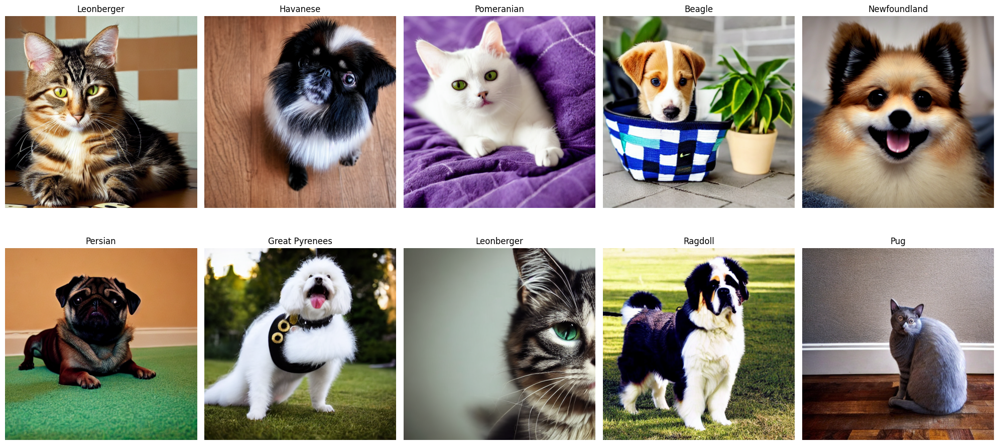

In [ ]:
# # Visualizzazione di un campione casuale di immagini dal dataset di addestramento (trainset)
#  2 righe per 5 colonne di immagini (totale 10 immagini)

num_row = 2
num_col = 5
iteration =np.random.randint(0, len(trainsets[0])-10)
mode = np.random.randint(0,3)
fig, axes = plt.subplots(num_row, num_col, figsize=(10*num_row,2*num_col))
for i in range(num_row*num_col):
    ax = axes[i//num_col, i%num_col]
    ax.imshow((trainsets[0][iteration + i][0]))
    ax.axis('off')
    ax.set_title('{}'.format(name_classes[int(trainsets[0][iteration + i][1])]))
plt.tight_layout()
plt.show()




*SECONDA FASE*

Completata la preparazione dei nuovi set di training e dei relativi dataloader, arricchiti con le immagini generate tramite data augmentation, si procede ora alla fase di addestramento dei modelli di rete neurale. Verranno impiegate architetture pre-addestrate, opportunamente adattate al nostro specifico task di classificazione multiclass con 37 categorie ( 35 nel nostro caso ) . Questa fase consentirà di valutare l’impatto dell’aumento dei dati sulla performance e sulla capacità di generalizzazione dei modelli selezionati.

SCELTA DEL MODELLO DI CLASSIFICAZIONE

Per il task di classificazione delle immagini aumentate del dataset Oxford Pets, sono stati utilizzati modelli convoluzionali pre-addestrati su ImageNet, adattati con classificatori personalizzati per il fine-tuning. La scelta dei modelli è stata orientata a bilanciare accuratezza, efficienza computazionale e dimensioni, considerando anche l’integrazione delle immagini generate tramite augmentation per migliorare le performance.

I modelli considerati sono:

VGG16_bn: rete a blocchi convoluzionali e fully connected, relativamente semplice, usata sia come baseline che per esperimenti senza pretraining.

ResNet18: reti con collegamenti residui, robuste su pattern complessi, particolarmente efficaci in fase di fine-tuning.

MobileNetV2: architettura leggera ed efficiente, adatta per ambienti a bassa potenza computazionale.

EfficientNet_b0: bilanciamento ottimale tra parametri, accuratezza e velocità, con una struttura moderna basata su compound scaling.

DenseNet121: rete con connessioni dense tra i layer, capace di apprendere feature complesse con una maggiore efficienza.

MODALITÀ DI TUNING E IPERPARAMETRI

Per gestire in modo flessibile il processo di sperimentazione e permettere un bilanciamento tra accuratezza e costi computazionali, sono state definite due modalità di tuning: easy e deep. Ciascuna modalità controlla quali modelli, ottimizzatori e numero di epoche vengono utilizzati.

Durante il training, il modello viene addestrato separatamente su ciascun dataset aumentato, corrispondente a ogni combinazione di modelli formulata dal model manager. Questo permette di analizzare come ogni architettura risponda a diversi livelli di data augmentation, valutando la robustezza e la capacità di generalizzazione dei modelli su dati con variabilità e complessità crescenti.

La modalità easy è progettata per test rapidi, utile nelle fasi iniziali del progetto o in ambienti con risorse computazionali limitate. In questa modalità si lavora con un sottoinsieme di modelli leggeri, come mobileNet e resnet18, entrambi inizializzati con pesi pre-addestrati. L’ottimizzazione viene effettuata solo con Adam a learning rate 1e-3, e il training è condotto su un numero ridotto di epoche (30).



La modalità deep rappresenta invece la configurazione più completa. Include un insieme più ampio di modelli, con architetture complesse e di comprovata efficacia come resnet18, densenet121 ed efficientnet_b0, oltre a mobilenet_v2 e vgg16_bn. I modelli sono addestrati con diversi ottimizzatori, tra cui Adam e SGD, entrambi con weight decay e learning rate pari a 1e-3, al fine di esplorare differenti traiettorie di ottimizzazione.

Il training viene eseguito per 10, 20 o 50 epoche, a seconda del setup, e beneficia della presenza di un early stopping configurato per interrompere l’apprendimento in caso di stagnazione. Anche in questa modalità, ogni modello viene addestrato con tutte e tre le varianti di data augmentation, garantendo così una valutazione comparativa completa e dettagliata su come la qualità e la quantità delle trasformazioni influenzano l’apprendimento e la generalizzazione.

In [ ]:
## MODALITA DI TUNING
##
# Modalità di tuning: 'deep' per analisi completa, 'easy' per analisi rapida
# Analisi errori effettuata con tuning easy

mode = 'easy'  # cambiare in 'easy' per la ricerca rapida

# mode deep
# mode easy
# dettagli modalità piu in basso ↓↓↓

In [ ]:
# Definizione criterion e optimizer da settare per ogni modello
criterion = nn.CrossEntropyLoss()


# Per ottimizzare i tempi di training e rendere la sperimentazione più gestibile,
# si è scelto un sottoinsieme rappresentativo di modelli e ottimizzatori.
# Questa scelta consente un buon equilibrio tra varietà di architetture e parametri
# e la praticabilità computazionale, evitando un numero eccessivo di combinazioni
# che renderebbero la ricerca troppo lunga e complessa.



# Modalità di tuning: 'deep' per ricerca completa, 'easy' per ricerca rapida
# Analisi errori effettuata con tuning deep
#
# se vuoi cambiare modalità, cerca il blocco codice su con "mode=xxxx" ↑↑↑↑

#



if mode == 'deep':
    # Modalità deep: più modelli, ottimizzatori e epoche
    models = {
       "vgg16_bn": lambda : create_model("vgg16_bn", pretrained=True, num_classes=num_class),
       "resnet18": lambda: create_model("resnet18", pretrained=True, num_classes=num_class),
       "mobilenet_v2": lambda: create_model("mobilenetv2_100", pretrained=True, num_classes=num_class),
       "efficientnet_b0": lambda: create_model("efficientnet_b0", pretrained=True, num_classes=num_class),
       "densenet121": lambda: create_model("densenet121", pretrained=True, num_classes=num_class),
    }




    optimizers = {
        "Adam_1e-3": lambda m: torch.optim.Adam(m.parameters(), lr=1e-3, weight_decay=1e-4),
        "SGD_1e-3": lambda m: torch.optim.SGD(m.parameters(), lr=1e-3, momentum=0.9, weight_decay=1e-4),
    }

    epoch_list = [10,20,50]

elif mode == 'easy':
    # Modalità easy: meno modelli, ottimizzatori e epoche per test veloci
    models = {
         # Scelta ricade su modelli leggeri, minor rischio overfitting
        "mobilenet_v2": lambda: create_model("mobilenetv2_100", pretrained=True, num_classes=num_class),
        "resnet18": lambda: create_model("resnet18", pretrained=True, num_classes=num_class),

    }

    optimizers = {
        "Adam_1e-3": lambda m: torch.optim.Adam(m.parameters(), lr=1e-3, weight_decay=1e-4),
    }

    epoch_list = [30]  # meno epoche per velocizzare

else:
    raise ValueError("Modalità sconosciuta. Usa 'deep' o 'easy'")

# Ora puoi usare questi dizionari nel training loop
print(f"Modalità selezionata: {mode}")
print("Modelli usati:")
for m in models.keys():
    print(f"  - {m}")

print("Ottimizzatori usati:")
for o in optimizers.keys():
    print(f"  - {o}")

print("Epoche usate:")
for e in epoch_list:
    print(f"  - {e}")

print("Combinazioni presenti in augmented_datasets:")
for combo in augmented_datasets.keys():
    print(f"  - {combo}")

Modalità selezionata: easy
Modelli usati:
  - mobilenet_v2
  - resnet18
Ottimizzatori usati:
  - Adam_1e-3
Epoche usate:
  - 30
Combinazioni presenti in augmented_datasets:
  - Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4
  - Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5
  - Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4
  - Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5
  - not_augmented_dataset


 
Training Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs


model.safetensors:   0%|          | 0.00/14.2M [00:00<?, ?B/s]

traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:06<00:00,  2.66it/s]


test



Training Progress:   3%|▎         | 1/30 [00:06<03:10,  6.59s/it]

Epoch 1/30, F1 score:0.5175, Train Loss: 3.1658, Val Loss: 1.4878, Val Acc: 0.5500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:   7%|▋         | 2/30 [00:12<02:57,  6.34s/it]

Epoch 2/30, F1 score:0.6606, Train Loss: 1.2410, Val Loss: 1.0673, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.93it/s]


test



Training Progress:  10%|█         | 3/30 [00:18<02:47,  6.20s/it]

Epoch 3/30, F1 score:0.6966, Train Loss: 0.8528, Val Loss: 1.0206, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:24<02:40,  6.15s/it]

Epoch 4/30, F1 score:0.6308, Train Loss: 0.7032, Val Loss: 1.0792, Val Acc: 0.6357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:30<02:32,  6.10s/it]

Epoch 5/30, F1 score:0.6674, Train Loss: 0.6594, Val Loss: 0.9683, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  20%|██        | 6/30 [00:36<02:25,  6.08s/it]

Epoch 6/30, F1 score:0.6374, Train Loss: 0.5603, Val Loss: 1.1770, Val Acc: 0.6429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.90it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:42<02:19,  6.06s/it]

Epoch 7/30, F1 score:0.6761, Train Loss: 0.5353, Val Loss: 1.1568, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:49<02:13,  6.07s/it]

Epoch 8/30, F1 score:0.6597, Train Loss: 0.5820, Val Loss: 1.1635, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  30%|███       | 9/30 [00:54<02:06,  6.04s/it]

Epoch 9/30, F1 score:0.6449, Train Loss: 0.4849, Val Loss: 1.1970, Val Acc: 0.6500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:  33%|███▎      | 10/30 [01:01<02:01,  6.06s/it]

Epoch 10/30, F1 score:0.6206, Train Loss: 0.4497, Val Loss: 1.3329, Val Acc: 0.6357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.90it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:07<01:54,  6.05s/it]

Epoch 11/30, F1 score:0.6730, Train Loss: 0.4685, Val Loss: 1.1981, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  40%|████      | 12/30 [01:13<01:48,  6.03s/it]

Epoch 12/30, F1 score:0.6699, Train Loss: 0.3847, Val Loss: 1.0276, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:19<01:42,  6.04s/it]

Epoch 13/30, F1 score:0.6664, Train Loss: 0.3009, Val Loss: 0.9524, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.82it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:25<01:37,  6.11s/it]

Epoch 14/30, F1 score:0.6847, Train Loss: 0.4001, Val Loss: 0.9449, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  50%|█████     | 15/30 [01:31<01:31,  6.07s/it]

Epoch 15/30, F1 score:0.6655, Train Loss: 0.3637, Val Loss: 1.1121, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:37<01:25,  6.07s/it]

Epoch 16/30, F1 score:0.6581, Train Loss: 0.3476, Val Loss: 1.4232, Val Acc: 0.6571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:43<01:18,  6.06s/it]

Epoch 17/30, F1 score:0.6536, Train Loss: 0.3519, Val Loss: 1.2488, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  60%|██████    | 18/30 [01:49<01:12,  6.03s/it]

Epoch 18/30, F1 score:0.7255, Train Loss: 0.3560, Val Loss: 1.1342, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:55<01:06,  6.01s/it]

Epoch 19/30, F1 score:0.7154, Train Loss: 0.3413, Val Loss: 1.0768, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.83it/s]


test



Training Progress:  67%|██████▋   | 20/30 [02:01<01:00,  6.06s/it]

Epoch 20/30, F1 score:0.5820, Train Loss: 0.3860, Val Loss: 1.5047, Val Acc: 0.5929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  70%|███████   | 21/30 [02:07<00:54,  6.03s/it]

Epoch 21/30, F1 score:0.6609, Train Loss: 0.2933, Val Loss: 1.2192, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  73%|███████▎  | 22/30 [02:13<00:48,  6.04s/it]

Epoch 22/30, F1 score:0.7053, Train Loss: 0.3230, Val Loss: 1.2374, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  77%|███████▋  | 23/30 [02:19<00:42,  6.01s/it]

Epoch 23/30, F1 score:0.6598, Train Loss: 0.3356, Val Loss: 1.2615, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.80it/s]


test



Training Progress:  80%|████████  | 24/30 [02:25<00:36,  6.08s/it]

Epoch 24/30, F1 score:0.6855, Train Loss: 0.2861, Val Loss: 1.3093, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  83%|████████▎ | 25/30 [02:31<00:30,  6.07s/it]

Epoch 25/30, F1 score:0.6571, Train Loss: 0.2759, Val Loss: 1.4122, Val Acc: 0.6571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:37<00:24,  6.06s/it]

Epoch 26/30, F1 score:0.6507, Train Loss: 0.3760, Val Loss: 1.5902, Val Acc: 0.6429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  90%|█████████ | 27/30 [02:43<00:18,  6.05s/it]

Epoch 27/30, F1 score:0.6665, Train Loss: 0.2801, Val Loss: 1.4203, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  93%|█████████▎| 28/30 [02:50<00:12,  6.06s/it]

Epoch 28/30, F1 score:0.6838, Train Loss: 0.2956, Val Loss: 1.3738, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  93%|█████████▎| 28/30 [02:55<00:12,  6.28s/it]


Epoch 29/30, F1 score:0.6852, Train Loss: 0.3056, Val Loss: 1.5552, Val Acc: 0.6929
Modello salvato in models/Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 mobilenet_v2
Early stopping
Log salvato in: models/Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 mobilenet_v2/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 10.52it/s]


              precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000         4
           1     0.2500    0.2500    0.2500         4
           2     1.0000    0.7500    0.8571         4
           3     1.0000    0.5000    0.6667         4
           4     0.4286    0.7500    0.5455         4
           5     0.6667    0.5000    0.5714         4
           6     1.0000    1.0000    1.0000         4
           7     0.4000    0.5000    0.4444         4
           8     0.6000    0.7500    0.6667         4
           9     0.8000    1.0000    0.8889         4
          10     1.0000    0.7500    0.8571         4
          11     0.3333    0.5000    0.4000         4
          12     0.2857    0.5000    0.3636         4
          13     1.0000    0.2500    0.4000         4
          14     1.0000    0.7500    0.8571         4
          15     1.0000    0.2500    0.4000         4
          16     0.6667    1.0000    0.8000         4
          17     1.0000    

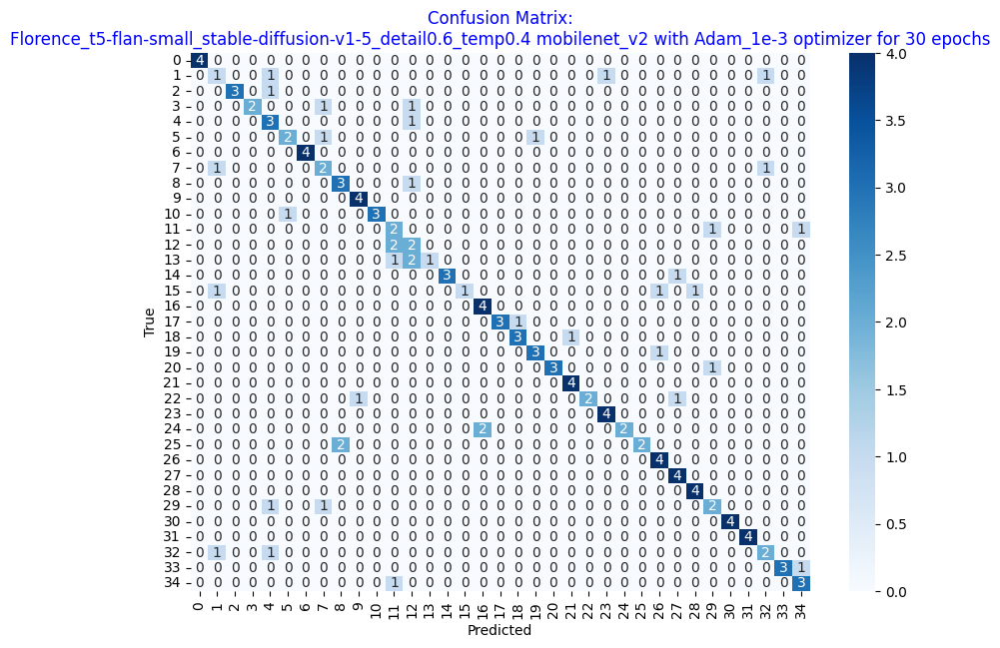


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


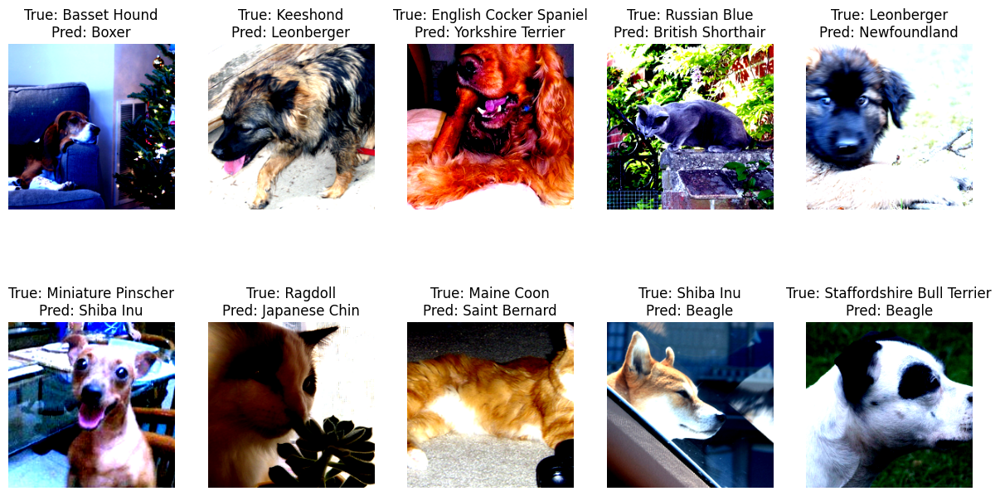

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


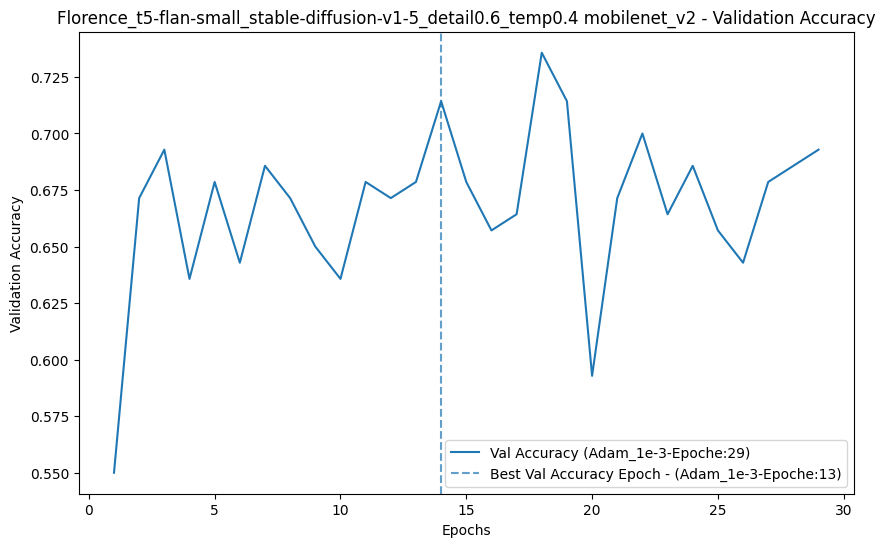

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


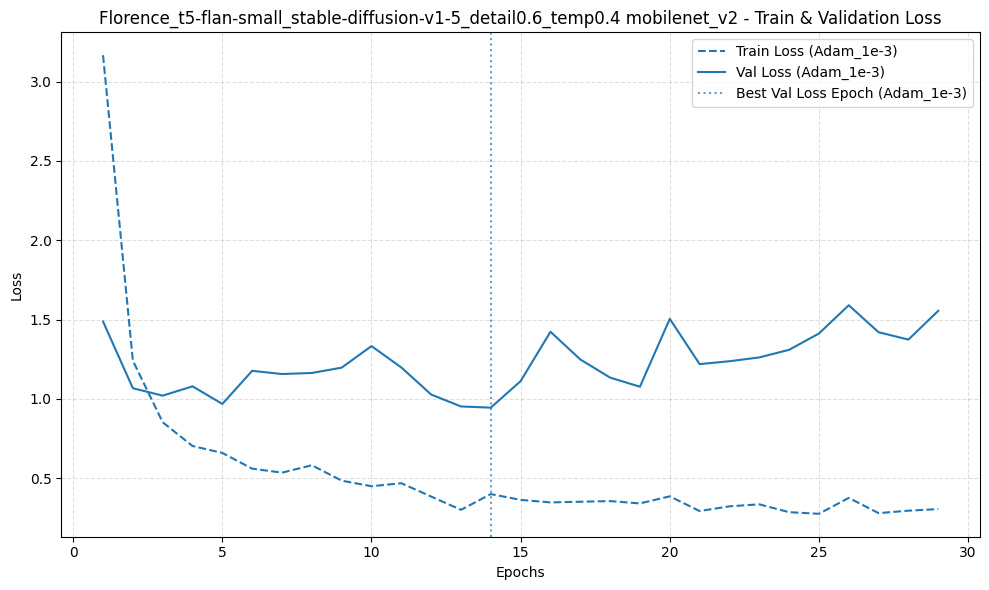

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


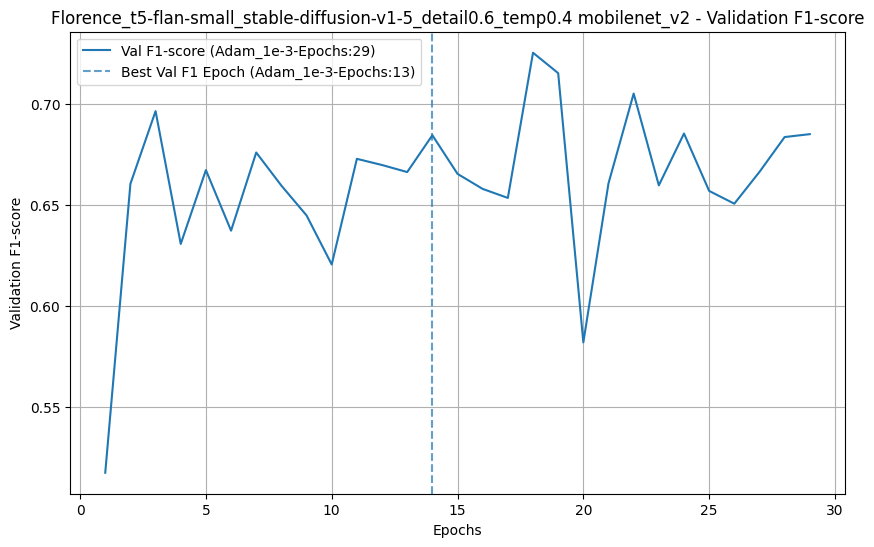

 
Training Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 model resnet18 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.17it/s]


test



Training Progress:   3%|▎         | 1/30 [00:05<02:44,  5.66s/it]

Epoch 1/30, F1 score:0.2411, Train Loss: 3.5042, Val Loss: 3.1921, Val Acc: 0.3286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.14it/s]


test



Training Progress:   7%|▋         | 2/30 [00:11<02:39,  5.71s/it]

Epoch 2/30, F1 score:0.5439, Train Loss: 3.0265, Val Loss: 2.2148, Val Acc: 0.5714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  10%|█         | 3/30 [00:17<02:34,  5.70s/it]

Epoch 3/30, F1 score:0.6971, Train Loss: 2.3670, Val Loss: 1.4752, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:22<02:27,  5.69s/it]

Epoch 4/30, F1 score:0.7022, Train Loss: 1.8555, Val Loss: 1.1628, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:28<02:23,  5.73s/it]

Epoch 5/30, F1 score:0.6793, Train Loss: 1.3928, Val Loss: 1.0847, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  20%|██        | 6/30 [00:34<02:16,  5.69s/it]

Epoch 6/30, F1 score:0.7275, Train Loss: 1.1284, Val Loss: 0.9049, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:39<02:11,  5.70s/it]

Epoch 7/30, F1 score:0.7098, Train Loss: 0.9569, Val Loss: 0.8620, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.19it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:45<02:04,  5.68s/it]

Epoch 8/30, F1 score:0.6974, Train Loss: 0.9367, Val Loss: 0.8298, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:  30%|███       | 9/30 [00:51<01:58,  5.67s/it]

Epoch 9/30, F1 score:0.7116, Train Loss: 0.7689, Val Loss: 0.8325, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:56<01:52,  5.65s/it]

Epoch 10/30, F1 score:0.7275, Train Loss: 0.6590, Val Loss: 0.8004, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:02<01:47,  5.67s/it]

Epoch 11/30, F1 score:0.7147, Train Loss: 0.5439, Val Loss: 0.7689, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  40%|████      | 12/30 [01:08<01:41,  5.62s/it]

Epoch 12/30, F1 score:0.7207, Train Loss: 0.5690, Val Loss: 0.8676, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:13<01:36,  5.71s/it]

Epoch 13/30, F1 score:0.7355, Train Loss: 0.4948, Val Loss: 0.7311, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:19<01:30,  5.66s/it]

Epoch 14/30, F1 score:0.7384, Train Loss: 0.4587, Val Loss: 0.7861, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  50%|█████     | 15/30 [01:25<01:24,  5.65s/it]

Epoch 15/30, F1 score:0.7632, Train Loss: 0.4621, Val Loss: 0.6657, Val Acc: 0.7786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.20it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:30<01:18,  5.60s/it]

Epoch 16/30, F1 score:0.7152, Train Loss: 0.4756, Val Loss: 0.8080, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:36<01:12,  5.61s/it]

Epoch 17/30, F1 score:0.6583, Train Loss: 0.4624, Val Loss: 1.0251, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.16it/s]


test



Training Progress:  60%|██████    | 18/30 [01:41<01:07,  5.58s/it]

Epoch 18/30, F1 score:0.7187, Train Loss: 0.4933, Val Loss: 0.7874, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.19it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:47<01:01,  5.55s/it]

Epoch 19/30, F1 score:0.6887, Train Loss: 0.4074, Val Loss: 0.9450, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  67%|██████▋   | 20/30 [01:52<00:56,  5.61s/it]

Epoch 20/30, F1 score:0.7496, Train Loss: 0.4542, Val Loss: 0.8979, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.17it/s]


test



Training Progress:  70%|███████   | 21/30 [01:58<00:50,  5.59s/it]

Epoch 21/30, F1 score:0.7422, Train Loss: 0.3916, Val Loss: 0.8290, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  73%|███████▎  | 22/30 [02:04<00:44,  5.61s/it]

Epoch 22/30, F1 score:0.7410, Train Loss: 0.3841, Val Loss: 0.7776, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.17it/s]


test



Training Progress:  77%|███████▋  | 23/30 [02:09<00:39,  5.59s/it]

Epoch 23/30, F1 score:0.7247, Train Loss: 0.4117, Val Loss: 0.9324, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  80%|████████  | 24/30 [02:15<00:33,  5.62s/it]

Epoch 24/30, F1 score:0.6901, Train Loss: 0.4523, Val Loss: 0.9539, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  83%|████████▎ | 25/30 [02:20<00:27,  5.58s/it]

Epoch 25/30, F1 score:0.7579, Train Loss: 0.4245, Val Loss: 0.8219, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.19it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:26<00:22,  5.57s/it]

Epoch 26/30, F1 score:0.7619, Train Loss: 0.3317, Val Loss: 0.8149, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.19it/s]


test



Training Progress:  90%|█████████ | 27/30 [02:31<00:16,  5.55s/it]

Epoch 27/30, F1 score:0.7459, Train Loss: 0.3648, Val Loss: 0.8903, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.16it/s]


test



Training Progress:  93%|█████████▎| 28/30 [02:37<00:11,  5.56s/it]

Epoch 28/30, F1 score:0.7141, Train Loss: 0.3706, Val Loss: 0.9792, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  97%|█████████▋| 29/30 [02:43<00:05,  5.58s/it]

Epoch 29/30, F1 score:0.6755, Train Loss: 0.3904, Val Loss: 0.9743, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.18it/s]


test



Training Progress:  97%|█████████▋| 29/30 [02:48<00:05,  5.82s/it]


Epoch 30/30, F1 score:0.7380, Train Loss: 0.3716, Val Loss: 0.7920, Val Acc: 0.7429
Modello salvato in models/Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 resnet18
Early stopping
Log salvato in: models/Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 resnet18/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 10.78it/s]


              precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000         4
           1     0.5000    0.2500    0.3333         4
           2     0.3636    1.0000    0.5333         4
           3     1.0000    0.7500    0.8571         4
           4     0.6667    1.0000    0.8000         4
           5     0.7500    0.7500    0.7500         4
           6     0.8000    1.0000    0.8889         4
           7     1.0000    0.2500    0.4000         4
           8     1.0000    0.5000    0.6667         4
           9     1.0000    0.5000    0.6667         4
          10     1.0000    1.0000    1.0000         4
          11     0.6667    0.5000    0.5714         4
          12     0.7500    0.7500    0.7500         4
          13     1.0000    1.0000    1.0000         4
          14     1.0000    0.7500    0.8571         4
          15     0.5000    0.7500    0.6000         4
          16     1.0000    1.0000    1.0000         4
          17     1.0000    

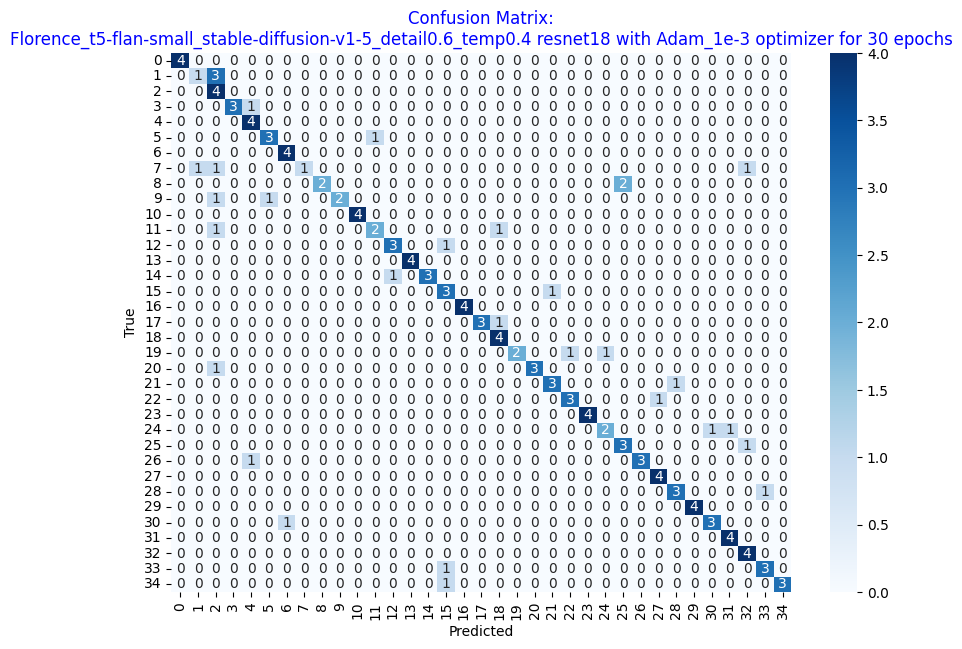


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


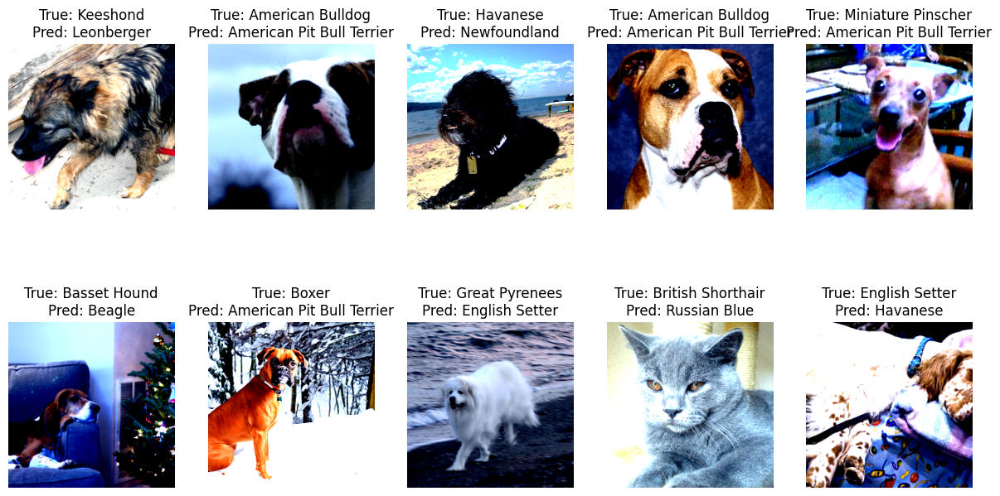

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


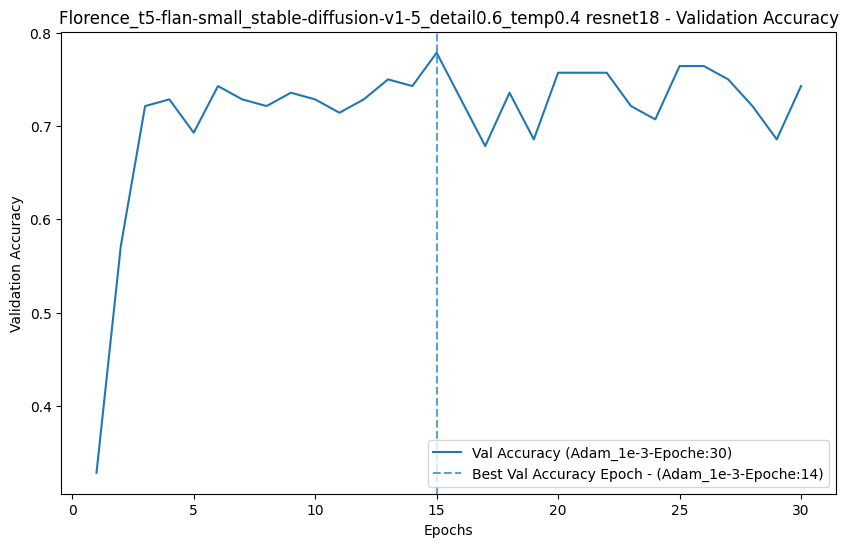

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


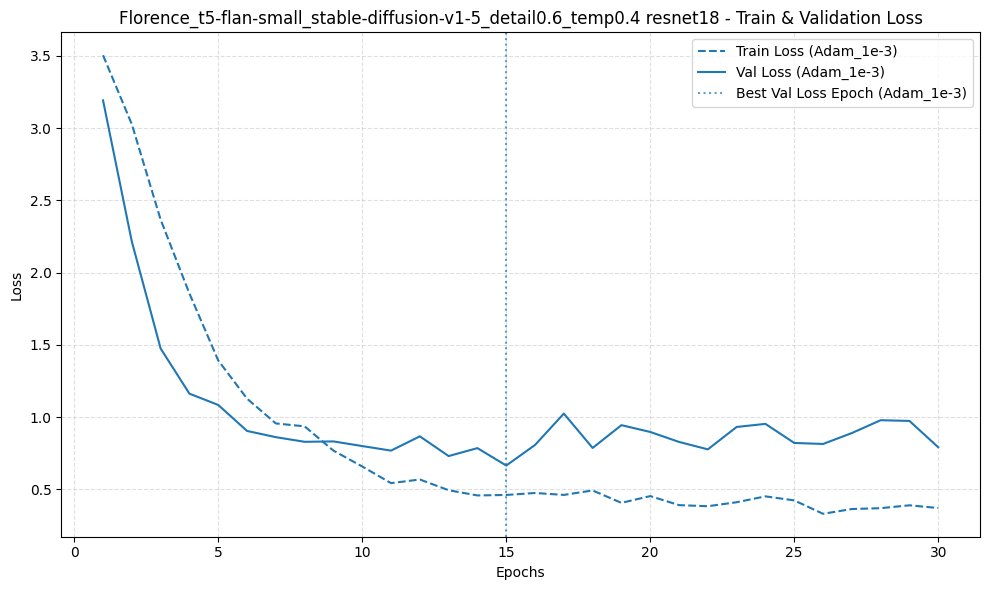

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


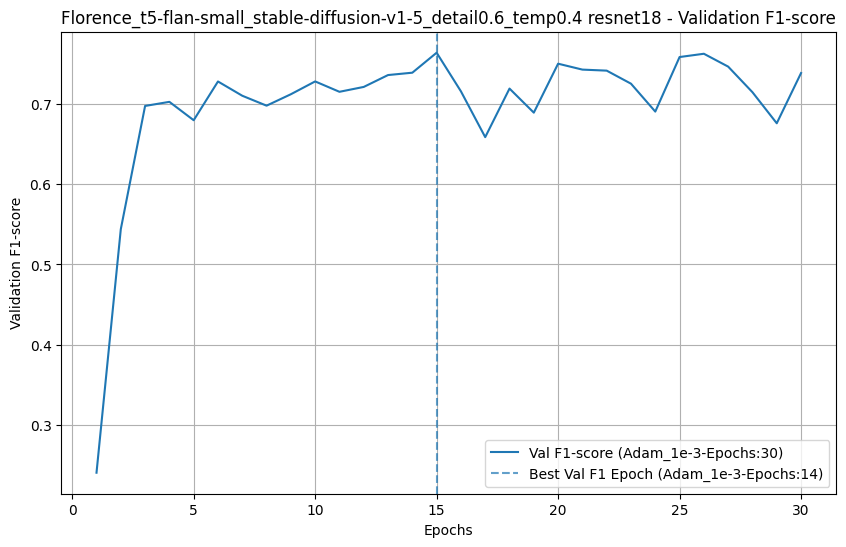

 
Training Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.93it/s]


test



Training Progress:   3%|▎         | 1/30 [00:06<02:54,  6.01s/it]

Epoch 1/30, F1 score:0.4692, Train Loss: 3.1938, Val Loss: 1.5128, Val Acc: 0.5214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:   7%|▋         | 2/30 [00:12<02:50,  6.09s/it]

Epoch 2/30, F1 score:0.6510, Train Loss: 1.4223, Val Loss: 1.0330, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:  10%|█         | 3/30 [00:18<02:45,  6.11s/it]

Epoch 3/30, F1 score:0.6467, Train Loss: 0.9205, Val Loss: 1.1605, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:24<02:39,  6.13s/it]

Epoch 4/30, F1 score:0.6662, Train Loss: 0.7952, Val Loss: 1.1636, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.93it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:30<02:32,  6.09s/it]

Epoch 5/30, F1 score:0.7153, Train Loss: 0.6046, Val Loss: 0.9528, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  20%|██        | 6/30 [00:36<02:25,  6.08s/it]

Epoch 6/30, F1 score:0.6560, Train Loss: 0.5733, Val Loss: 1.1351, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.91it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:42<02:19,  6.07s/it]

Epoch 7/30, F1 score:0.6764, Train Loss: 0.4495, Val Loss: 1.0805, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:48<02:13,  6.09s/it]

Epoch 8/30, F1 score:0.7686, Train Loss: 0.5230, Val Loss: 1.0776, Val Acc: 0.7714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.91it/s]


test



Training Progress:  30%|███       | 9/30 [00:54<02:07,  6.07s/it]

Epoch 9/30, F1 score:0.6731, Train Loss: 0.4959, Val Loss: 1.2330, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:  33%|███▎      | 10/30 [01:00<02:01,  6.09s/it]

Epoch 10/30, F1 score:0.7220, Train Loss: 0.4171, Val Loss: 1.0963, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:06<01:55,  6.09s/it]

Epoch 11/30, F1 score:0.6849, Train Loss: 0.3765, Val Loss: 1.1279, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  40%|████      | 12/30 [01:13<01:49,  6.11s/it]

Epoch 12/30, F1 score:0.6242, Train Loss: 0.5388, Val Loss: 1.4146, Val Acc: 0.6500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:19<01:44,  6.12s/it]

Epoch 13/30, F1 score:0.6605, Train Loss: 0.4252, Val Loss: 1.3184, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:25<01:37,  6.10s/it]

Epoch 14/30, F1 score:0.6466, Train Loss: 0.4315, Val Loss: 1.5007, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.90it/s]


test



Training Progress:  50%|█████     | 15/30 [01:31<01:31,  6.08s/it]

Epoch 15/30, F1 score:0.6559, Train Loss: 0.4789, Val Loss: 1.4750, Val Acc: 0.6500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:37<01:25,  6.11s/it]

Epoch 16/30, F1 score:0.6462, Train Loss: 0.4601, Val Loss: 1.4834, Val Acc: 0.6429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.89it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:43<01:19,  6.09s/it]

Epoch 17/30, F1 score:0.7101, Train Loss: 0.2998, Val Loss: 1.3381, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:  60%|██████    | 18/30 [01:49<01:12,  6.08s/it]

Epoch 18/30, F1 score:0.6579, Train Loss: 0.3360, Val Loss: 1.4432, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:55<01:06,  6.04s/it]

Epoch 19/30, F1 score:0.6570, Train Loss: 0.3753, Val Loss: 1.4233, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.92it/s]


test



Training Progress:  63%|██████▎   | 19/30 [02:01<01:10,  6.40s/it]


Epoch 20/30, F1 score:0.6898, Train Loss: 0.3177, Val Loss: 1.4683, Val Acc: 0.7000
Modello salvato in models/Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 mobilenet_v2
Early stopping
Log salvato in: models/Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 mobilenet_v2/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00,  9.59it/s]


              precision    recall  f1-score   support

           0     0.8000    1.0000    0.8889         4
           1     0.4444    1.0000    0.6154         4
           2     0.5714    1.0000    0.7273         4
           3     0.5000    0.5000    0.5000         4
           4     0.0000    0.0000    0.0000         4
           5     0.5000    0.7500    0.6000         4
           6     1.0000    1.0000    1.0000         4
           7     1.0000    0.5000    0.6667         4
           8     1.0000    0.5000    0.6667         4
           9     1.0000    0.5000    0.6667         4
          10     1.0000    0.5000    0.6667         4
          11     1.0000    0.5000    0.6667         4
          12     0.4286    0.7500    0.5455         4
          13     0.6667    1.0000    0.8000         4
          14     0.2500    0.2500    0.2500         4
          15     0.5000    0.5000    0.5000         4
          16     1.0000    0.7500    0.8571         4
          17     1.0000    

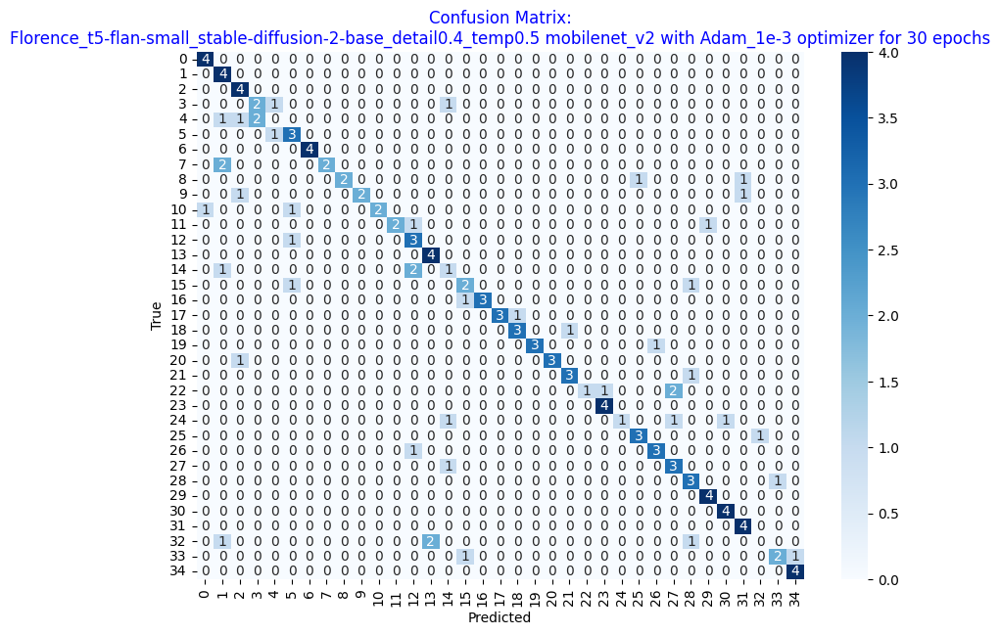


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


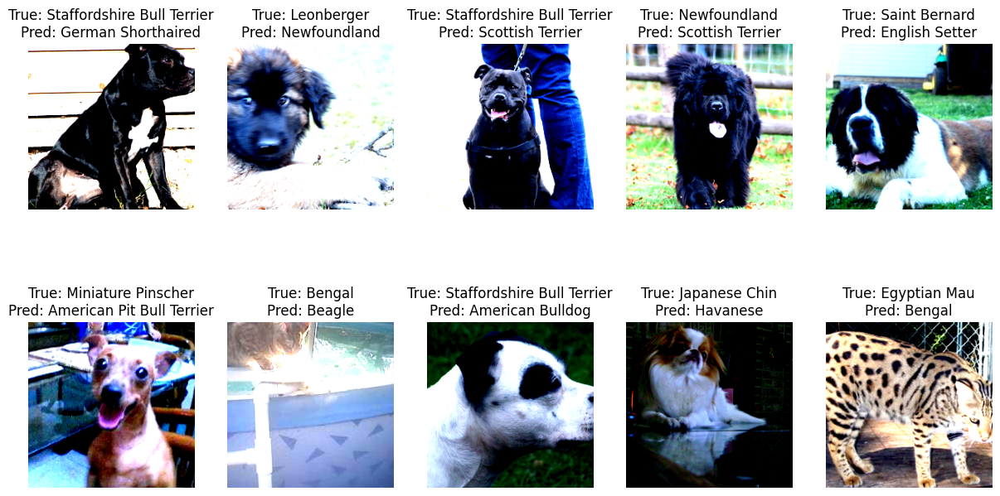

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


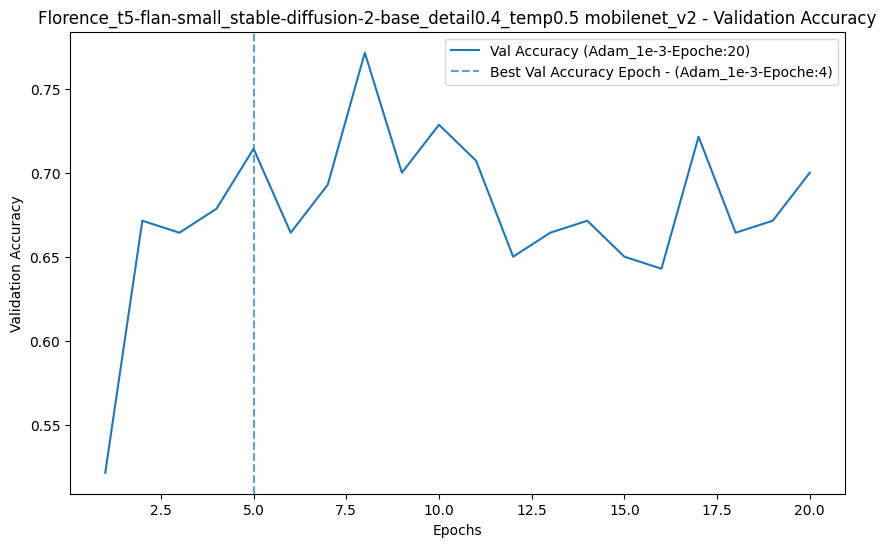

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


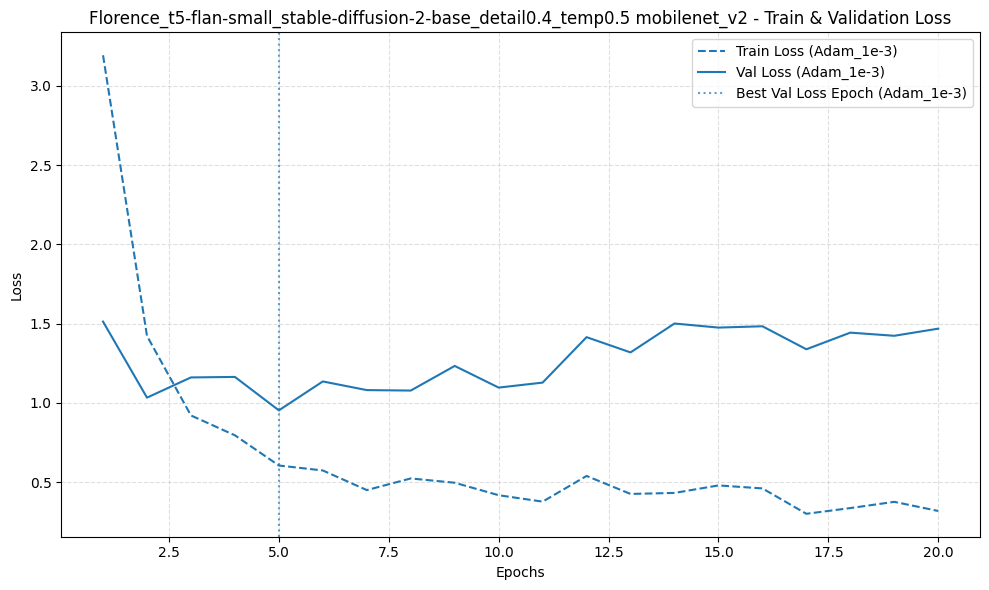

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


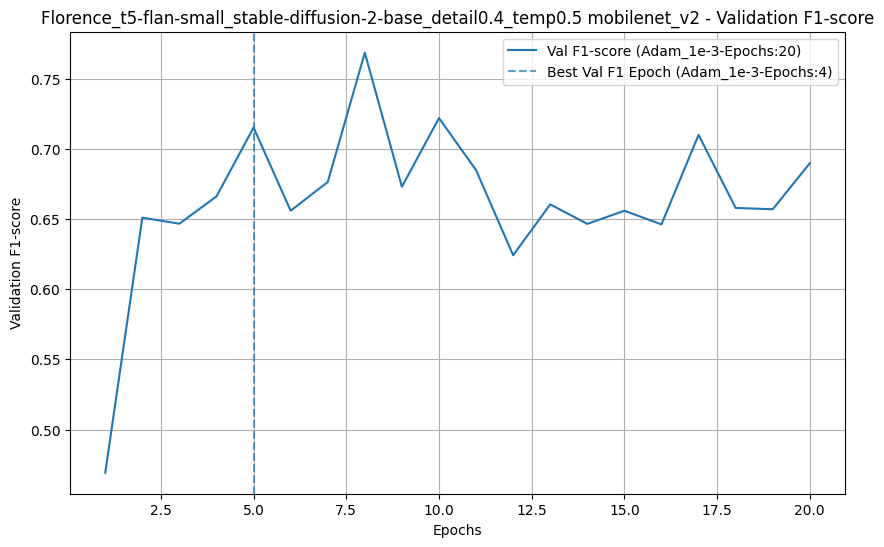

 
Training Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 model resnet18 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:   3%|▎         | 1/30 [00:05<02:46,  5.73s/it]

Epoch 1/30, F1 score:0.1829, Train Loss: 3.5163, Val Loss: 3.2583, Val Acc: 0.2286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:   7%|▋         | 2/30 [00:11<02:41,  5.76s/it]

Epoch 2/30, F1 score:0.5431, Train Loss: 3.0670, Val Loss: 2.2899, Val Acc: 0.5714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  10%|█         | 3/30 [00:17<02:35,  5.74s/it]

Epoch 3/30, F1 score:0.6622, Train Loss: 2.4054, Val Loss: 1.4950, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:22<02:28,  5.72s/it]

Epoch 4/30, F1 score:0.6937, Train Loss: 1.7964, Val Loss: 1.0858, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:28<02:22,  5.69s/it]

Epoch 5/30, F1 score:0.6661, Train Loss: 1.4139, Val Loss: 1.1781, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  20%|██        | 6/30 [00:34<02:16,  5.71s/it]

Epoch 6/30, F1 score:0.6885, Train Loss: 1.1869, Val Loss: 1.0224, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.16it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:39<02:10,  5.68s/it]

Epoch 7/30, F1 score:0.7155, Train Loss: 0.9350, Val Loss: 0.8962, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:45<02:05,  5.73s/it]

Epoch 8/30, F1 score:0.6961, Train Loss: 0.8473, Val Loss: 0.8549, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  30%|███       | 9/30 [00:51<02:00,  5.73s/it]

Epoch 9/30, F1 score:0.7536, Train Loss: 0.7128, Val Loss: 0.8043, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.09it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:57<01:53,  5.69s/it]

Epoch 10/30, F1 score:0.7007, Train Loss: 0.6854, Val Loss: 0.8750, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:02<01:47,  5.68s/it]

Epoch 11/30, F1 score:0.7241, Train Loss: 0.5997, Val Loss: 0.8555, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  40%|████      | 12/30 [01:08<01:43,  5.74s/it]

Epoch 12/30, F1 score:0.7574, Train Loss: 0.5929, Val Loss: 0.7604, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:14<01:36,  5.68s/it]

Epoch 13/30, F1 score:0.6667, Train Loss: 0.5107, Val Loss: 1.0443, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:19<01:31,  5.69s/it]

Epoch 14/30, F1 score:0.7021, Train Loss: 0.5292, Val Loss: 0.9071, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  50%|█████     | 15/30 [01:25<01:24,  5.66s/it]

Epoch 15/30, F1 score:0.6935, Train Loss: 0.4833, Val Loss: 0.8204, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:31<01:19,  5.68s/it]

Epoch 16/30, F1 score:0.7188, Train Loss: 0.4636, Val Loss: 0.7920, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:36<01:13,  5.68s/it]

Epoch 17/30, F1 score:0.7000, Train Loss: 0.3739, Val Loss: 0.8345, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  60%|██████    | 18/30 [01:42<01:08,  5.67s/it]

Epoch 18/30, F1 score:0.6808, Train Loss: 0.5151, Val Loss: 0.9421, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:48<01:02,  5.67s/it]

Epoch 19/30, F1 score:0.6856, Train Loss: 0.4273, Val Loss: 0.9359, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  67%|██████▋   | 20/30 [01:53<00:56,  5.64s/it]

Epoch 20/30, F1 score:0.7037, Train Loss: 0.4538, Val Loss: 0.8110, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.05it/s]


test



Training Progress:  70%|███████   | 21/30 [01:59<00:51,  5.70s/it]

Epoch 21/30, F1 score:0.7113, Train Loss: 0.4371, Val Loss: 0.8863, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.09it/s]


test



Training Progress:  73%|███████▎  | 22/30 [02:05<00:45,  5.68s/it]

Epoch 22/30, F1 score:0.6906, Train Loss: 0.4223, Val Loss: 0.8744, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  77%|███████▋  | 23/30 [02:10<00:39,  5.68s/it]

Epoch 23/30, F1 score:0.6528, Train Loss: 0.3948, Val Loss: 0.9891, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  80%|████████  | 24/30 [02:16<00:33,  5.67s/it]

Epoch 24/30, F1 score:0.7433, Train Loss: 0.3926, Val Loss: 0.9138, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:  83%|████████▎ | 25/30 [02:22<00:28,  5.67s/it]

Epoch 25/30, F1 score:0.7525, Train Loss: 0.4362, Val Loss: 0.8549, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.14it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:27<00:22,  5.65s/it]

Epoch 26/30, F1 score:0.7391, Train Loss: 0.4439, Val Loss: 0.9417, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.13it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:33<00:23,  5.90s/it]


Epoch 27/30, F1 score:0.7127, Train Loss: 0.3918, Val Loss: 0.9444, Val Acc: 0.7286
Modello salvato in models/Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 resnet18
Early stopping
Log salvato in: models/Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 resnet18/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00,  9.46it/s]


              precision    recall  f1-score   support

           0     0.7500    0.7500    0.7500         4
           1     0.6000    0.7500    0.6667         4
           2     1.0000    0.7500    0.8571         4
           3     0.5000    0.5000    0.5000         4
           4     0.6667    0.5000    0.5714         4
           5     0.6000    0.7500    0.6667         4
           6     1.0000    1.0000    1.0000         4
           7     1.0000    0.7500    0.8571         4
           8     1.0000    0.5000    0.6667         4
           9     1.0000    0.7500    0.8571         4
          10     1.0000    1.0000    1.0000         4
          11     0.5000    0.5000    0.5000         4
          12     0.7500    0.7500    0.7500         4
          13     0.6000    0.7500    0.6667         4
          14     1.0000    0.7500    0.8571         4
          15     1.0000    0.5000    0.6667         4
          16     1.0000    1.0000    1.0000         4
          17     0.7500    

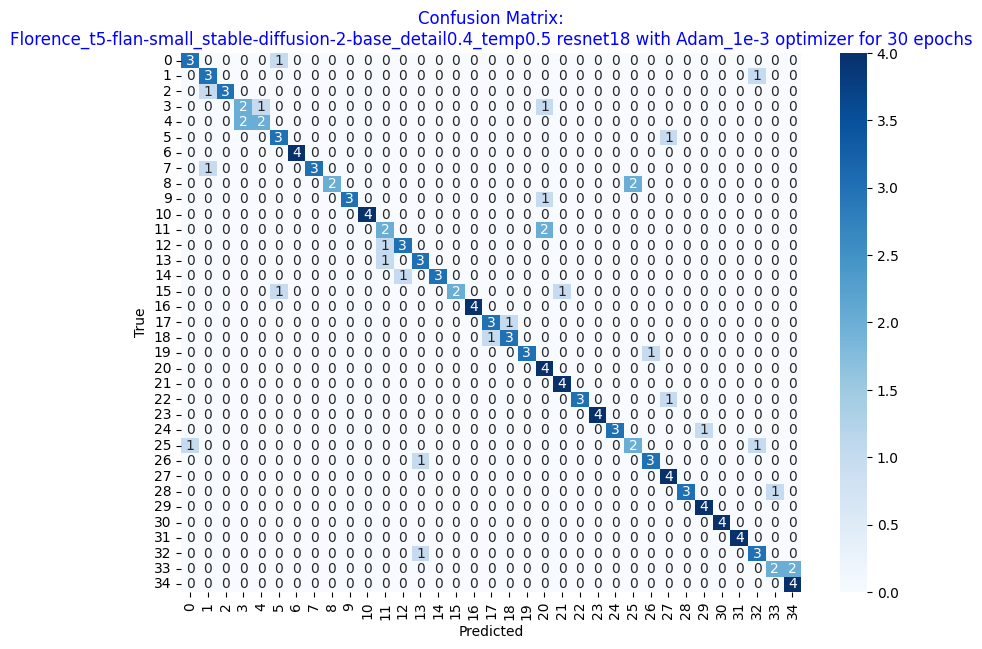


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


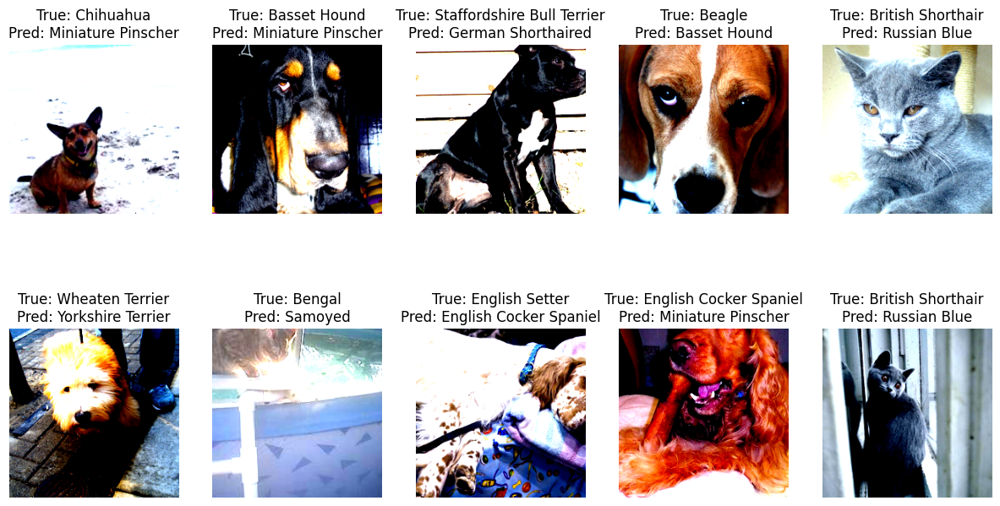

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


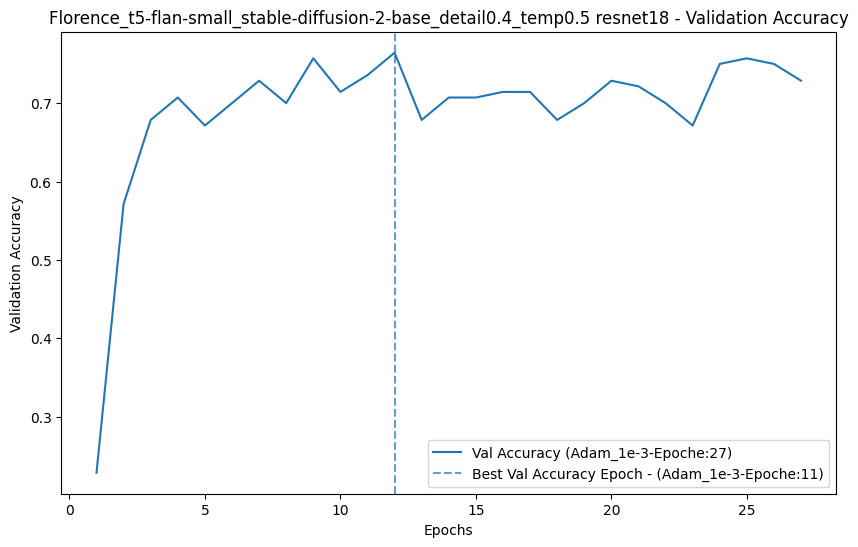

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


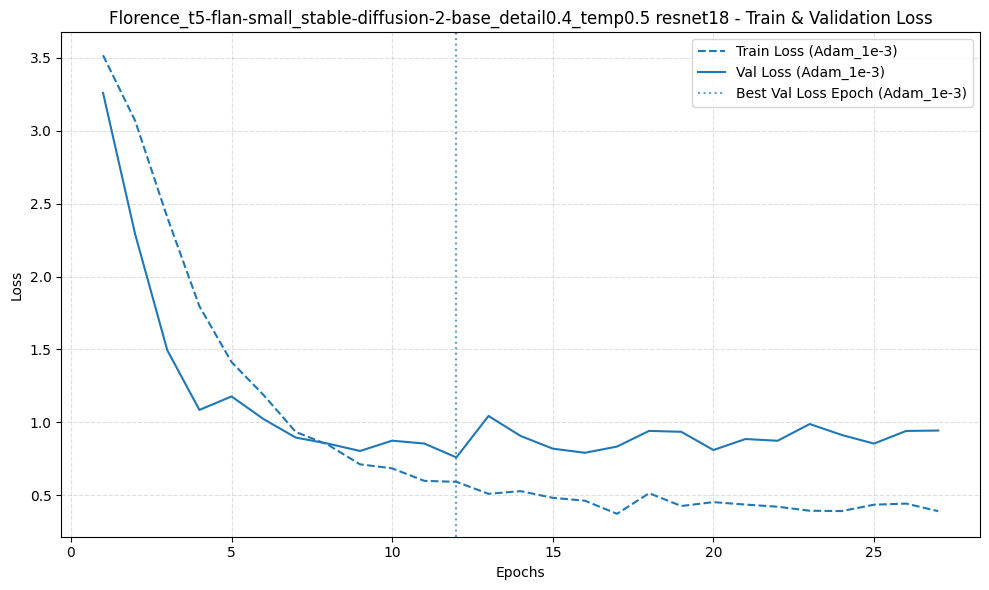

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


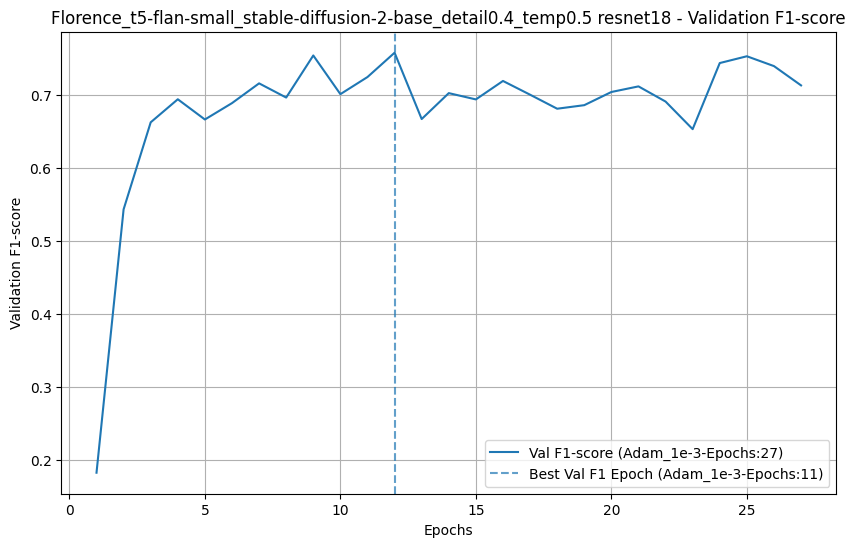

 
Training Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:   3%|▎         | 1/30 [00:06<03:00,  6.23s/it]

Epoch 1/30, F1 score:0.5006, Train Loss: 3.2109, Val Loss: 1.5908, Val Acc: 0.5214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:   7%|▋         | 2/30 [00:12<02:54,  6.22s/it]

Epoch 2/30, F1 score:0.5920, Train Loss: 1.3191, Val Loss: 1.2876, Val Acc: 0.6071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:  10%|█         | 3/30 [00:18<02:47,  6.19s/it]

Epoch 3/30, F1 score:0.5856, Train Loss: 0.8730, Val Loss: 1.3068, Val Acc: 0.6071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:24<02:41,  6.22s/it]

Epoch 4/30, F1 score:0.6518, Train Loss: 0.7075, Val Loss: 1.1061, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.88it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:31<02:34,  6.19s/it]

Epoch 5/30, F1 score:0.6296, Train Loss: 0.5665, Val Loss: 1.3252, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  20%|██        | 6/30 [00:37<02:28,  6.19s/it]

Epoch 6/30, F1 score:0.6899, Train Loss: 0.6512, Val Loss: 1.0385, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.86it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:43<02:22,  6.18s/it]

Epoch 7/30, F1 score:0.6772, Train Loss: 0.5970, Val Loss: 1.2265, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:49<02:15,  6.18s/it]

Epoch 8/30, F1 score:0.7102, Train Loss: 0.5072, Val Loss: 1.1075, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.91it/s]


test



Training Progress:  30%|███       | 9/30 [00:55<02:09,  6.18s/it]

Epoch 9/30, F1 score:0.6968, Train Loss: 0.4566, Val Loss: 1.0854, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.90it/s]


test



Training Progress:  33%|███▎      | 10/30 [01:01<02:02,  6.14s/it]

Epoch 10/30, F1 score:0.7008, Train Loss: 0.4145, Val Loss: 1.2432, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:07<01:56,  6.15s/it]

Epoch 11/30, F1 score:0.6784, Train Loss: 0.4174, Val Loss: 1.0604, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  40%|████      | 12/30 [01:14<01:50,  6.14s/it]

Epoch 12/30, F1 score:0.6571, Train Loss: 0.3625, Val Loss: 1.1904, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.83it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:20<01:44,  6.16s/it]

Epoch 13/30, F1 score:0.6696, Train Loss: 0.3304, Val Loss: 1.2075, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.78it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:26<01:38,  6.18s/it]

Epoch 14/30, F1 score:0.6505, Train Loss: 0.4728, Val Loss: 1.3324, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.79it/s]


test



Training Progress:  50%|█████     | 15/30 [01:32<01:33,  6.21s/it]

Epoch 15/30, F1 score:0.7194, Train Loss: 0.3384, Val Loss: 1.1589, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:38<01:26,  6.18s/it]

Epoch 16/30, F1 score:0.6427, Train Loss: 0.3814, Val Loss: 1.4071, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.90it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:44<01:20,  6.17s/it]

Epoch 17/30, F1 score:0.6674, Train Loss: 0.3526, Val Loss: 1.2393, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.82it/s]


test



Training Progress:  60%|██████    | 18/30 [01:51<01:14,  6.17s/it]

Epoch 18/30, F1 score:0.6784, Train Loss: 0.3836, Val Loss: 1.1547, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:57<01:08,  6.19s/it]

Epoch 19/30, F1 score:0.7048, Train Loss: 0.3215, Val Loss: 1.3433, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.83it/s]


test



Training Progress:  67%|██████▋   | 20/30 [02:03<01:02,  6.20s/it]

Epoch 20/30, F1 score:0.7129, Train Loss: 0.3219, Val Loss: 1.1947, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.83it/s]


test



Training Progress:  67%|██████▋   | 20/30 [02:09<01:04,  6.49s/it]


Epoch 21/30, F1 score:0.6873, Train Loss: 0.4213, Val Loss: 1.3209, Val Acc: 0.7000
Modello salvato in models/Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 mobilenet_v2
Early stopping
Log salvato in: models/Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 mobilenet_v2/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00,  8.38it/s]


              precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000         4
           1     1.0000    0.2500    0.4000         4
           2     0.5000    1.0000    0.6667         4
           3     1.0000    0.5000    0.6667         4
           4     0.5000    1.0000    0.6667         4
           5     0.7500    0.7500    0.7500         4
           6     1.0000    0.7500    0.8571         4
           7     0.8000    1.0000    0.8889         4
           8     0.5000    0.2500    0.3333         4
           9     1.0000    0.5000    0.6667         4
          10     1.0000    0.5000    0.6667         4
          11     0.2857    0.5000    0.3636         4
          12     0.6000    0.7500    0.6667         4
          13     1.0000    1.0000    1.0000         4
          14     0.6667    0.5000    0.5714         4
          15     1.0000    0.5000    0.6667         4
          16     1.0000    0.5000    0.6667         4
          17     1.0000    

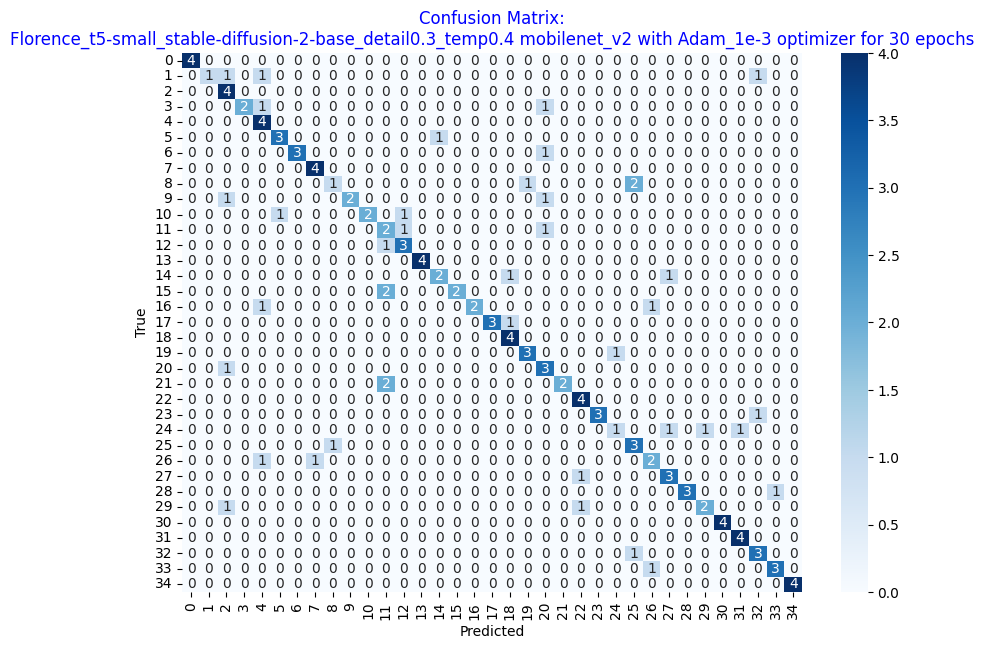


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


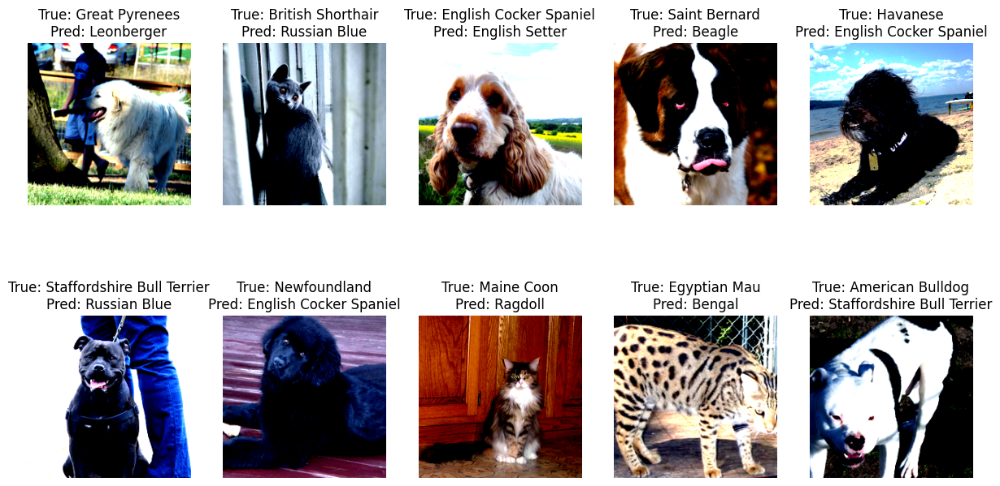

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


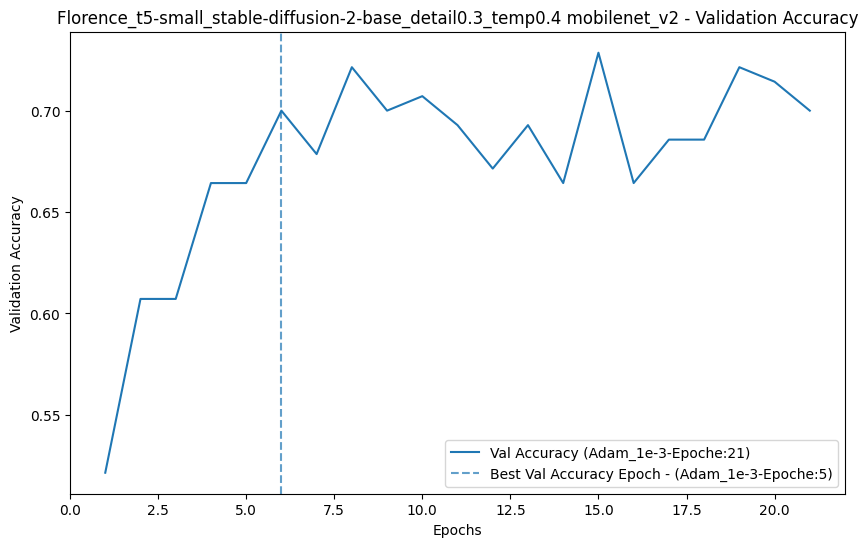

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


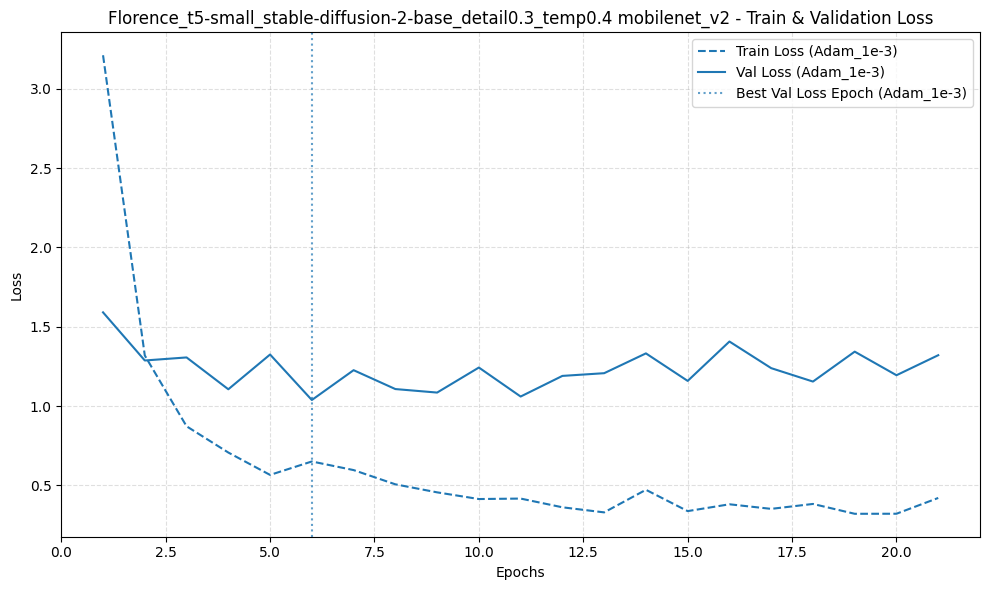

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


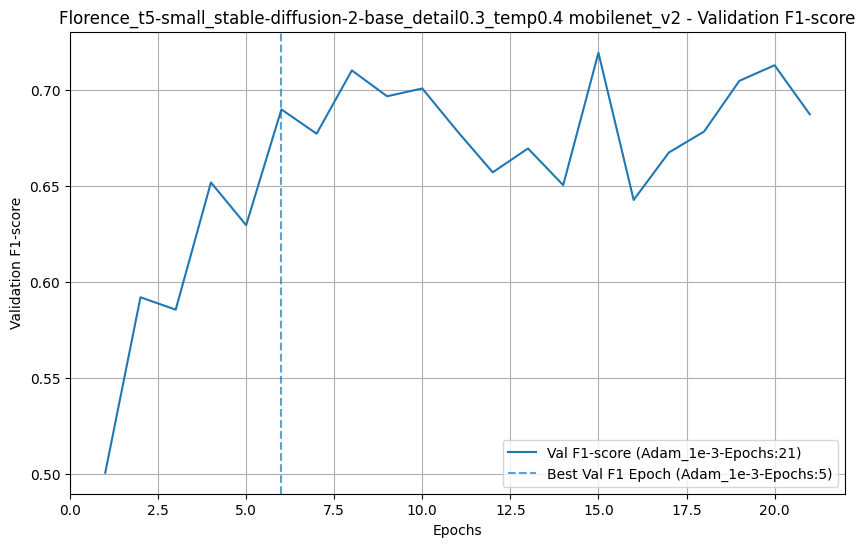

 
Training Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 model resnet18 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:   3%|▎         | 1/30 [00:05<02:49,  5.85s/it]

Epoch 1/30, F1 score:0.2859, Train Loss: 3.4888, Val Loss: 3.2122, Val Acc: 0.3429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.96it/s]


test



Training Progress:   7%|▋         | 2/30 [00:11<02:45,  5.92s/it]

Epoch 2/30, F1 score:0.5340, Train Loss: 2.9879, Val Loss: 2.2624, Val Acc: 0.5714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  10%|█         | 3/30 [00:17<02:39,  5.92s/it]

Epoch 3/30, F1 score:0.6763, Train Loss: 2.3573, Val Loss: 1.3098, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:23<02:31,  5.83s/it]

Epoch 4/30, F1 score:0.6010, Train Loss: 1.7750, Val Loss: 1.4609, Val Acc: 0.6286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.05it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:29<02:25,  5.83s/it]

Epoch 5/30, F1 score:0.7744, Train Loss: 1.3997, Val Loss: 0.8947, Val Acc: 0.7857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.00it/s]


test



Training Progress:  20%|██        | 6/30 [00:35<02:20,  5.86s/it]

Epoch 6/30, F1 score:0.7083, Train Loss: 1.0745, Val Loss: 0.8782, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.07it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:40<02:13,  5.80s/it]

Epoch 7/30, F1 score:0.6931, Train Loss: 0.9526, Val Loss: 0.9147, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:46<02:07,  5.80s/it]

Epoch 8/30, F1 score:0.7295, Train Loss: 0.7732, Val Loss: 0.7211, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  30%|███       | 9/30 [00:52<02:00,  5.75s/it]

Epoch 9/30, F1 score:0.7078, Train Loss: 0.7461, Val Loss: 0.8015, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.94it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:58<01:56,  5.83s/it]

Epoch 10/30, F1 score:0.7163, Train Loss: 0.7396, Val Loss: 0.8744, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:04<01:50,  5.81s/it]

Epoch 11/30, F1 score:0.7793, Train Loss: 0.6100, Val Loss: 0.7121, Val Acc: 0.7857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.01it/s]


test



Training Progress:  40%|████      | 12/30 [01:09<01:44,  5.83s/it]

Epoch 12/30, F1 score:0.6979, Train Loss: 0.6066, Val Loss: 0.8297, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:15<01:38,  5.81s/it]

Epoch 13/30, F1 score:0.7116, Train Loss: 0.5085, Val Loss: 0.7284, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.14it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:21<01:31,  5.74s/it]

Epoch 14/30, F1 score:0.6700, Train Loss: 0.5250, Val Loss: 0.7824, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.12it/s]


test



Training Progress:  50%|█████     | 15/30 [01:26<01:25,  5.71s/it]

Epoch 15/30, F1 score:0.6740, Train Loss: 0.5222, Val Loss: 0.8210, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.07it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:32<01:20,  5.72s/it]

Epoch 16/30, F1 score:0.7192, Train Loss: 0.4514, Val Loss: 0.7882, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:38<01:14,  5.73s/it]

Epoch 17/30, F1 score:0.7383, Train Loss: 0.3790, Val Loss: 0.7779, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]


test



Training Progress:  60%|██████    | 18/30 [01:44<01:08,  5.73s/it]

Epoch 18/30, F1 score:0.7598, Train Loss: 0.3948, Val Loss: 0.6745, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:49<01:02,  5.70s/it]

Epoch 19/30, F1 score:0.7318, Train Loss: 0.3842, Val Loss: 0.8231, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  67%|██████▋   | 20/30 [01:55<00:56,  5.68s/it]

Epoch 20/30, F1 score:0.6795, Train Loss: 0.4595, Val Loss: 0.8813, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.02it/s]


test



Training Progress:  70%|███████   | 21/30 [02:01<00:51,  5.70s/it]

Epoch 21/30, F1 score:0.6818, Train Loss: 0.4165, Val Loss: 0.8127, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:  73%|███████▎  | 22/30 [02:06<00:45,  5.68s/it]

Epoch 22/30, F1 score:0.6992, Train Loss: 0.4277, Val Loss: 0.8007, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  77%|███████▋  | 23/30 [02:12<00:39,  5.69s/it]

Epoch 23/30, F1 score:0.6736, Train Loss: 0.3693, Val Loss: 1.0242, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.00it/s]


test



Training Progress:  80%|████████  | 24/30 [02:18<00:34,  5.72s/it]

Epoch 24/30, F1 score:0.7200, Train Loss: 0.3902, Val Loss: 0.8606, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  83%|████████▎ | 25/30 [02:23<00:28,  5.69s/it]

Epoch 25/30, F1 score:0.7370, Train Loss: 0.4266, Val Loss: 0.7763, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:04<00:00,  3.20it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:29<00:22,  5.62s/it]

Epoch 26/30, F1 score:0.6857, Train Loss: 0.4383, Val Loss: 1.0442, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  90%|█████████ | 27/30 [02:35<00:16,  5.66s/it]

Epoch 27/30, F1 score:0.7016, Train Loss: 0.3917, Val Loss: 1.1583, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.96it/s]


test



Training Progress:  93%|█████████▎| 28/30 [02:41<00:11,  5.74s/it]

Epoch 28/30, F1 score:0.7032, Train Loss: 0.4360, Val Loss: 0.9582, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.03it/s]


test



Training Progress:  97%|█████████▋| 29/30 [02:46<00:05,  5.78s/it]

Epoch 29/30, F1 score:0.6561, Train Loss: 0.4066, Val Loss: 1.1018, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress: 100%|██████████| 30/30 [02:52<00:00,  5.75s/it]


Epoch 30/30, F1 score:0.6957, Train Loss: 0.3789, Val Loss: 1.0236, Val Acc: 0.7214
Model salvato in Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 resnet18/model.pt
Log salvato in: models/Florence_t5-small_stable-diffusion-2-base_detail0.3_temp0.4 resnet18/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 11.34it/s]


              precision    recall  f1-score   support

           0     0.8000    1.0000    0.8889         4
           1     0.6667    0.5000    0.5714         4
           2     1.0000    0.2500    0.4000         4
           3     1.0000    0.5000    0.6667         4
           4     0.6667    1.0000    0.8000         4
           5     0.7500    0.7500    0.7500         4
           6     0.5714    1.0000    0.7273         4
           7     0.7500    0.7500    0.7500         4
           8     0.5000    0.7500    0.6000         4
           9     0.3333    0.7500    0.4615         4
          10     1.0000    0.5000    0.6667         4
          11     1.0000    0.7500    0.8571         4
          12     1.0000    0.5000    0.6667         4
          13     0.4444    1.0000    0.6154         4
          14     1.0000    0.5000    0.6667         4
          15     1.0000    0.5000    0.6667         4
          16     1.0000    0.5000    0.6667         4
          17     0.5000    

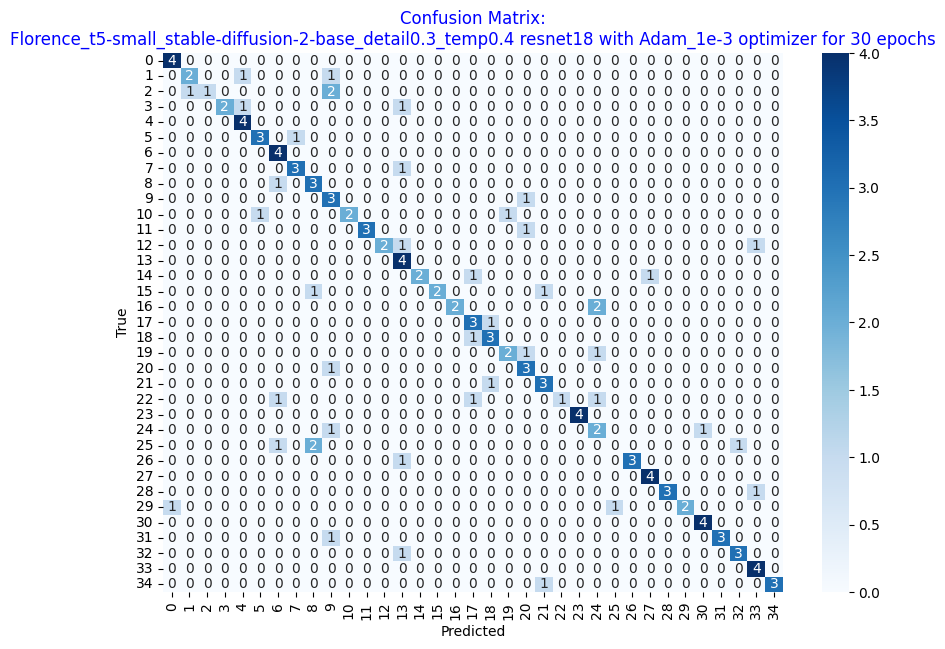


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


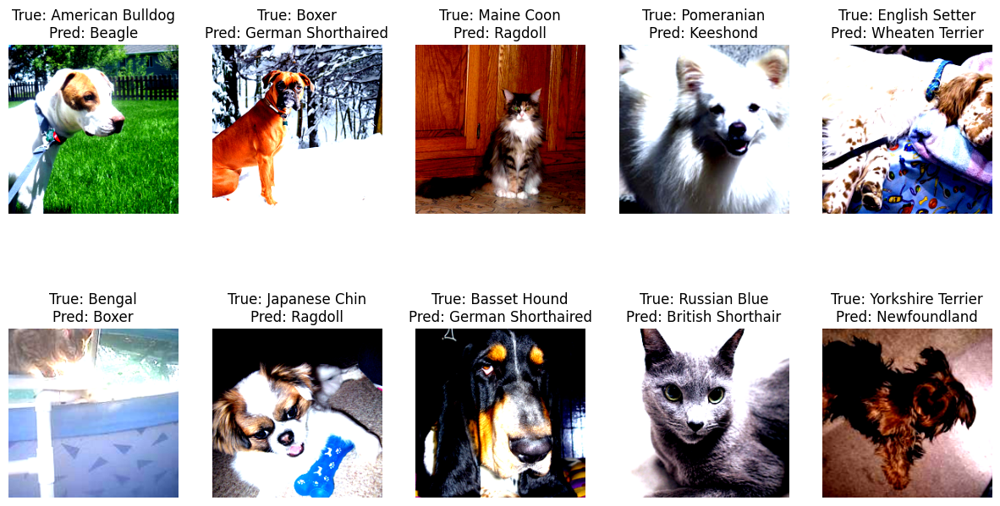

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


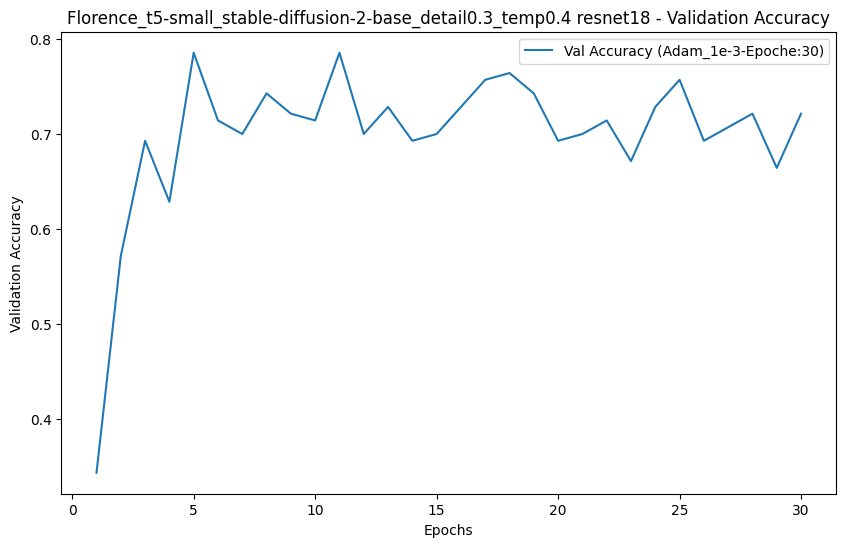

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


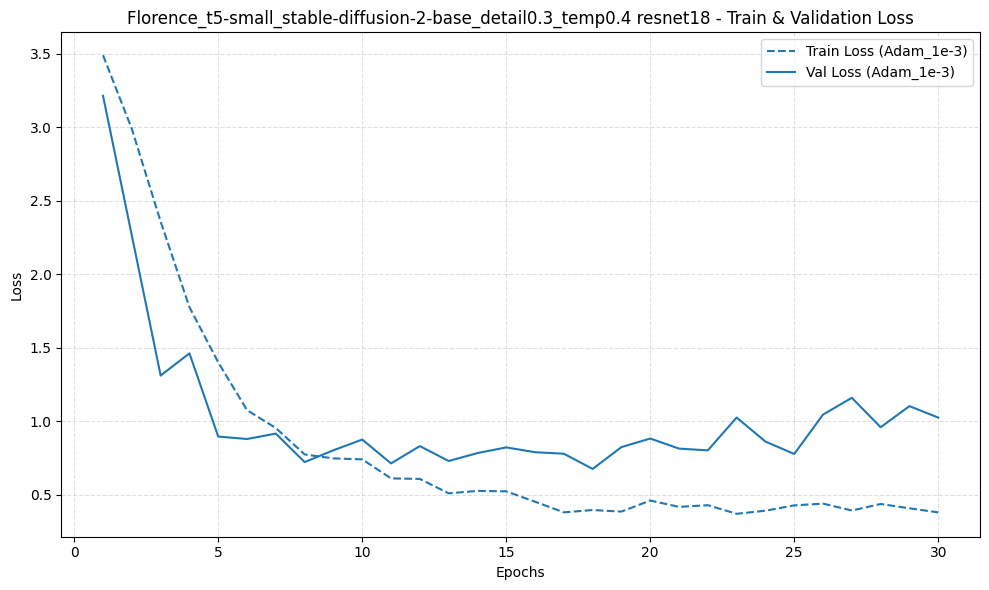

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


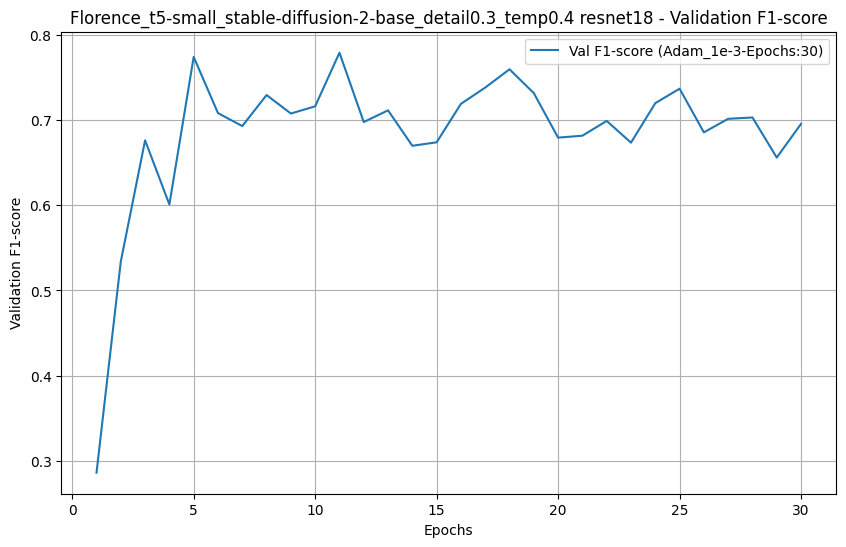

 
Training Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:   3%|▎         | 1/30 [00:06<02:59,  6.19s/it]

Epoch 1/30, F1 score:0.5677, Train Loss: 3.1953, Val Loss: 1.5152, Val Acc: 0.5786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:   7%|▋         | 2/30 [00:12<02:53,  6.19s/it]

Epoch 2/30, F1 score:0.6642, Train Loss: 1.3499, Val Loss: 1.0119, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.81it/s]


test



Training Progress:  10%|█         | 3/30 [00:18<02:47,  6.22s/it]

Epoch 3/30, F1 score:0.7141, Train Loss: 0.9550, Val Loss: 0.9610, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.82it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:24<02:42,  6.26s/it]

Epoch 4/30, F1 score:0.7409, Train Loss: 0.7367, Val Loss: 0.8437, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.75it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:31<02:37,  6.28s/it]

Epoch 5/30, F1 score:0.6968, Train Loss: 0.6168, Val Loss: 0.9960, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.74it/s]


test



Training Progress:  20%|██        | 6/30 [00:37<02:31,  6.32s/it]

Epoch 6/30, F1 score:0.7368, Train Loss: 0.5350, Val Loss: 1.0447, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.75it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:43<02:25,  6.32s/it]

Epoch 7/30, F1 score:0.7216, Train Loss: 0.4662, Val Loss: 1.0317, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.87it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:50<02:17,  6.24s/it]

Epoch 8/30, F1 score:0.7235, Train Loss: 0.4875, Val Loss: 1.0814, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.80it/s]


test



Training Progress:  30%|███       | 9/30 [00:56<02:11,  6.24s/it]

Epoch 9/30, F1 score:0.7078, Train Loss: 0.3697, Val Loss: 1.0717, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.83it/s]


test



Training Progress:  33%|███▎      | 10/30 [01:02<02:04,  6.24s/it]

Epoch 10/30, F1 score:0.7206, Train Loss: 0.4025, Val Loss: 1.0993, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.80it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:08<01:58,  6.24s/it]

Epoch 11/30, F1 score:0.6689, Train Loss: 0.5036, Val Loss: 1.1278, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.81it/s]


test



Training Progress:  40%|████      | 12/30 [01:15<01:52,  6.24s/it]

Epoch 12/30, F1 score:0.7387, Train Loss: 0.3165, Val Loss: 1.1235, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.78it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:21<01:46,  6.25s/it]

Epoch 13/30, F1 score:0.7048, Train Loss: 0.3995, Val Loss: 1.0580, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.76it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:27<01:40,  6.29s/it]

Epoch 14/30, F1 score:0.6668, Train Loss: 0.4515, Val Loss: 1.2150, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.76it/s]


test



Training Progress:  50%|█████     | 15/30 [01:33<01:34,  6.29s/it]

Epoch 15/30, F1 score:0.6788, Train Loss: 0.3511, Val Loss: 1.2128, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.72it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:40<01:28,  6.33s/it]

Epoch 16/30, F1 score:0.7110, Train Loss: 0.3466, Val Loss: 1.0735, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.85it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:46<01:21,  6.29s/it]

Epoch 17/30, F1 score:0.6813, Train Loss: 0.3516, Val Loss: 1.0610, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.78it/s]


test



Training Progress:  60%|██████    | 18/30 [01:52<01:15,  6.28s/it]

Epoch 18/30, F1 score:0.6996, Train Loss: 0.3327, Val Loss: 1.0573, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.84it/s]


test



Training Progress:  60%|██████    | 18/30 [01:58<01:19,  6.61s/it]


Epoch 19/30, F1 score:0.6406, Train Loss: 0.3609, Val Loss: 1.5365, Val Acc: 0.6500
Modello salvato in models/Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 mobilenet_v2
Early stopping
Log salvato in: models/Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 mobilenet_v2/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 10.25it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize(

              precision    recall  f1-score   support

           0     0.6000    0.7500    0.6667         4
           1     0.3750    0.7500    0.5000         4
           2     0.6000    0.7500    0.6667         4
           3     0.7500    0.7500    0.7500         4
           4     0.2222    0.5000    0.3077         4
           5     0.7500    0.7500    0.7500         4
           6     0.7500    0.7500    0.7500         4
           7     1.0000    0.5000    0.6667         4
           8     0.7500    0.7500    0.7500         4
           9     0.0000    0.0000    0.0000         4
          10     1.0000    0.7500    0.8571         4
          11     0.5000    0.2500    0.3333         4
          12     0.5000    0.2500    0.3333         4
          13     0.4000    0.5000    0.4444         4
          14     1.0000    0.7500    0.8571         4
          15     0.5000    0.5000    0.5000         4
          16     0.7500    0.7500    0.7500         4
          17     1.0000    

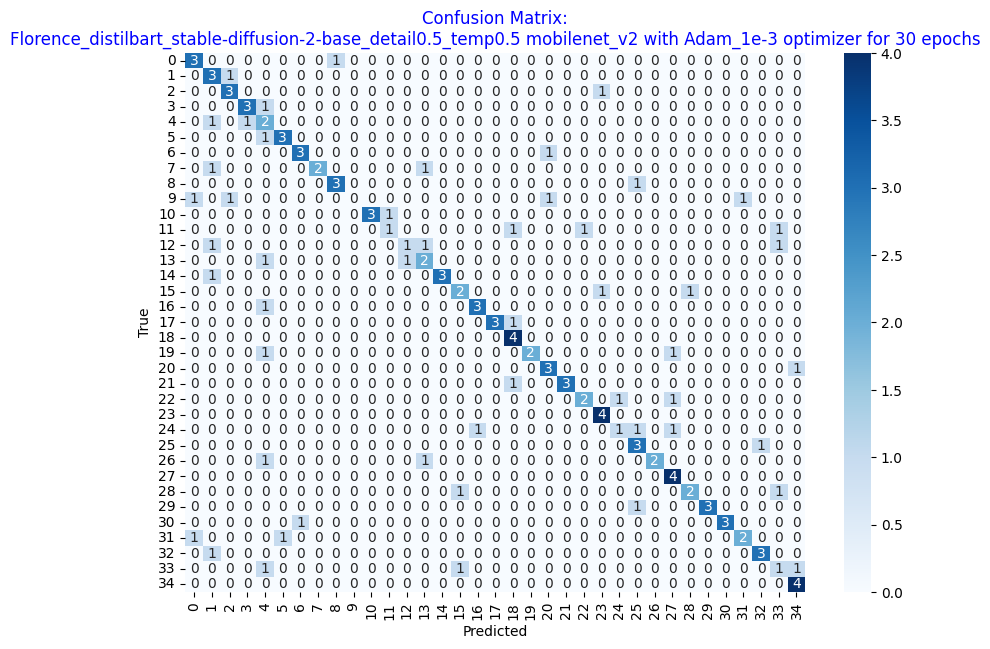


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


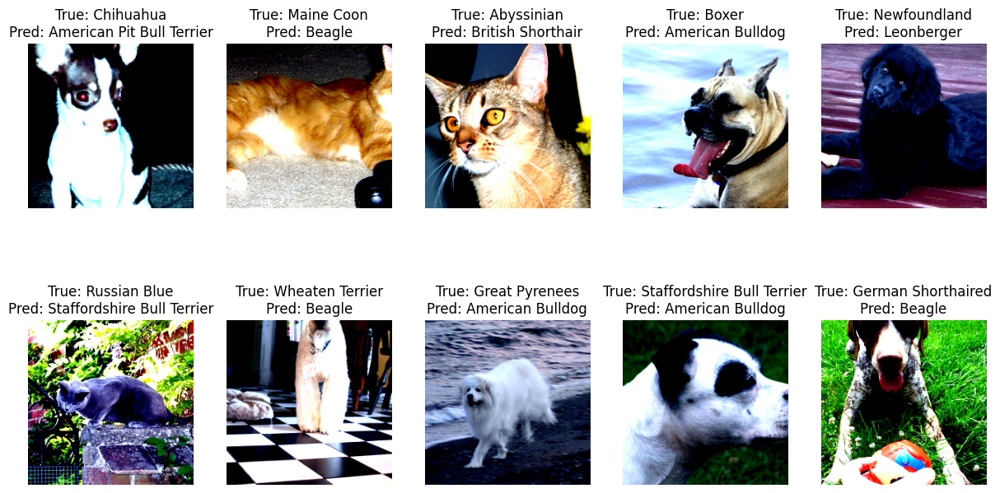

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


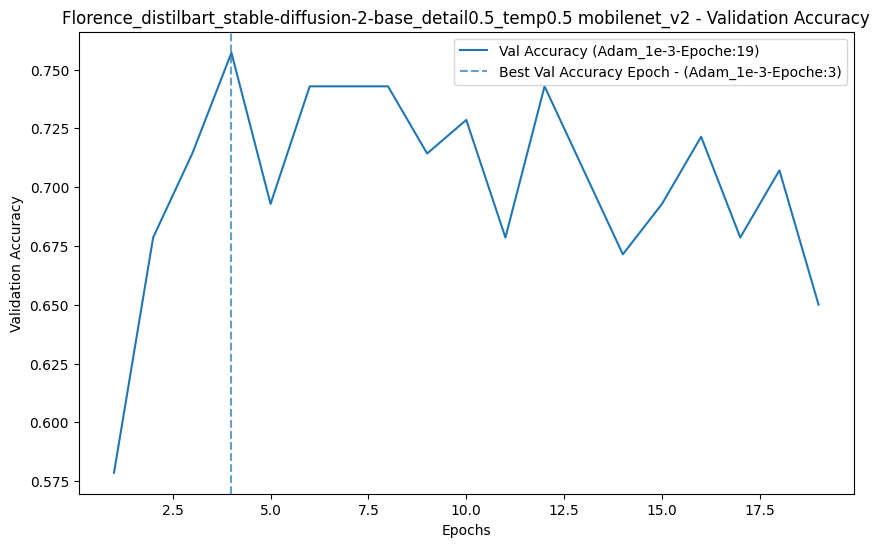

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


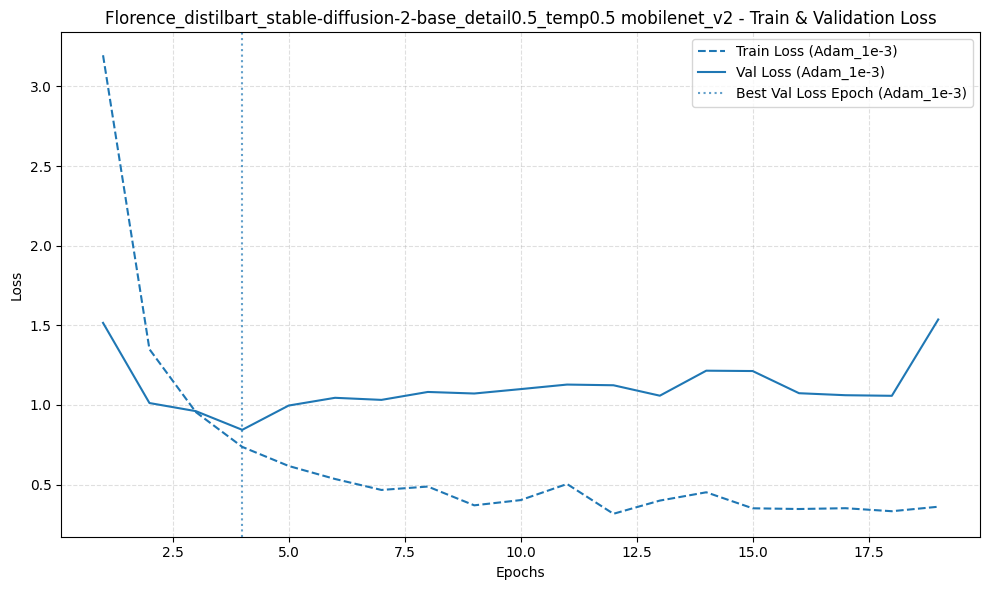

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


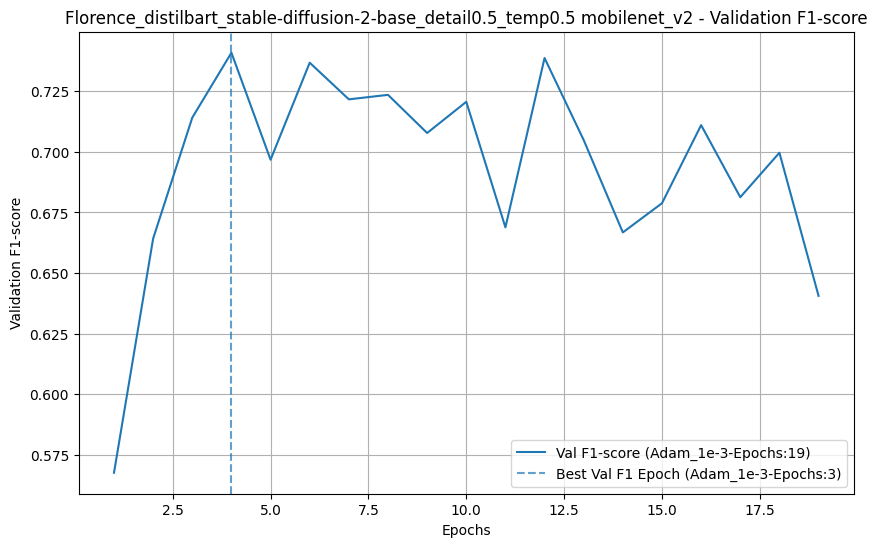

 
Training Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 model resnet18 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.93it/s]


test



Training Progress:   3%|▎         | 1/30 [00:05<02:53,  6.00s/it]

Epoch 1/30, F1 score:0.2996, Train Loss: 3.5043, Val Loss: 3.2025, Val Acc: 0.3571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.93it/s]


test



Training Progress:   7%|▋         | 2/30 [00:12<02:49,  6.06s/it]

Epoch 2/30, F1 score:0.5224, Train Loss: 3.0394, Val Loss: 2.2668, Val Acc: 0.5643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  10%|█         | 3/30 [00:17<02:40,  5.96s/it]

Epoch 3/30, F1 score:0.6255, Train Loss: 2.3488, Val Loss: 1.4430, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:23<02:34,  5.94s/it]

Epoch 4/30, F1 score:0.7106, Train Loss: 1.7604, Val Loss: 1.1832, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:29<02:27,  5.90s/it]

Epoch 5/30, F1 score:0.7115, Train Loss: 1.3592, Val Loss: 1.0130, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.99it/s]


test



Training Progress:  20%|██        | 6/30 [00:35<02:21,  5.91s/it]

Epoch 6/30, F1 score:0.7562, Train Loss: 1.1202, Val Loss: 0.8193, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.96it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:41<02:16,  5.94s/it]

Epoch 7/30, F1 score:0.7536, Train Loss: 0.8879, Val Loss: 0.7855, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.16it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:47<02:08,  5.82s/it]

Epoch 8/30, F1 score:0.7416, Train Loss: 0.7778, Val Loss: 0.8002, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.09it/s]


test



Training Progress:  30%|███       | 9/30 [00:52<02:01,  5.78s/it]

Epoch 9/30, F1 score:0.7366, Train Loss: 0.8001, Val Loss: 0.9220, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.07it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:58<01:56,  5.83s/it]

Epoch 10/30, F1 score:0.7740, Train Loss: 0.6907, Val Loss: 0.7495, Val Acc: 0.7786
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.96it/s]


test



Training Progress:  37%|███▋      | 11/30 [01:04<01:51,  5.85s/it]

Epoch 11/30, F1 score:0.7292, Train Loss: 0.6316, Val Loss: 0.8087, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.14it/s]


test



Training Progress:  40%|████      | 12/30 [01:10<01:43,  5.76s/it]

Epoch 12/30, F1 score:0.7588, Train Loss: 0.6875, Val Loss: 0.8067, Val Acc: 0.7714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:  43%|████▎     | 13/30 [01:15<01:37,  5.75s/it]

Epoch 13/30, F1 score:0.7660, Train Loss: 0.5985, Val Loss: 0.7236, Val Acc: 0.7714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.15it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:21<01:30,  5.69s/it]

Epoch 14/30, F1 score:0.7530, Train Loss: 0.4431, Val Loss: 0.7512, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.14it/s]


test



Training Progress:  50%|█████     | 15/30 [01:27<01:24,  5.65s/it]

Epoch 15/30, F1 score:0.6870, Train Loss: 0.4995, Val Loss: 0.8754, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.95it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:33<01:20,  5.76s/it]

Epoch 16/30, F1 score:0.7419, Train Loss: 0.4661, Val Loss: 0.8486, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.04it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:38<01:14,  5.75s/it]

Epoch 17/30, F1 score:0.7392, Train Loss: 0.4194, Val Loss: 0.7638, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.07it/s]


test



Training Progress:  60%|██████    | 18/30 [01:44<01:09,  5.75s/it]

Epoch 18/30, F1 score:0.7442, Train Loss: 0.3941, Val Loss: 0.7595, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:50<01:03,  5.76s/it]

Epoch 19/30, F1 score:0.6583, Train Loss: 0.3935, Val Loss: 0.9099, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.02it/s]


test



Training Progress:  67%|██████▋   | 20/30 [01:56<00:57,  5.77s/it]

Epoch 20/30, F1 score:0.7770, Train Loss: 0.3862, Val Loss: 0.7461, Val Acc: 0.7857
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.10it/s]


test



Training Progress:  70%|███████   | 21/30 [02:01<00:51,  5.73s/it]

Epoch 21/30, F1 score:0.7474, Train Loss: 0.3976, Val Loss: 0.7868, Val Acc: 0.7571
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.05it/s]


test



Training Progress:  73%|███████▎  | 22/30 [02:07<00:45,  5.72s/it]

Epoch 22/30, F1 score:0.7091, Train Loss: 0.3737, Val Loss: 0.9897, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


test



Training Progress:  77%|███████▋  | 23/30 [02:13<00:39,  5.69s/it]

Epoch 23/30, F1 score:0.7197, Train Loss: 0.4270, Val Loss: 0.8768, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.96it/s]


test



Training Progress:  80%|████████  | 24/30 [02:18<00:34,  5.74s/it]

Epoch 24/30, F1 score:0.6425, Train Loss: 0.3395, Val Loss: 0.9399, Val Acc: 0.6500
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  2.97it/s]


test



Training Progress:  83%|████████▎ | 25/30 [02:24<00:29,  5.81s/it]

Epoch 25/30, F1 score:0.7351, Train Loss: 0.4143, Val Loss: 0.8811, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.01it/s]


test



Training Progress:  87%|████████▋ | 26/30 [02:30<00:23,  5.80s/it]

Epoch 26/30, F1 score:0.7331, Train Loss: 0.3640, Val Loss: 0.8316, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.09it/s]


test



Training Progress:  90%|█████████ | 27/30 [02:36<00:17,  5.77s/it]

Epoch 27/30, F1 score:0.7564, Train Loss: 0.3658, Val Loss: 0.8860, Val Acc: 0.7643
train



Train_epoch in progress: 100%|██████████| 16/16 [00:05<00:00,  3.02it/s]


test



Training Progress:  90%|█████████ | 27/30 [02:42<00:18,  6.01s/it]


Epoch 28/30, F1 score:0.7012, Train Loss: 0.4251, Val Loss: 1.0216, Val Acc: 0.7000
Modello salvato in models/Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 resnet18
Early stopping
Log salvato in: models/Florence_distilbart_stable-diffusion-2-base_detail0.5_temp0.5 resnet18/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 11.12it/s]


              precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000         4
           1     0.6667    0.5000    0.5714         4
           2     0.6667    1.0000    0.8000         4
           3     0.5000    0.7500    0.6000         4
           4     0.3333    0.2500    0.2857         4
           5     0.6000    0.7500    0.6667         4
           6     0.8000    1.0000    0.8889         4
           7     0.5000    0.5000    0.5000         4
           8     0.6667    0.5000    0.5714         4
           9     1.0000    0.2500    0.4000         4
          10     1.0000    0.2500    0.4000         4
          11     0.4286    0.7500    0.5455         4
          12     0.6667    0.5000    0.5714         4
          13     0.6667    1.0000    0.8000         4
          14     1.0000    0.7500    0.8571         4
          15     0.6667    0.5000    0.5714         4
          16     1.0000    1.0000    1.0000         4
          17     1.0000    

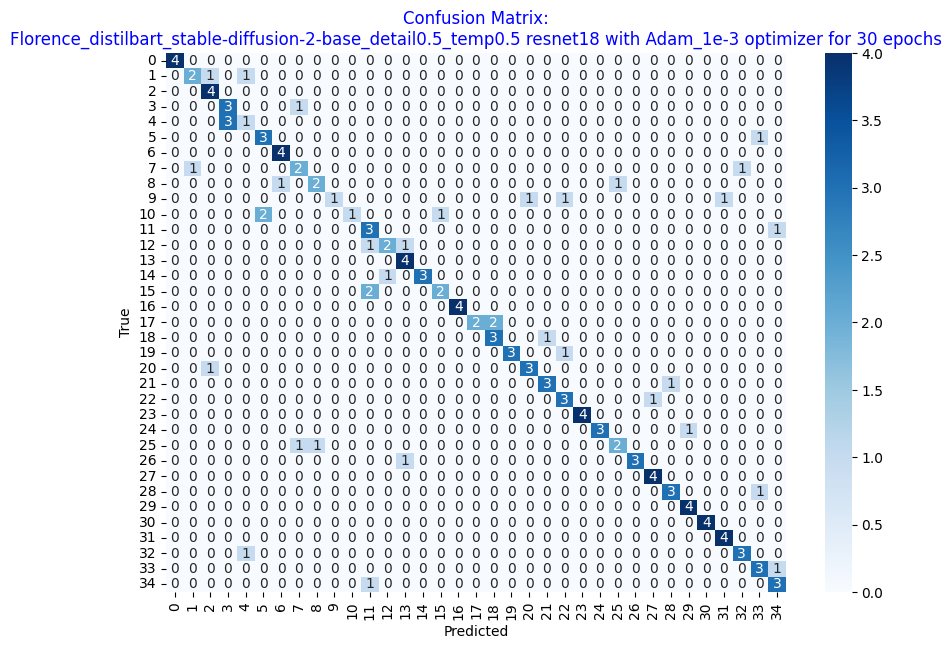


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


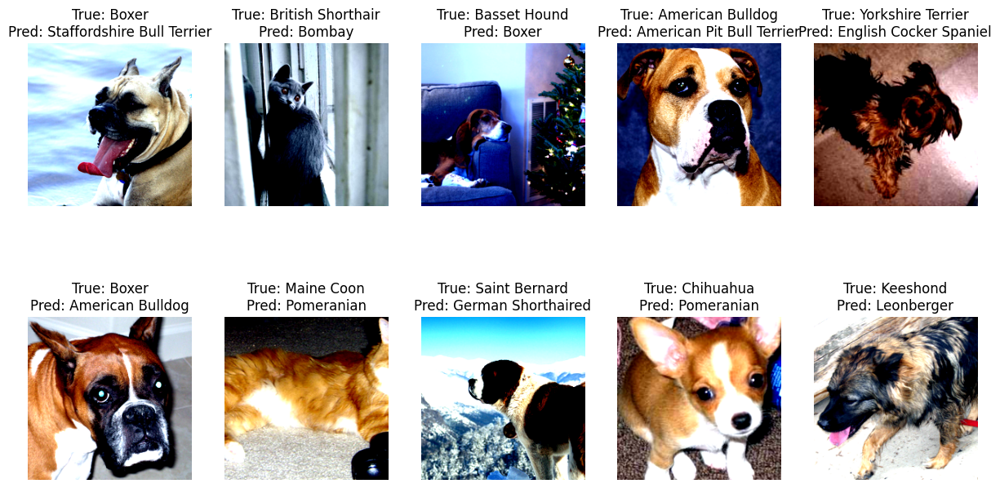

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


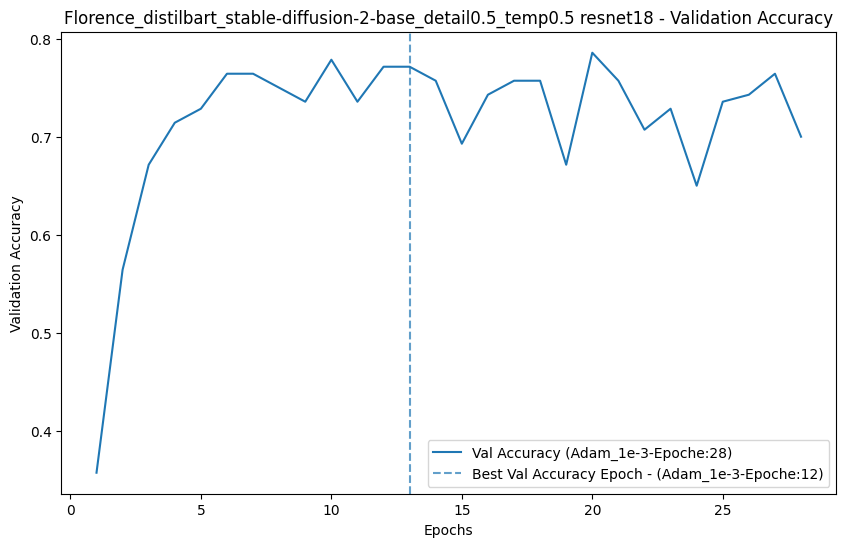

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


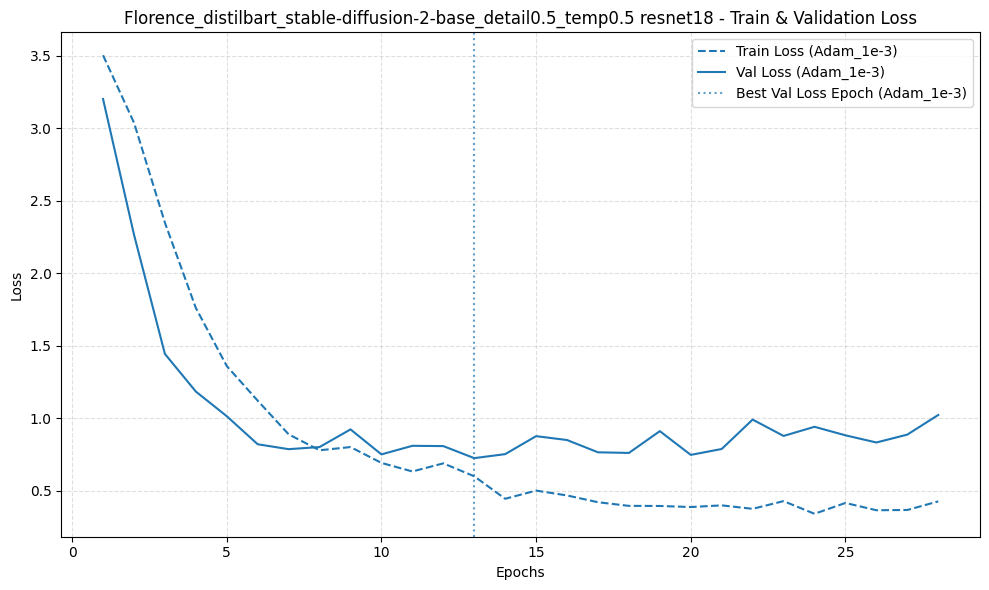

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


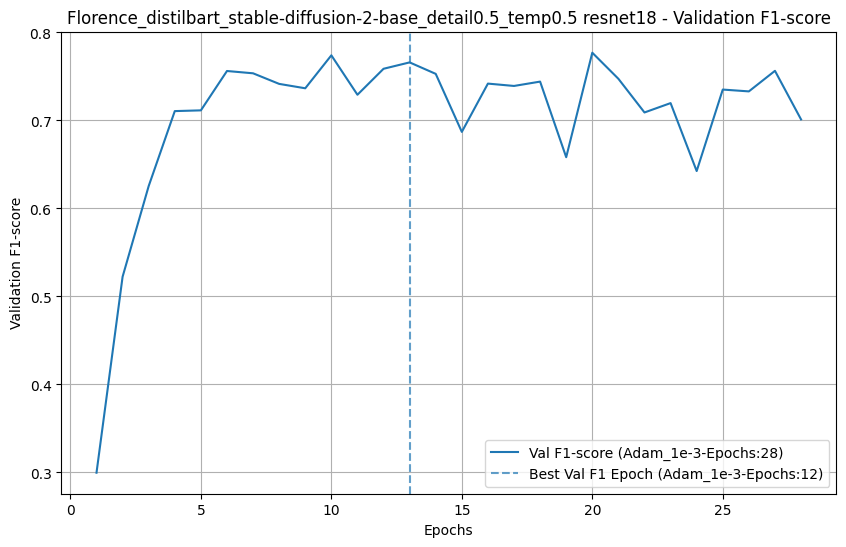

 
Training not_augmented_dataset model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.62it/s]


test



Training Progress:   3%|▎         | 1/30 [00:04<02:19,  4.82s/it]

Epoch 1/30, F1 score:0.3767, Train Loss: 3.3539, Val Loss: 2.0837, Val Acc: 0.4214
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.78it/s]


test



Training Progress:   7%|▋         | 2/30 [00:09<02:10,  4.67s/it]

Epoch 2/30, F1 score:0.5510, Train Loss: 1.5964, Val Loss: 1.3860, Val Acc: 0.5714
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.71it/s]


test



Training Progress:  10%|█         | 3/30 [00:14<02:05,  4.65s/it]

Epoch 3/30, F1 score:0.6674, Train Loss: 0.8825, Val Loss: 1.0305, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.69it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:18<02:01,  4.67s/it]

Epoch 4/30, F1 score:0.7061, Train Loss: 0.6875, Val Loss: 0.9621, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.73it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:23<01:55,  4.62s/it]

Epoch 5/30, F1 score:0.6391, Train Loss: 0.5881, Val Loss: 1.0501, Val Acc: 0.6571
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.81it/s]


test



Training Progress:  20%|██        | 6/30 [00:27<01:49,  4.55s/it]

Epoch 6/30, F1 score:0.6056, Train Loss: 0.5982, Val Loss: 1.1826, Val Acc: 0.6286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.69it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:32<01:44,  4.56s/it]

Epoch 7/30, F1 score:0.6539, Train Loss: 0.4246, Val Loss: 1.1618, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.75it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:36<01:40,  4.55s/it]

Epoch 8/30, F1 score:0.6520, Train Loss: 0.4306, Val Loss: 1.0636, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.64it/s]


test



Training Progress:  30%|███       | 9/30 [00:41<01:36,  4.61s/it]

Epoch 9/30, F1 score:0.6782, Train Loss: 0.4030, Val Loss: 1.1410, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.70it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:46<01:32,  4.61s/it]

Epoch 10/30, F1 score:0.6740, Train Loss: 0.2857, Val Loss: 1.1407, Val Acc: 0.6929
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.69it/s]


test



Training Progress:  37%|███▋      | 11/30 [00:50<01:27,  4.60s/it]

Epoch 11/30, F1 score:0.6928, Train Loss: 0.3007, Val Loss: 1.1164, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.75it/s]


test



Training Progress:  40%|████      | 12/30 [00:55<01:22,  4.59s/it]

Epoch 12/30, F1 score:0.6893, Train Loss: 0.2914, Val Loss: 1.1711, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.86it/s]


test



Training Progress:  43%|████▎     | 13/30 [00:59<01:16,  4.52s/it]

Epoch 13/30, F1 score:0.6488, Train Loss: 0.2501, Val Loss: 1.1796, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.72it/s]


test



Training Progress:  47%|████▋     | 14/30 [01:04<01:12,  4.52s/it]

Epoch 14/30, F1 score:0.6719, Train Loss: 0.2676, Val Loss: 1.2416, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.68it/s]


test



Training Progress:  50%|█████     | 15/30 [01:08<01:08,  4.55s/it]

Epoch 15/30, F1 score:0.6532, Train Loss: 0.3140, Val Loss: 1.2018, Val Acc: 0.6786
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.78it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:13<01:03,  4.52s/it]

Epoch 16/30, F1 score:0.6528, Train Loss: 0.2994, Val Loss: 1.3262, Val Acc: 0.6643
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.69it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:17<00:59,  4.55s/it]

Epoch 17/30, F1 score:0.6353, Train Loss: 0.3326, Val Loss: 1.4695, Val Acc: 0.6429
train



Train_epoch in progress: 100%|██████████| 11/11 [00:04<00:00,  2.70it/s]


test



Training Progress:  60%|██████    | 18/30 [01:22<00:55,  4.59s/it]

Epoch 18/30, F1 score:0.6168, Train Loss: 0.2470, Val Loss: 1.4743, Val Acc: 0.6286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.84it/s]


test



Training Progress:  60%|██████    | 18/30 [01:26<00:57,  4.83s/it]


Epoch 19/30, F1 score:0.6108, Train Loss: 0.2153, Val Loss: 1.5176, Val Acc: 0.6214
Modello salvato in models/not_augmented_dataset mobilenet_v2
Early stopping
Log salvato in: models/not_augmented_dataset mobilenet_v2/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 10.41it/s]


              precision    recall  f1-score   support

           0     1.0000    0.5000    0.6667         4
           1     0.6667    0.5000    0.5714         4
           2     1.0000    0.2500    0.4000         4
           3     0.5000    0.5000    0.5000         4
           4     0.4000    0.5000    0.4444         4
           5     0.7500    0.7500    0.7500         4
           6     0.6667    1.0000    0.8000         4
           7     0.6000    0.7500    0.6667         4
           8     0.4286    0.7500    0.5455         4
           9     0.3333    0.2500    0.2857         4
          10     1.0000    0.7500    0.8571         4
          11     0.6000    0.7500    0.6667         4
          12     0.6000    0.7500    0.6667         4
          13     0.4000    0.5000    0.4444         4
          14     1.0000    0.7500    0.8571         4
          15     0.6667    0.5000    0.5714         4
          16     0.8000    1.0000    0.8889         4
          17     1.0000    

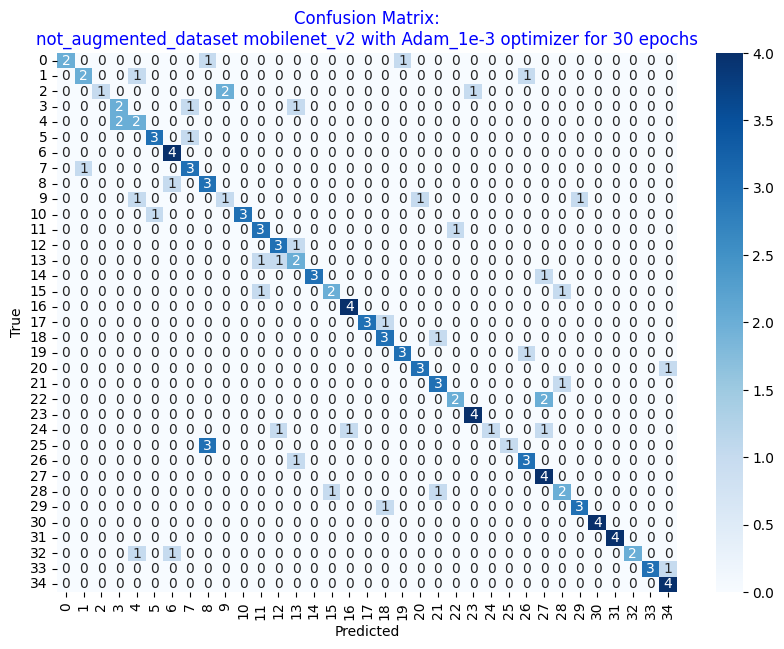


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


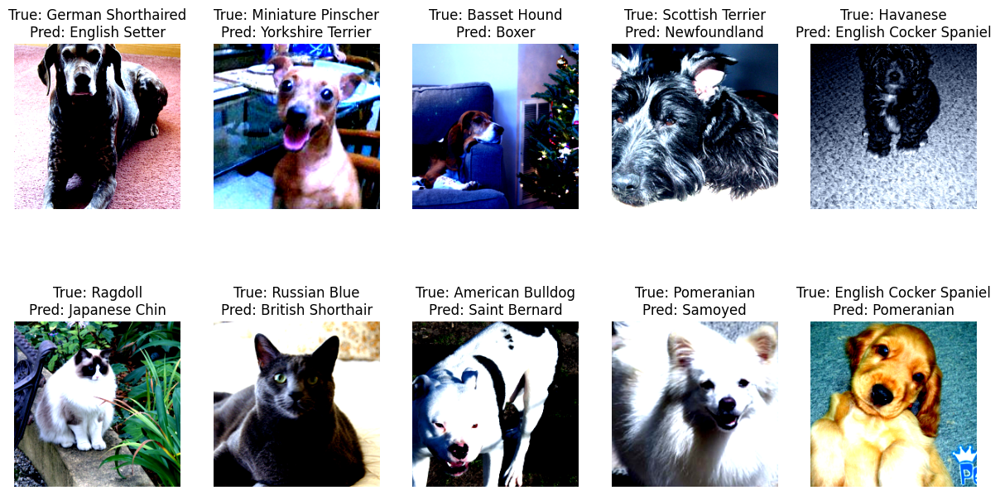

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


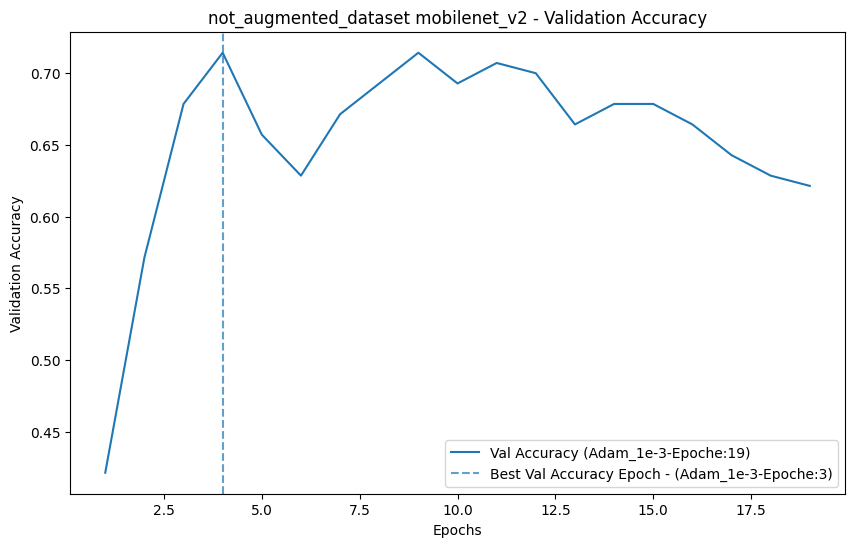

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


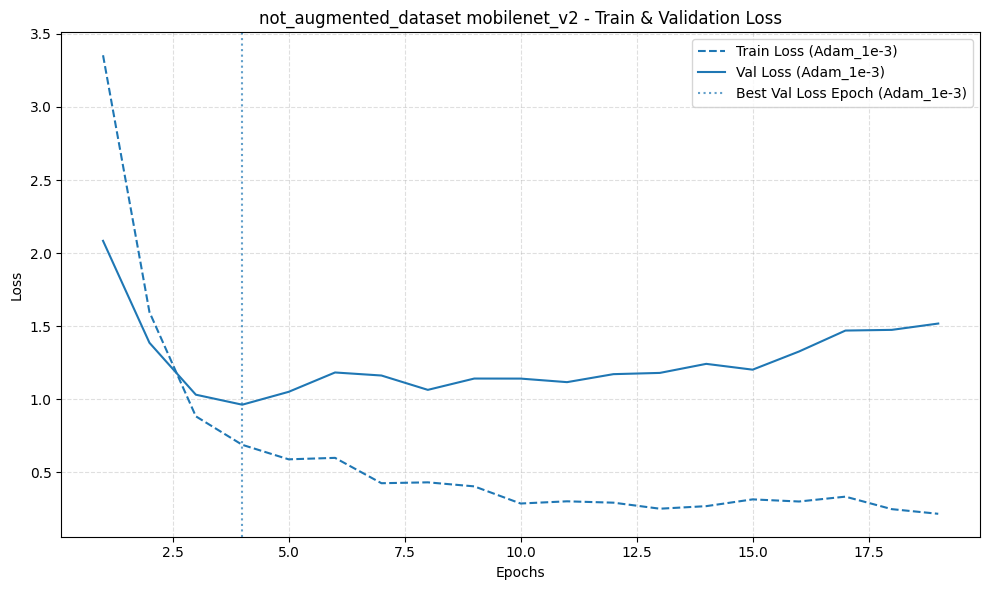

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


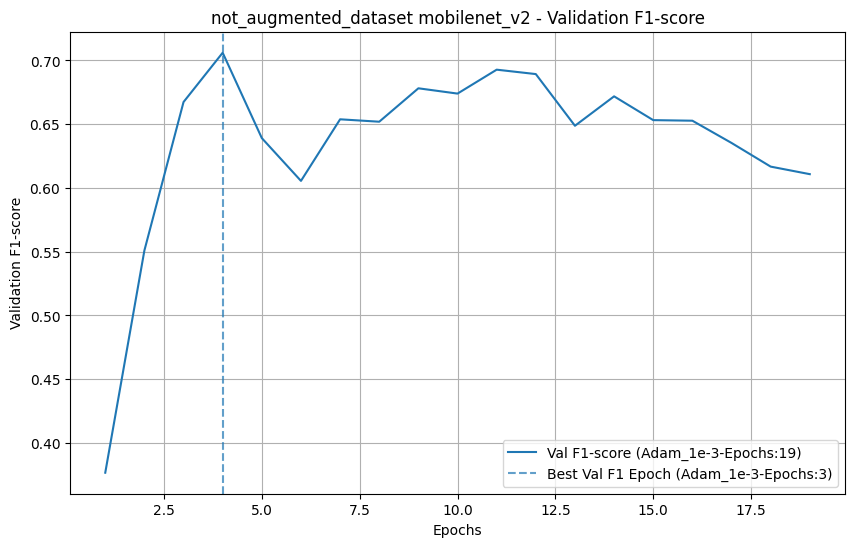

 
Training not_augmented_dataset model resnet18 with Adam_1e-3 optimizer for 30 epochs
traintain


Training Progress:   0%|          | 0/30 [00:00<?, ?it/s]

train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.05it/s]


test



Training Progress:   3%|▎         | 1/30 [00:04<02:01,  4.17s/it]

Epoch 1/30, F1 score:0.1154, Train Loss: 3.5547, Val Loss: 3.3892, Val Acc: 0.1714
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.05it/s]


test



Training Progress:   7%|▋         | 2/30 [00:08<01:56,  4.16s/it]

Epoch 2/30, F1 score:0.3723, Train Loss: 3.2924, Val Loss: 3.0213, Val Acc: 0.4143
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.97it/s]


test



Training Progress:  10%|█         | 3/30 [00:12<01:54,  4.25s/it]

Epoch 3/30, F1 score:0.5865, Train Loss: 2.8202, Val Loss: 2.1365, Val Acc: 0.6286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.01it/s]


test



Training Progress:  13%|█▎        | 4/30 [00:16<01:50,  4.25s/it]

Epoch 4/30, F1 score:0.5757, Train Loss: 2.2740, Val Loss: 1.4996, Val Acc: 0.6429
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.00it/s]


test



Training Progress:  17%|█▋        | 5/30 [00:21<01:46,  4.24s/it]

Epoch 5/30, F1 score:0.6484, Train Loss: 1.8072, Val Loss: 1.1550, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.02it/s]


test



Training Progress:  20%|██        | 6/30 [00:25<01:42,  4.26s/it]

Epoch 6/30, F1 score:0.7080, Train Loss: 1.5020, Val Loss: 1.0755, Val Acc: 0.7429
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.91it/s]


test



Training Progress:  23%|██▎       | 7/30 [00:29<01:37,  4.25s/it]

Epoch 7/30, F1 score:0.6758, Train Loss: 1.2215, Val Loss: 1.1186, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.94it/s]


test



Training Progress:  27%|██▋       | 8/30 [00:34<01:34,  4.29s/it]

Epoch 8/30, F1 score:0.7002, Train Loss: 0.9879, Val Loss: 0.9972, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.93it/s]


test



Training Progress:  30%|███       | 9/30 [00:38<01:30,  4.30s/it]

Epoch 9/30, F1 score:0.6873, Train Loss: 0.7985, Val Loss: 0.9286, Val Acc: 0.7000
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.89it/s]


test



Training Progress:  33%|███▎      | 10/30 [00:42<01:26,  4.32s/it]

Epoch 10/30, F1 score:0.6370, Train Loss: 0.7510, Val Loss: 0.9816, Val Acc: 0.6714
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.99it/s]


test



Training Progress:  37%|███▋      | 11/30 [00:46<01:21,  4.29s/it]

Epoch 11/30, F1 score:0.6848, Train Loss: 0.6942, Val Loss: 0.8822, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.94it/s]


test



Training Progress:  40%|████      | 12/30 [00:51<01:17,  4.30s/it]

Epoch 12/30, F1 score:0.7395, Train Loss: 0.5264, Val Loss: 0.8278, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.98it/s]


test



Training Progress:  43%|████▎     | 13/30 [00:55<01:12,  4.29s/it]

Epoch 13/30, F1 score:0.7333, Train Loss: 0.5282, Val Loss: 0.7576, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.08it/s]


test



Training Progress:  47%|████▋     | 14/30 [00:59<01:07,  4.21s/it]

Epoch 14/30, F1 score:0.7096, Train Loss: 0.4743, Val Loss: 0.8154, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.93it/s]


test



Training Progress:  50%|█████     | 15/30 [01:03<01:03,  4.22s/it]

Epoch 15/30, F1 score:0.7179, Train Loss: 0.4848, Val Loss: 0.8991, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.96it/s]


test



Training Progress:  53%|█████▎    | 16/30 [01:08<00:59,  4.23s/it]

Epoch 16/30, F1 score:0.7071, Train Loss: 0.4978, Val Loss: 0.9066, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.00it/s]


test



Training Progress:  57%|█████▋    | 17/30 [01:12<00:54,  4.20s/it]

Epoch 17/30, F1 score:0.7331, Train Loss: 0.4418, Val Loss: 0.7774, Val Acc: 0.7500
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.89it/s]


test



Training Progress:  60%|██████    | 18/30 [01:16<00:50,  4.22s/it]

Epoch 18/30, F1 score:0.7166, Train Loss: 0.4054, Val Loss: 0.9152, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.06it/s]


test



Training Progress:  63%|██████▎   | 19/30 [01:20<00:45,  4.16s/it]

Epoch 19/30, F1 score:0.6929, Train Loss: 0.3397, Val Loss: 0.8933, Val Acc: 0.7071
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.06it/s]


test



Training Progress:  67%|██████▋   | 20/30 [01:24<00:41,  4.15s/it]

Epoch 20/30, F1 score:0.6559, Train Loss: 0.3373, Val Loss: 0.9107, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.89it/s]


test



Training Progress:  70%|███████   | 21/30 [01:28<00:37,  4.19s/it]

Epoch 21/30, F1 score:0.7023, Train Loss: 0.4203, Val Loss: 0.8936, Val Acc: 0.7143
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.14it/s]


test



Training Progress:  73%|███████▎  | 22/30 [01:32<00:33,  4.13s/it]

Epoch 22/30, F1 score:0.7233, Train Loss: 0.4323, Val Loss: 0.8940, Val Acc: 0.7286
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.07it/s]


test



Training Progress:  77%|███████▋  | 23/30 [01:36<00:28,  4.11s/it]

Epoch 23/30, F1 score:0.7169, Train Loss: 0.3589, Val Loss: 0.9019, Val Acc: 0.7214
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.96it/s]


test



Training Progress:  80%|████████  | 24/30 [01:41<00:24,  4.13s/it]

Epoch 24/30, F1 score:0.6808, Train Loss: 0.3494, Val Loss: 0.8653, Val Acc: 0.6857
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.06it/s]


test



Training Progress:  83%|████████▎ | 25/30 [01:45<00:20,  4.13s/it]

Epoch 25/30, F1 score:0.7267, Train Loss: 0.2774, Val Loss: 0.7895, Val Acc: 0.7357
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.01it/s]


test



Training Progress:  87%|████████▋ | 26/30 [01:49<00:16,  4.16s/it]

Epoch 26/30, F1 score:0.6363, Train Loss: 0.2318, Val Loss: 0.9698, Val Acc: 0.6571
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  2.91it/s]


test



Training Progress:  90%|█████████ | 27/30 [01:53<00:12,  4.18s/it]

Epoch 27/30, F1 score:0.5808, Train Loss: 0.3621, Val Loss: 1.1218, Val Acc: 0.6000
train



Train_epoch in progress: 100%|██████████| 11/11 [00:03<00:00,  3.02it/s]


test



Training Progress:  90%|█████████ | 27/30 [01:57<00:13,  4.36s/it]


Epoch 28/30, F1 score:0.6141, Train Loss: 0.2777, Val Loss: 1.0394, Val Acc: 0.6571
Modello salvato in models/not_augmented_dataset resnet18
Early stopping
Log salvato in: models/not_augmented_dataset resnet18/log_experiment_1.json
test


Test_epoch in progress: 100%|██████████| 5/5 [00:00<00:00, 11.33it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize(

              precision    recall  f1-score   support

           0     0.6667    1.0000    0.8000         4
           1     0.0000    0.0000    0.0000         4
           2     0.5714    1.0000    0.7273         4
           3     1.0000    0.2500    0.4000         4
           4     0.4286    0.7500    0.5455         4
           5     0.5000    0.2500    0.3333         4
           6     0.6667    1.0000    0.8000         4
           7     0.6667    1.0000    0.8000         4
           8     1.0000    0.5000    0.6667         4
           9     0.5000    0.5000    0.5000         4
          10     1.0000    1.0000    1.0000         4
          11     0.7500    0.7500    0.7500         4
          12     0.5000    0.2500    0.3333         4
          13     0.5000    0.5000    0.5000         4
          14     1.0000    1.0000    1.0000         4
          15     0.6667    0.5000    0.5714         4
          16     1.0000    0.7500    0.8571         4
          17     1.0000    

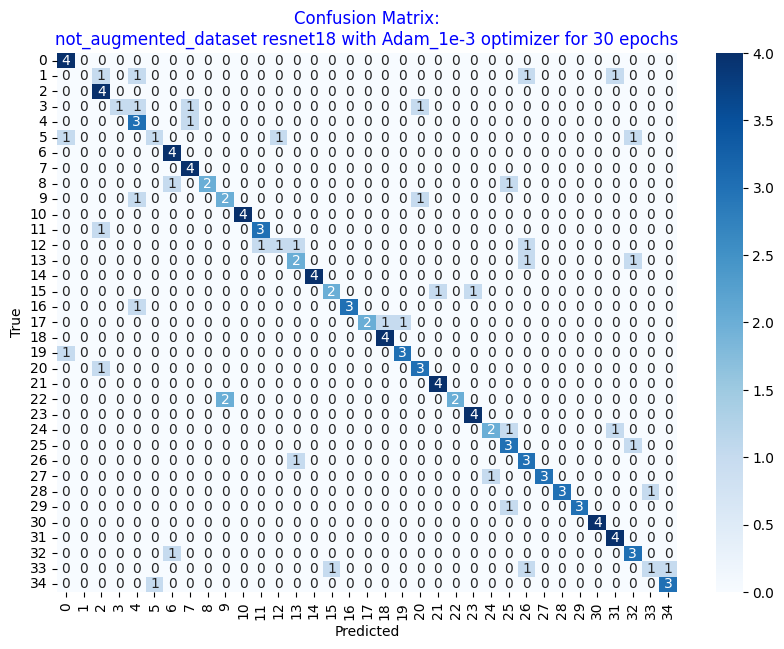


Class index to label mapping:
0: Abyssinian
1: American Bulldog
2: American Pit Bull Terrier
3: Basset Hound
4: Beagle
5: Bengal
6: Bombay
7: Boxer
8: British Shorthair
9: Chihuahua
10: Egyptian Mau
11: English Cocker Spaniel
12: English Setter
13: German Shorthaired
14: Great Pyrenees
15: Havanese
16: Japanese Chin
17: Keeshond
18: Leonberger
19: Maine Coon
20: Miniature Pinscher
21: Newfoundland
22: Pomeranian
23: Pug
24: Ragdoll
25: Russian Blue
26: Saint Bernard
27: Samoyed
28: Scottish Terrier
29: Shiba Inu
30: Siamese
31: Sphynx
32: Staffordshire Bull Terrier
33: Wheaten Terrier
34: Yorkshire Terrier
--------------------------------------------------
Visualizzazione degli errori commessi dal modello sul test set:
- Verranno mostrati esempi di immagini mal classificate,
  insieme alla loro classe predetta e alla classe reale.


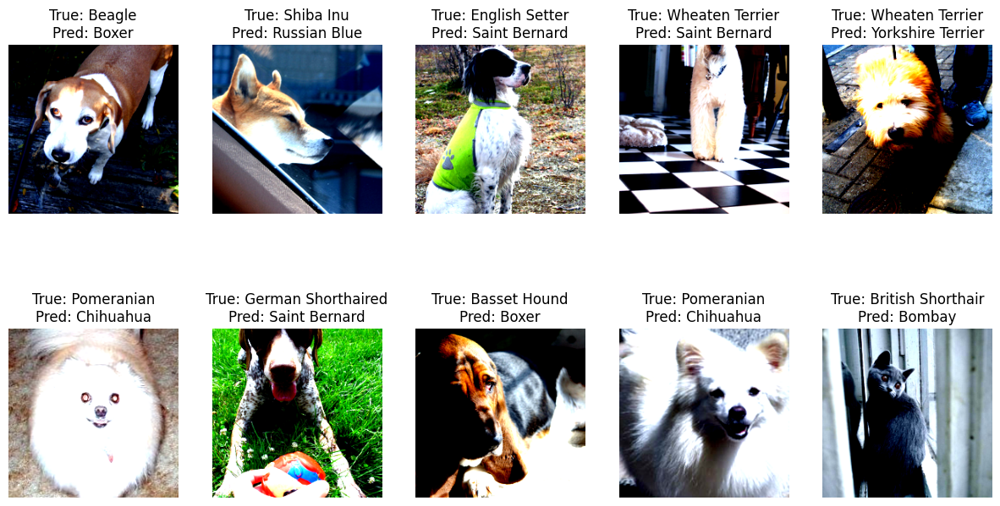

----------------------------------------------------------------------------------------------------


 Grafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni
----------------------------------------------------------------------------------------------------


/tmp/ipython-input-2624478965.py:164: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


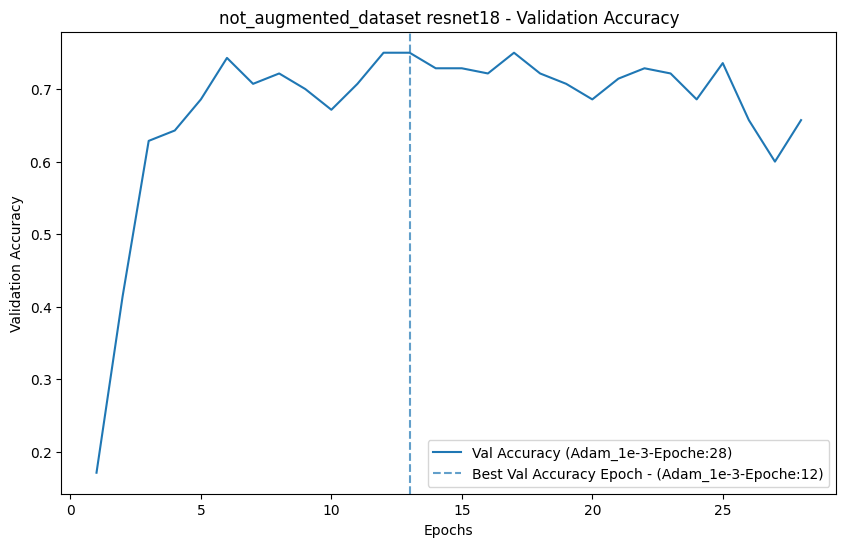

/tmp/ipython-input-2624478965.py:185: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


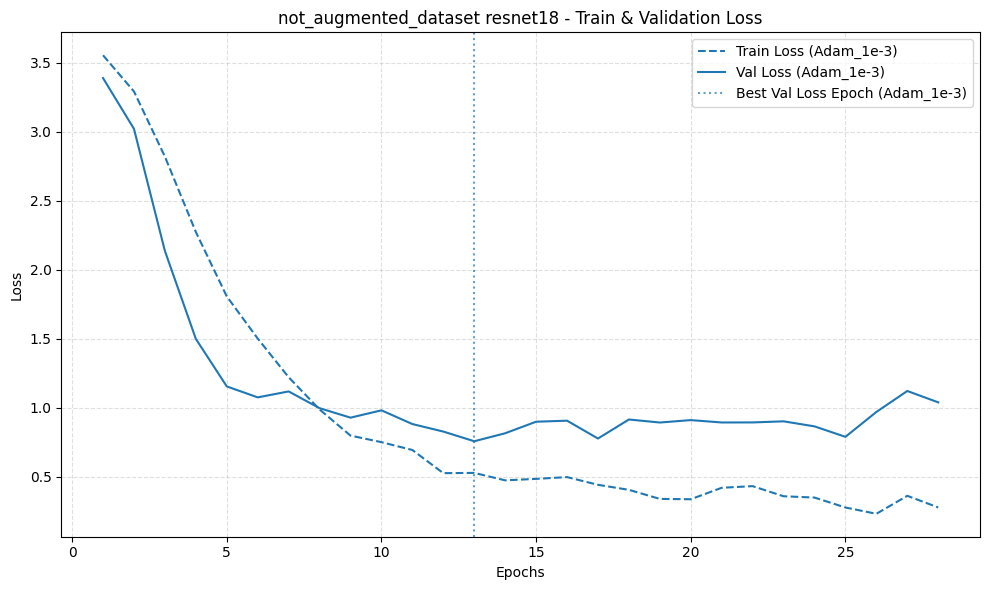

/tmp/ipython-input-2624478965.py:208: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


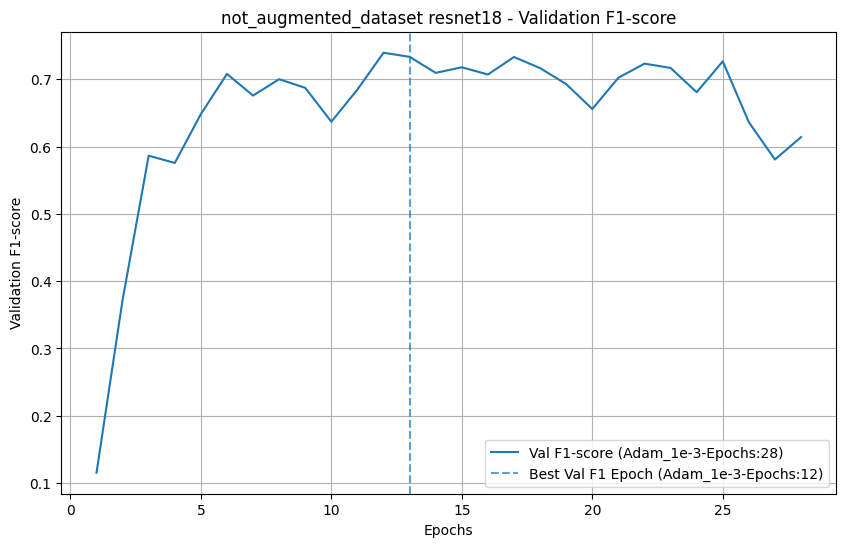

In [ ]:

# Comparatore dei modelli (plot loss e accuracy, f1 score)
comparer = ModelComparator("Experiments Comparison")
# definiamo il device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
early_stopping = EarlyStopping(patience=15, min_delta=0)


training_summaries = []
for image_caption_model,trainloader in zip(augmented_datasets.keys(),trainloaders):
  for model_name,model_fn in models.items():
      training_logger = ExperimentLogger()
      for opt_name, opt_fn in optimizers.items():
          for epochs in epoch_list:
              experiment = f"\033[1;31m \nTraining {image_caption_model} model {model_name} with {opt_name} optimizer for {epochs} epochs\033[0m"
              print(experiment)

              model = model_fn()
              model = model.to(device)


              trainer = Trainer(
                  model=model,
                  name=f"{image_caption_model} {model_name}",
                  criterion=criterion,
                  device=device,
                  train_loader=trainloader,
                  val_loader=valloader,
                  classes=name_classes_updated,
                  logger = training_logger
              )
              trainer.set_early_stopping(early_stopping)





              # Imposta optimizer
              optimizer = opt_fn(model)
              trainer.set_optimizer(optimizer,opt_name)

              # Add model to comparer
              key = comparer.add_model(model_name,image_caption_model, opt_name,epochs)
              # Train
              f1, train_losses, val_losses, val_accuracies,epochs_run, best_epoch = trainer.train(epochs=epochs)
              trainer.final_validation(testloader)



              # add results to comparer
              comparer.results_model(key, f1, train_losses, val_losses, val_accuracies, epochs_run, best_epoch)

              # Stampa info training
              info = trainer.get_last_training_info()
              training_summaries.append({
                      "experiment": experiment,
                      "summary": info
                  })
              àccuracy_plot = trainer.plot_confusion_matrix(testloader,f"{image_caption_model} {model_name}" ,opt_name, epochs)




              print("-"*50)
              print("Visualizzazione degli errori commessi dal modello sul test set:")
              print("- Verranno mostrati esempi di immagini mal classificate,")
              print("  insieme alla loro classe predetta e alla classe reale.")

              # Mostra errori (10 immagini sbagliate)

              trainer.show_errors(test_loader= testloader)




      print("-" * 100)

      print("\n\n \033[1mGrafici di performance relativi ai singoli modelli sui vari ottimizzatori/regolarizzazioni\033[0m")

      print("-" * 100)
      trainer.plot_accuracies()
      trainer.plot_losses()
      trainer.plot_f1_scores()


**ANALISI RISULTATI**


| Modello                                                      | Ottimizz. | Epoche | Val Acc | Val Loss | Train Loss | F1 Score |
|-------------------------------------------------------------|-----------|--------|---------|----------|------------|----------|
| Florence_t5-flan-small_stable-diffusion-v1-5_mobilenet_v2_detail0.6_temp0.4   | Adam_1e-3 | 29     | 0.7143  | 1.5552   | 0.3056     | 0.7135   |
| Florence_t5-flan-small_stable-diffusion-v1-5_resnet18_detail0.6_temp0.4         | Adam_1e-3 | 30     | 0.7786  | 0.7920   | 0.3716     | 0.7753   |
| Florence_t5-flan-small_stable-diffusion-2-base_mobilenet_v2_detail0.4_temp0.5   | Adam_1e-3 | 20     | 0.6786  | 1.4683   | 0.3177     | 0.6605   |
| Florence_t5-flan-small_stable-diffusion-2-base_resnet18_detail0.4_temp0.5       | Adam_1e-3 | 27     | 0.7786  | 0.9444   | 0.3918     | 0.7798   |
| Florence_t5-small_stable-diffusion-2-base_mobilenet_v2_detail0.3_temp0.4        | Adam_1e-3 | 21     | 0.7071  | 1.3209   | 0.4213     | 0.7031   |
| Florence_t5-small_stable-diffusion-2-base_resnet18_detail0.3_temp0.4            | Adam_1e-3 | 30     | 0.6857  | 1.0236   | 0.3789     | 0.6786   |
| Florence_distilbart_stable-diffusion-2-base_mobilenet_v2_detail0.5_temp0.5     | Adam_1e-3 | 19     | 0.6357  | 1.5365   | 0.3609     | 0.6290   |
| Florence_distilbart_stable-diffusion-2-base_resnet18_detail0.5_temp0.5         | Adam_1e-3 | 28     | 0.7286  | 1.0216   | 0.4251     | 0.7192   |
| Not Augmented Dataset_mobilenet_v2                                                     | Adam_1e-3 | 19     | 0.6786  | 1.5176   | 0.2153     | 0.6697   |
| Not Augmented Dataset_resnet18                                                         | Adam_1e-3 | 28     | 0.7000  | 1.0394   | 0.2777     | 0.6792   |


I risultati mostrano chiaramente come la data augmentation generata tramite il processo di caption rephrasing e sintesi di nuove immagini abbia contribuito a migliorare le prestazioni del modello. In particolare, il dataset aumentato da 350 a 490 immagini (circa 14 immagini per classe) ha permesso un miglior bilanciamento e una migliore generalizzazione, con accuracies e f1-score più alti rispetto al dataset originale non aumentato (10 immagini per classe).


**ANALISI ERRORI**

L’analisi degli errori evidenzia come le maggiori difficoltà di classificazione si manifestino principalmente nelle classi più simili tra loro, in particolare tra le diverse razze di gatti. Queste categorie presentano variazioni visive molto sottili, spesso limitate a dettagli come la texture del pelo, le sfumature di colore o le conformazioni del muso, che risultano più ambigue e meno distintive rispetto alle classi canine, dove le differenze morfologiche sono più marcate e facilmente riconoscibili dai modelli.

Tali errori suggeriscono che la variabilità e la qualità delle immagini sintetiche generate per queste classi complesse non siano ancora sufficientemente rappresentative, causando confusione e riducendo la capacità discriminativa del classificatore. Una possibile strategia per mitigare questa problematica consiste nell’integrare esplicitamente il nome della label di classe nel processo di rephrase delle caption usate per la generazione delle immagini sintetiche.

Questa ipotesi si basa sull’idea che fornire un’indicazione semantica chiara e diretta al modello di sintesi possa migliorare la coerenza e la specificità delle immagini generate, rendendole maggiormente rappresentative delle caratteristiche distintive di ogni classe. In tal modo, si potrebbe aumentare la qualità del dataset sintetico, ridurre l’ambiguità tra classi affini e, di conseguenza, migliorare le performance complessive del modello di classificazione.

Implementare questa modifica potrebbe rappresentare un passo importante verso un data augmentation più mirato, in particolare per dataset caratterizzati da classi visivamente molto simili e difficili da discriminare.

**CONCLUSIONE**

Tra le diverse configurazioni sperimentate, la combinazione ottimale in termini di bilanciamento tra accuratezza e capacità di generalizzazione è rappresentata dal modello Florence_t5-flan-small_stable-diffusion-v1-5 abbinato a ResNet18, con parametri di dettaglio (detail) impostati a 0.6 e temperatura (temp) a 0.4. Tale configurazione sfrutta in modo efficace la pipeline di data augmentation basata sul rephrasing delle didascalie e sulla generazione di immagini sintetiche validate, ottenendo un miglioramento significativo delle performance rispetto al dataset originale non aumentato.

La metodologia adottata per la generazione e validazione delle immagini sintetiche si è dimostrata efficace nel potenziare la capacità del modello di riconoscere classi caratterizzate da un numero limitato di campioni, contribuendo a un bilanciamento più uniforme del dataset e ad un incremento delle immagini disponibili per ciascuna classe.

Per perseguire ulteriori miglioramenti, è possibile procedere in diverse direzioni:

- Sperimentare strategie di rephrasing più articolate e dettagliate delle didascalie, al fine di aumentare la varietà e la qualità delle immagini sintetiche generate.

- Applicare tecniche di data augmentation specifiche e mirate alle classi più ambigue, come le differenti razze di gatti, che presentano caratteristiche visive particolarmente sfumate.

- Valutare l’adozione di modelli di classificazione più complessi o di approcci ensemble, per incrementare la robustezza e la generalizzabilità del sistema.

- Raffinare il validatore impiegato per la selezione delle immagini sintetiche, con l’obiettivo di migliorare la qualità complessiva del dataset aumentato.

In conclusione, la pipeline di data augmentation basata su caption rephrasing e sintesi di immagini mediante modelli diffusion rappresenta un approccio promettente per migliorare l’accuratezza su dataset con poche immagini per classe e alta complessità visiva, come nel caso di Oxford Pets Ridotto.



In [ ]:

print("\n\n\033[1mRiepilogo Esperimenti:\033[0m")
for summary in training_summaries:
    print(summary["experiment"])
    print("="*50)
    print(f"Optimizer:           {summary['summary'].get('optimizer', 'N/A')}")
    print(f"Criterion:           {summary['summary'].get('criterion', 'N/A')}")
    print(f"Epochs Run:          {summary['summary'].get('epochs_run', 'N/A')}")
    print(f"best_epoch_early_stopping: {summary['summary'].get('best_epoch_early_stopping', 'N/A')}")
    print("-"*50)
    print(f"Final Training Loss: {summary['summary']['train_losses'][-1]:.4f}")
    print(f"Final Validation Loss: {summary['summary']['val_losses'][-1]:.4f}")
    print(f"Final Validation Accuracy: {summary['summary']['final_accuracy']:.4f}")
    print(f"Final f1 Score : {summary['summary']['final_f1']:.4f}")
    print("="*50)






Riepilogo Esperimenti:
 
Training Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
Optimizer:           Adam_1e-3
Criterion:           CrossEntropyLoss
Epochs Run:          29
best_epoch_early_stopping: 13
--------------------------------------------------
Final Training Loss: 0.3056
Final Validation Loss: 1.5552
Final Validation Accuracy: 0.7143
Final f1 Score : 0.7135
 
Training Florence_t5-flan-small_stable-diffusion-v1-5_detail0.6_temp0.4 model resnet18 with Adam_1e-3 optimizer for 30 epochs
Optimizer:           Adam_1e-3
Criterion:           CrossEntropyLoss
Epochs Run:          30
best_epoch_early_stopping: 14
--------------------------------------------------
Final Training Loss: 0.3716
Final Validation Loss: 0.7920
Final Validation Accuracy: 0.7786
Final f1 Score : 0.7753
 
Training Florence_t5-flan-small_stable-diffusion-2-base_detail0.4_temp0.5 model mobilenet_v2 with Adam_1e-3 optimizer for 30 epochs
O

**PERFORMANCE**

L’analisi complessiva delle performance mostra come i modelli addestrati su dataset aumentati tramite la pipeline di data augmentation basata su caption rephrasing e sintesi di immagini abbiano generalmente superato quelli addestrati sul dataset originale non aumentato. In particolare, il modello Florence_t5-flan-small_stable-diffusion-v1-5 con architettura ResNet18 (detail 0.6, temperature 0.4) ha raggiunto i risultati più convincenti, con un’accuratezza di validazione superiore e un bilanciamento ottimale tra training loss, validation loss e F1 score. Questo evidenzia come l’incremento della varietà e qualità delle immagini sintetiche, validate tramite un modello dedicato, migliori significativamente la capacità del classificatore di generalizzare anche su classi con dati limitati.

Al contrario, il dataset non aumentato, pur essendo più “pulito” e con meno immagini (circa 350 rispetto alle 490 del dataset aumentato), si è rivelato spesso il meno performante. Questo conferma l’importanza di disporre di un numero sufficiente di campioni per ogni classe, specialmente in contesti complessi come Oxford Pets, dove le classi ( come nel caso dei gatti ) presentano notevoli similarità tra loro. La minore varietà di immagini del dataset originale ha infatti limitato la capacità dei modelli di catturare le sottili differenze tra le razze, riflettendosi in valori inferiori di accuratezza e F1 score.

L’analisi delle diverse architetture ha mostrato che, a parità di dataset, i modelli ResNet18 tendono a performare meglio rispetto a MobileNetV2, probabilmente grazie alla loro maggiore capacità espressiva e profondità. Tra i modelli di caption rephrasing testati, il modello flan-small ha prodotto le descrizioni più efficaci, generando immagini sintetiche di qualità superiore rispetto a distilbart e small_stable_diffusion. Per quanto riguarda la generazione delle immagini, la versione stable-diffusion-v1-5 ha mostrato performance migliori in termini di accuratezza e F1 score rispetto alla versione più recente diffusion-2-base, probabilmente per una maggiore coerenza e fedeltà nella rappresentazione delle classi durante la sintesi.

Nel complesso, configurazioni con parametri di dettaglio più elevati (detail 0.6) e temperature moderate (0.4-0.5) hanno garantito un equilibrio ottimale tra varietà e qualità delle immagini sintetiche, risultando in un miglioramento complessivo delle performance.

/tmp/ipython-input-3478126844.py:145: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10')


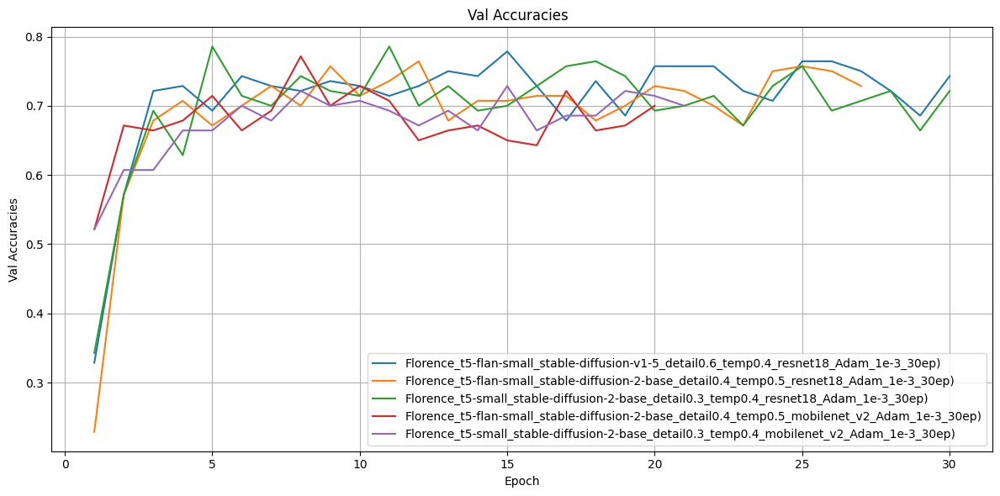

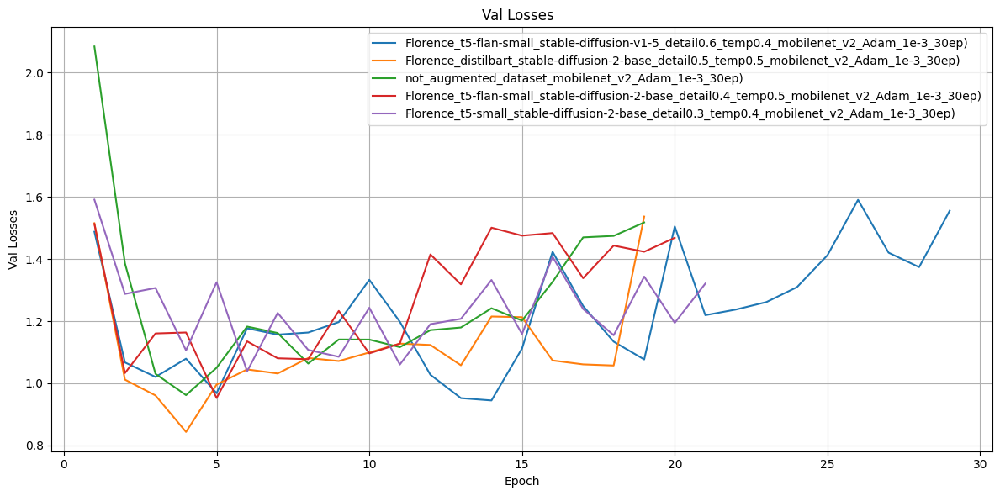

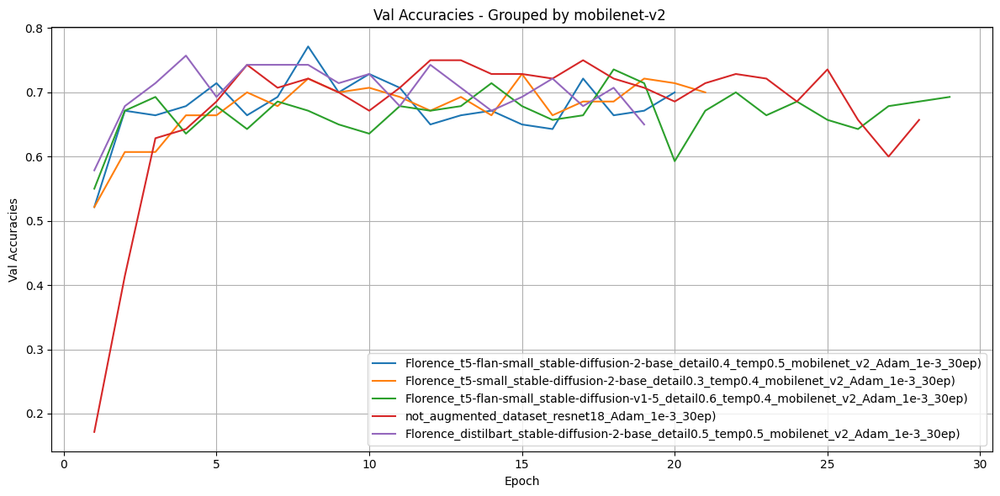

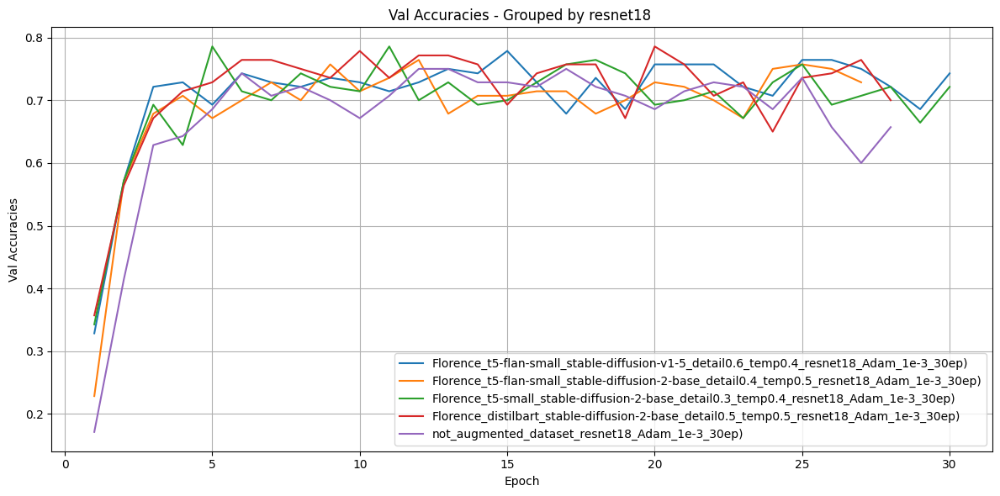

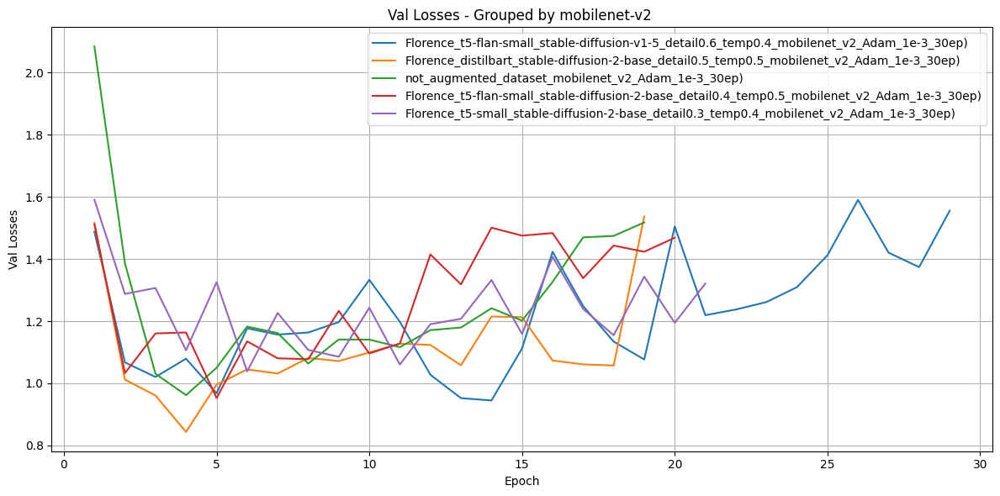

...

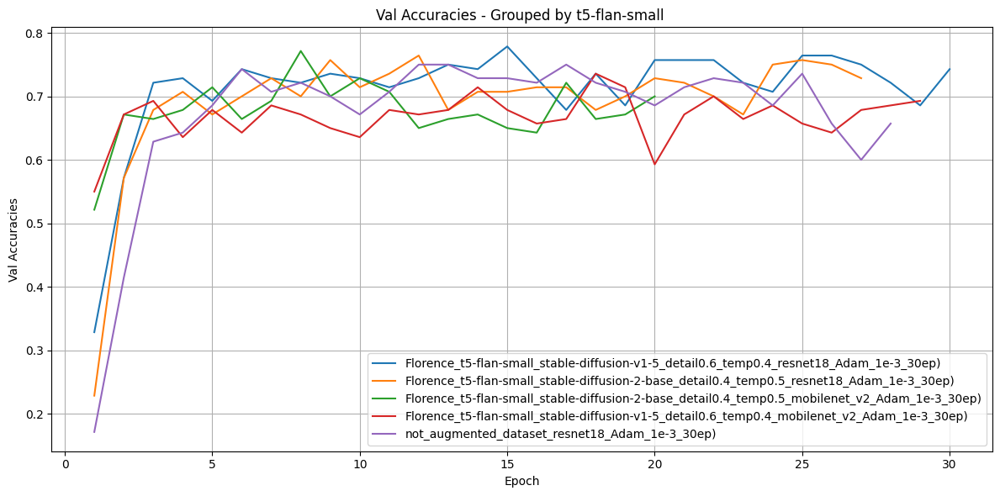

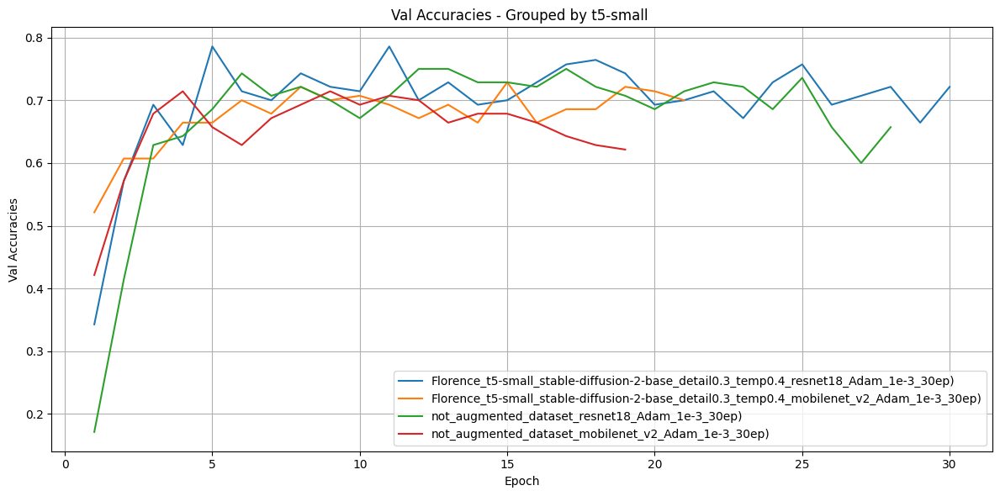

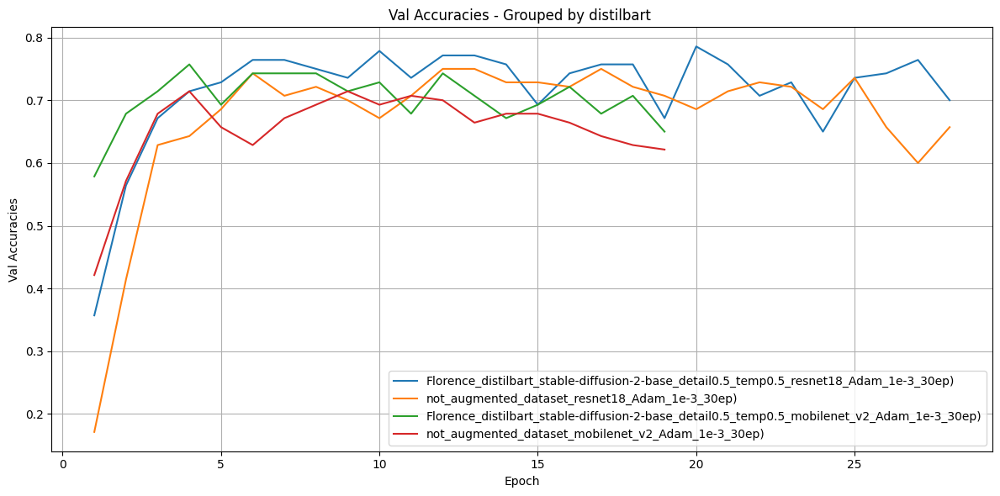

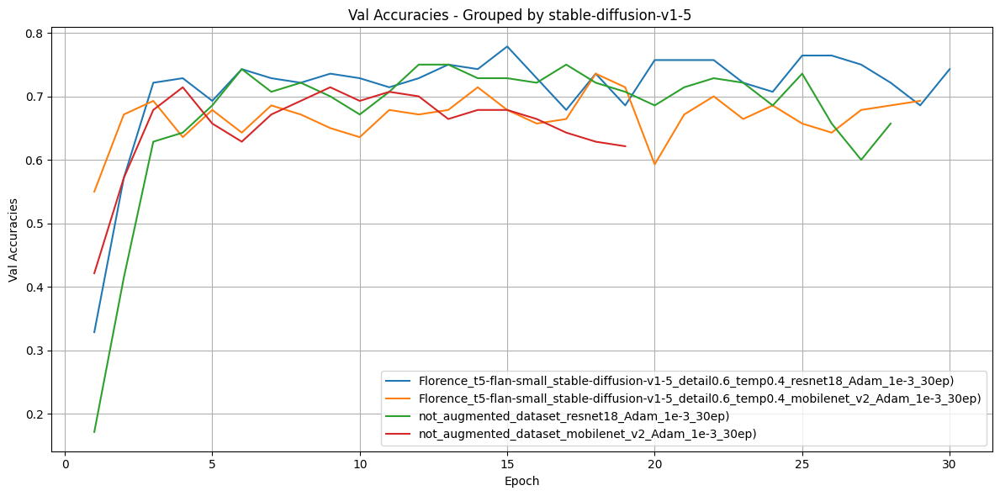

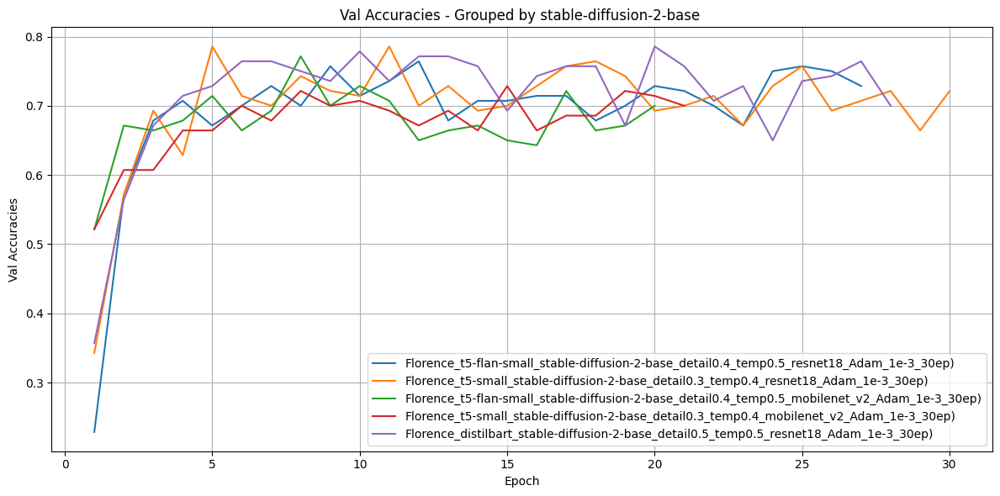

In [ ]:


comparer.plot_metrics('val_accuracies', [], top_n = 5)
comparer.plot_metrics('val_losses', [], top_n = 5)
comparer.plot_metrics('val_accuracies', ['model_name'],top_n = 5)
comparer.plot_metrics('val_losses', ['model_name'],top_n = 5)
comparer.plot_metrics('val_accuracies', ['cap_name'],top_n = 5)
comparer.plot_metrics('val_accuracies', [ 'cti_name'],top_n = 5)

